In [1]:
%matplotlib inline
import torch
from torch import nn
from torch.autograd import Variable
import torch.nn.functional as F
from torch.nn import Sigmoid
import torch.optim as optim
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from scipy.signal import gaussian


def normalize_signal(signal):
    signal = signal - np.mean(signal)
    return signal / np.max(np.abs(signal))

def read_dataset(filename):
    return pd.read_csv(filename, header = None)


def check_labels(labs):
    pos = -1
    for i, elem in enumerate(labs):
        if elem == 1:
            pos = i
    if abs(pos - len(labs)/2) <25:
        return 1
    else:
        return 0


def build_labels(inputs1, inputs2, labels):
    kernel = gaussian(21, 11)
    inputs1 = normalize_signal(inputs1)
    inputs2 = normalize_signal(inputs2)
    res = np.convolve(labels, kernel, 'same')
    return res[10:-10], inputs1[10:-10], inputs2[10:-10]



def build_batch(inputs1, inputs2, labels):
    n = 100
    step = 5
    data = []
    lab = []
    i = 100
    while i < len(inputs1)-n:
        data.append([np.asarray(inputs1[i:i+n]).astype(np.double), np.asarray(inputs2[i:i+n]).astype(np.double)])
        # data.append(np.asarray(inputs1[i:i+n]).astype(np.double))
        l = check_labels(labels[i:i+n])
        lab.append(l)
        # if l == 0:
        #     plt.plot(range(n), inputs1[i:i+n])
        #     plt.plot(range(n), inputs2[i:i+n])
        #     plt.show()
        i += step
    ones = np.sum(lab)
    final_data = []
    final_lab = []
    for i, elem in enumerate(data):
        # print(lab[i])
        if lab[i] == 0 and ones > 0:
            final_data.append(elem)
            final_lab.append(0)
            ones -= 1
        if lab[i] == 1:
            final_data.append(elem)
            final_lab.append(1)
    return final_data, final_lab

In [2]:
class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, n_layers=1):
        super(RNN, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.output_size = output_size
        self.n_layers = n_layers

        self.gru1 = nn.GRU(input_size, 1, batch_first=True)
        # self.gru2 = nn.GRU(15, 1, batch_first=True)
        # self.gru3 = nn.GRU(5, 1, batch_first=True)
        self.lstm = nn.LSTM(input_size, 1, batch_first=True)
        self.linear = nn.Linear(1, output_size, )


    def forward(self, inputs, hidden1, hidden2, hidden3):
        batch_size = inputs.size(0)
        sigm = Sigmoid()
        
        inputs = inputs.transpose(1,2).transpose(0,1)
        c, hidden1 = self.lstm(inputs, None)
        # c = c.transpose(0,1).transpose(1,2)
        # p = F.relu(c)
        # p = c
        
        # p = p.transpose(1,2).transpose(0,1)
        # c, hidden2 = self.gru2(p, hidden2)
        # c = c.transpose(0,1).transpose(1,2)
        # p = F.relu(c)
        # p = c
        
        # p = p.transpose(1,2).transpose(0,1)
        # c, hidden3 = self.gru3(p, hidden3)
        # c = c.transpose(0,1).transpose(1,2)
        # p = sigm(c)
        
        # p = p.transpose(1,2).transpose(0,1)
        # c = self.linear(p)
        c = c.transpose(0,1).transpose(1,2)
        # p = torch.tanh(c)
        p = F.relu(c)
        # p = sigm(c)
        # p = c
        
        return p, hidden1, hidden2, hidden3
    
    def init_hidden(self, batch_size):
        # This method generates the first hidden state of zeros which we'll use in the forward pass
        # We'll send the tensor holding the hidden state to the device we specified earlier as well
        hidden = torch.zeros(self.n_layers, batch_size, self.hidden_size)
        return hidden



input_size = 2
hidden_size = 5
output_size = 1
batch_size = 10
n_layers = 2
seq_len = 1

rnn = RNN(input_size, hidden_size, output_size, n_layers=n_layers)
criterion = nn.MSELoss()
optimizer = optim.SGD(rnn.parameters(), lr=0.1, momentum=0.9)

# hidden1 = rnn.init_hidden(batch_size)
hidden1 = torch.zeros(1, 710, 1)
hidden2 = torch.zeros(1, 710, 1)
hidden3 = torch.zeros(1, 710, 1)

DATASET LOADED
[1,    31] loss: 0.001


C:\Conda\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


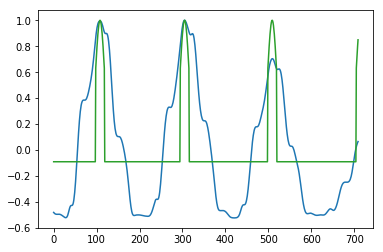

[1,    61] loss: 0.002


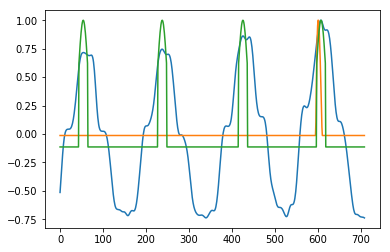

[1,    91] loss: 0.003


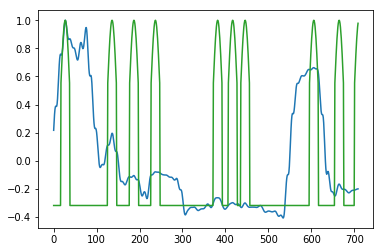

[1,   121] loss: 0.004


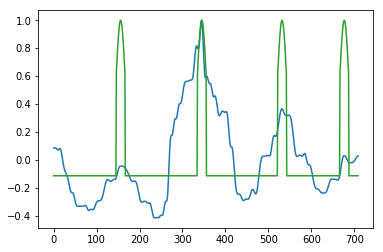

[1,   151] loss: 0.006


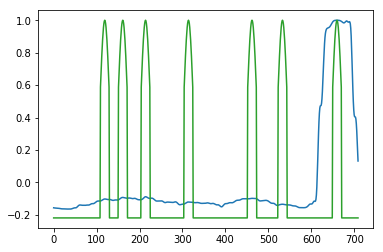

[1,   181] loss: 0.007


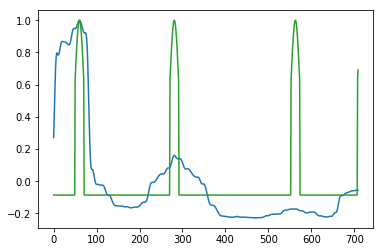

[1,   211] loss: 0.008


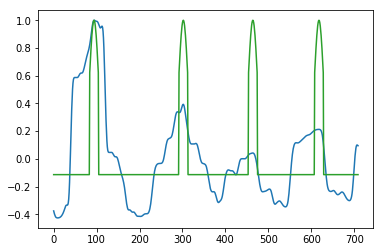

[1,   241] loss: 0.009


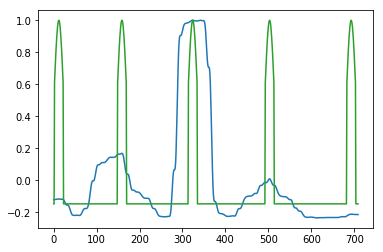

[1,   271] loss: 0.010


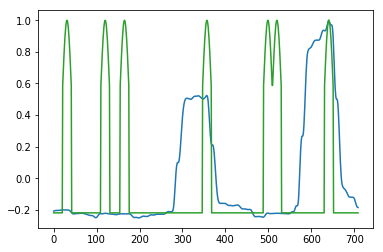

[1,   301] loss: 0.011


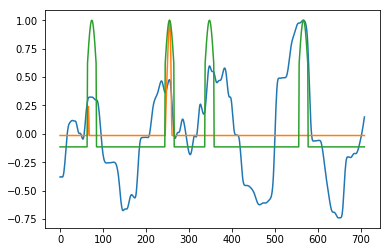

[1,   331] loss: 0.013


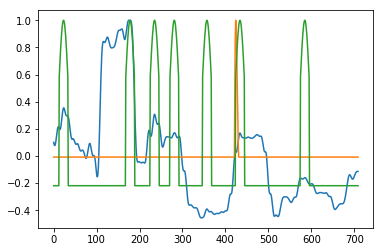

[1,   361] loss: 0.014


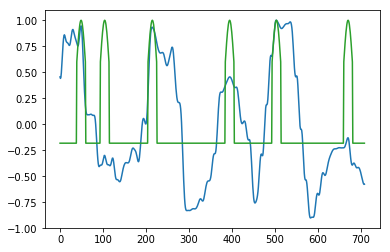

[1,   391] loss: 0.015


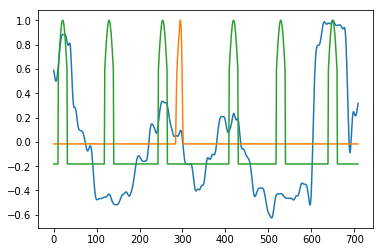

[1,   421] loss: 0.017


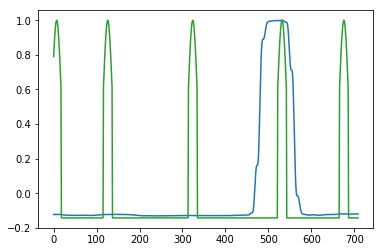

[1,   451] loss: 0.018


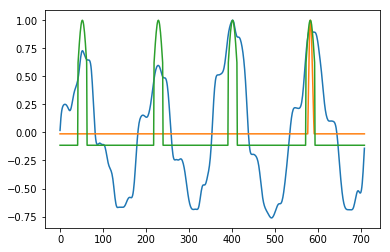

[1,   481] loss: 0.019


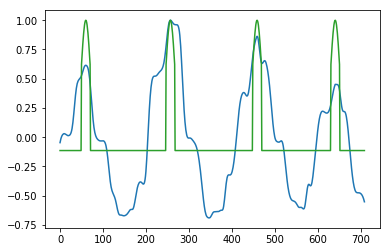

[1,   511] loss: 0.020


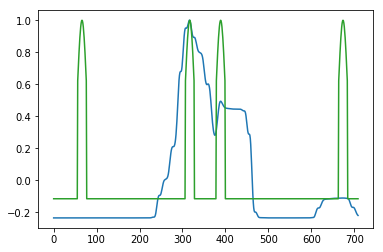

[1,   541] loss: 0.021


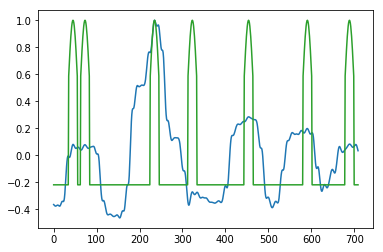

[1,   571] loss: 0.023


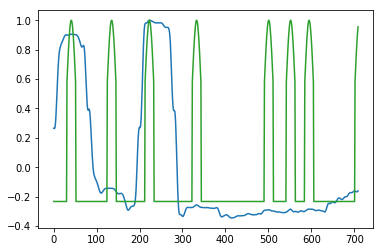

[1,   601] loss: 0.024


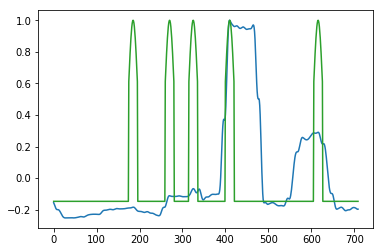

[1,   631] loss: 0.024


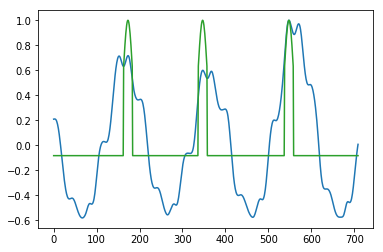

[1,   661] loss: 0.026


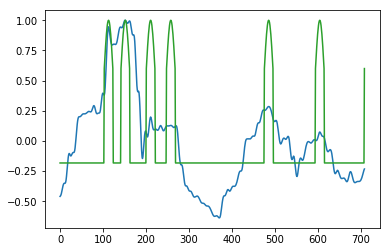

[1,   691] loss: 0.027


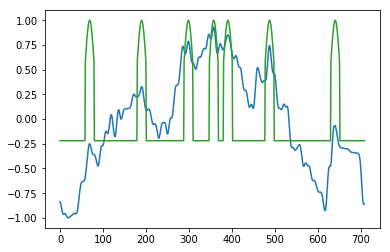

[1,   721] loss: 0.029


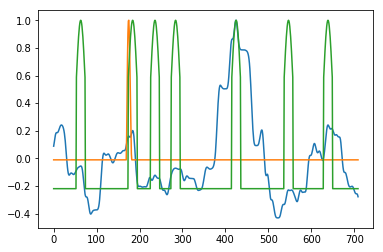

[1,   751] loss: 0.030


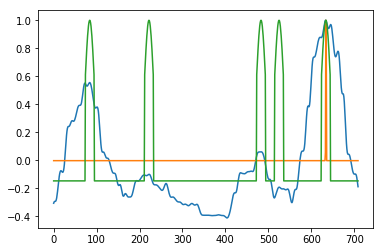

[1,   781] loss: 0.031


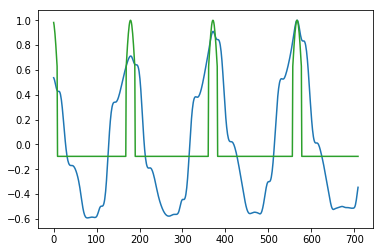

[1,   811] loss: 0.032


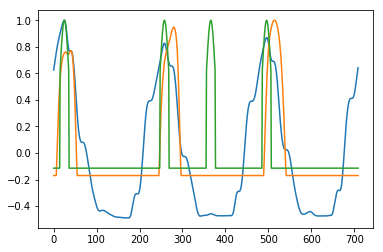

[1,   841] loss: 0.033


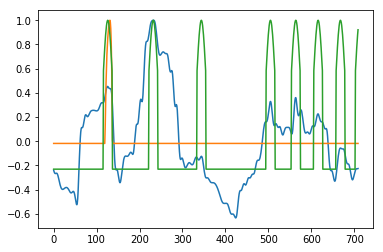

[1,   871] loss: 0.034


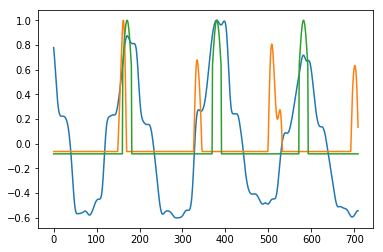

[1,   901] loss: 0.035


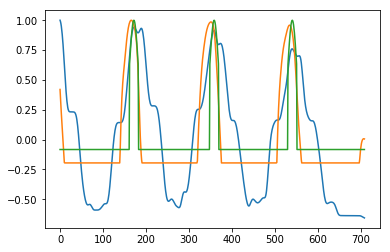

[1,   931] loss: 0.036


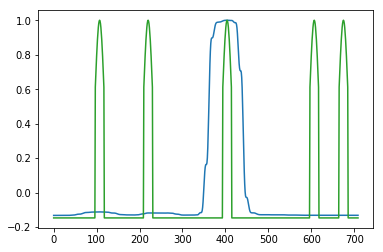

[1,   961] loss: 0.037


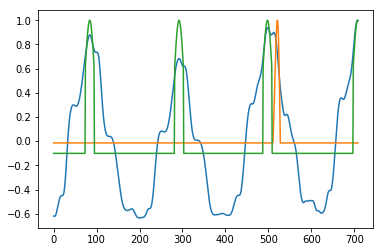

[1,   991] loss: 0.038


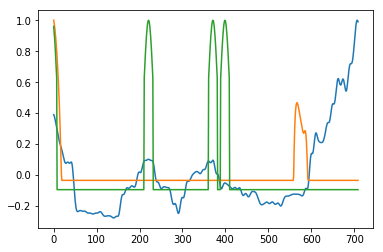

[1,  1021] loss: 0.039


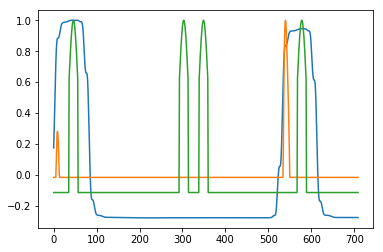

[1,  1051] loss: 0.040


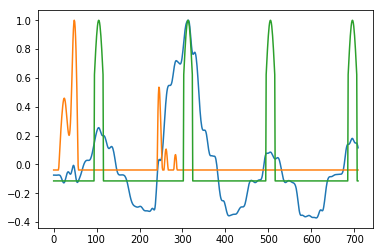

[1,  1081] loss: 0.041


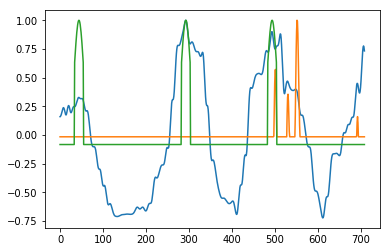

[1,  1111] loss: 0.042


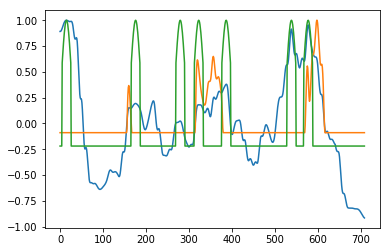

[1,  1141] loss: 0.044


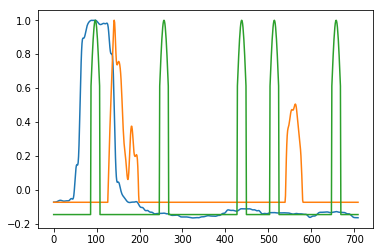

[1,  1171] loss: 0.045


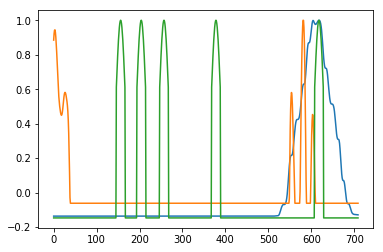

[1,  1201] loss: 0.046


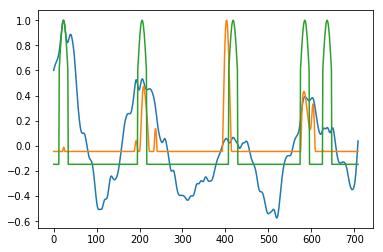

[1,  1231] loss: 0.046


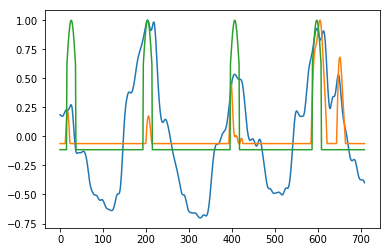

[1,  1261] loss: 0.048


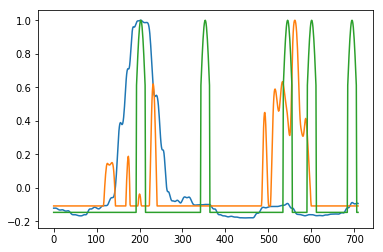

[1,  1291] loss: 0.048


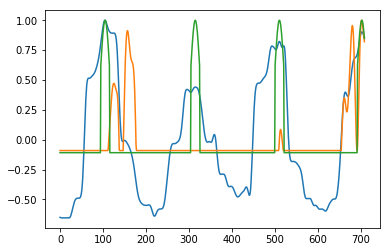

[1,  1321] loss: 0.049


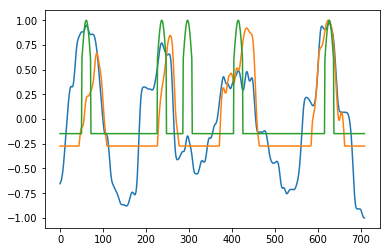

[1,  1351] loss: 0.051


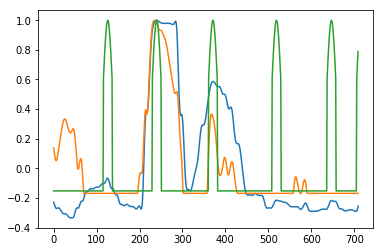

[1,  1381] loss: 0.051


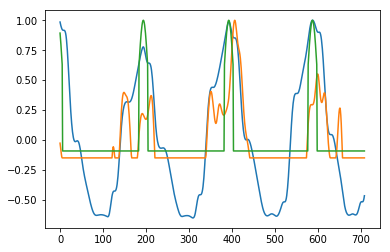

[1,  1411] loss: 0.052


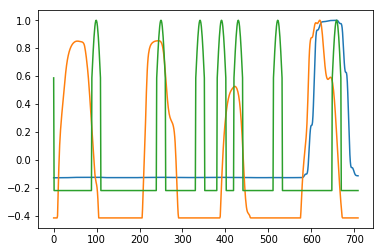

[1,  1441] loss: 0.053


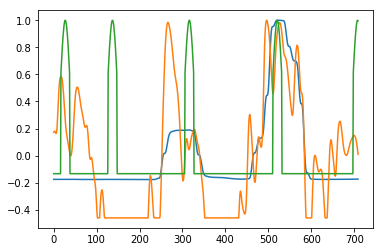

[1,  1471] loss: 0.054


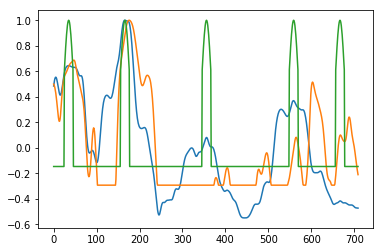

[1,  1501] loss: 0.056


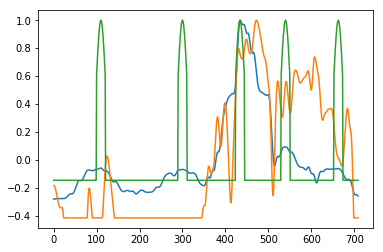

[1,  1531] loss: 0.056


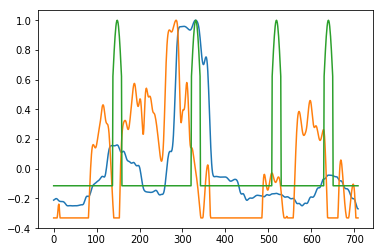

[1,  1561] loss: 0.057


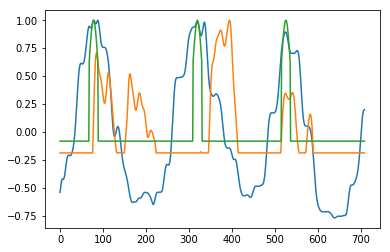

[1,  1591] loss: 0.059


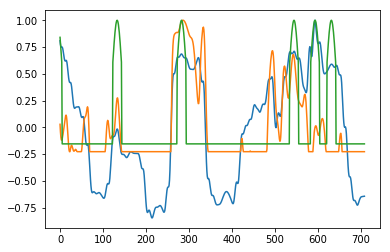

[1,  1621] loss: 0.059


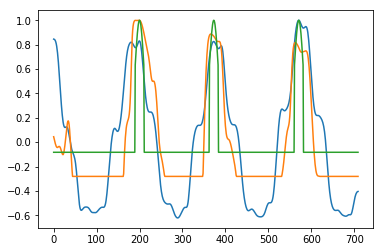

[1,  1651] loss: 0.060


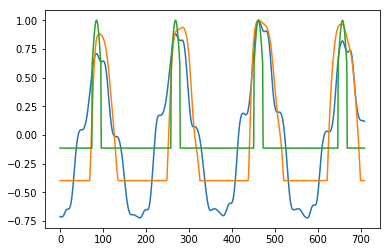

[1,  1681] loss: 0.061


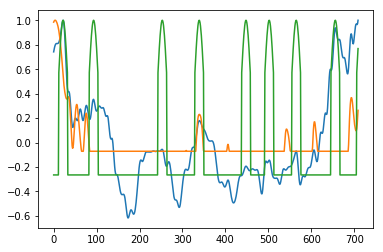

[1,  1711] loss: 0.062


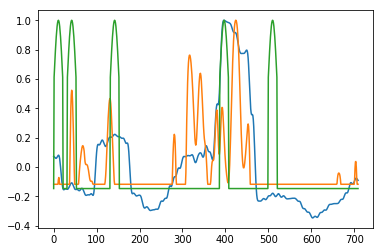

[1,  1741] loss: 0.064


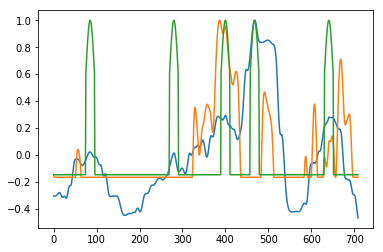

[1,  1771] loss: 0.065


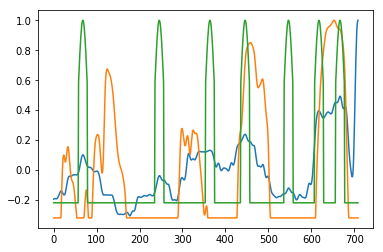

[1,  1801] loss: 0.066


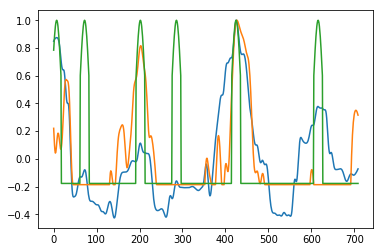

[1,  1831] loss: 0.067


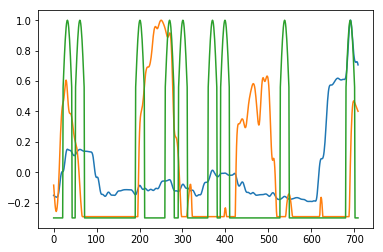

[1,  1861] loss: 0.068


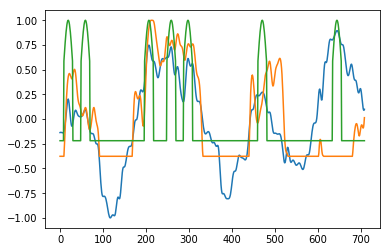

[1,  1891] loss: 0.069


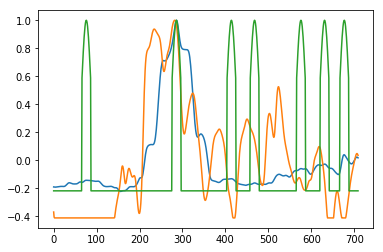

[1,  1921] loss: 0.070


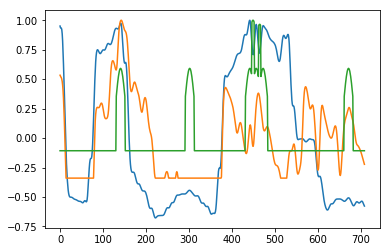

[1,  1951] loss: 0.071


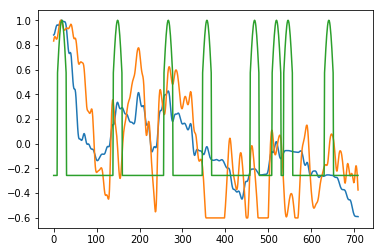

[1,  1981] loss: 0.072


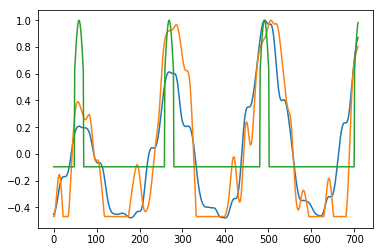

[1,  2011] loss: 0.073


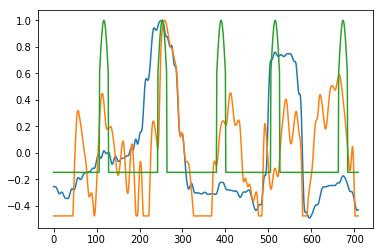

[1,  2041] loss: 0.074


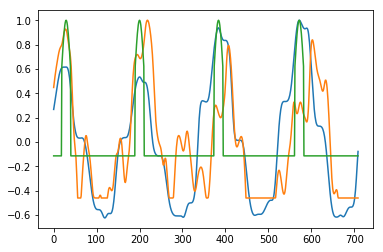

[1,  2071] loss: 0.075


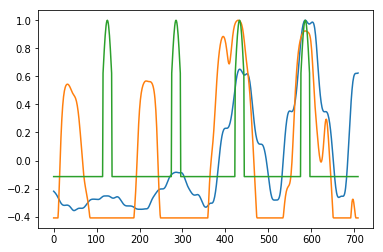

[1,  2101] loss: 0.076


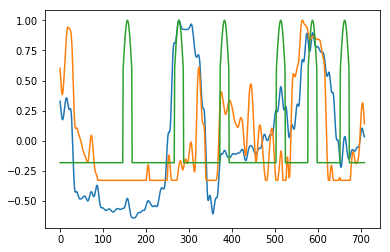

[1,  2131] loss: 0.077


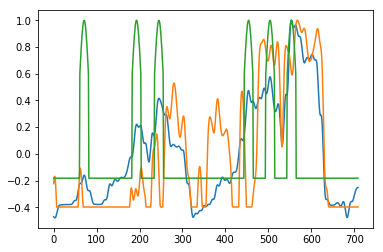

[1,  2161] loss: 0.078


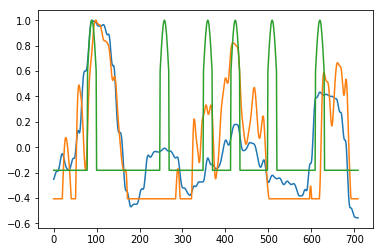

[1,  2191] loss: 0.080


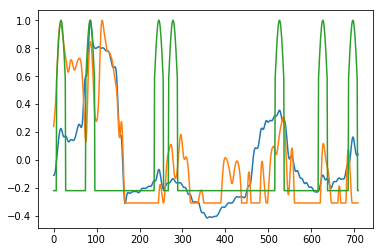

[1,  2221] loss: 0.081


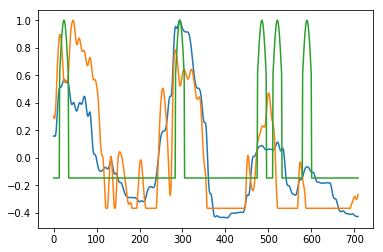

[1,  2251] loss: 0.082


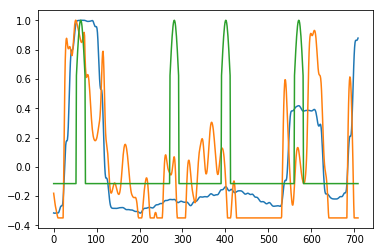

[1,  2281] loss: 0.083


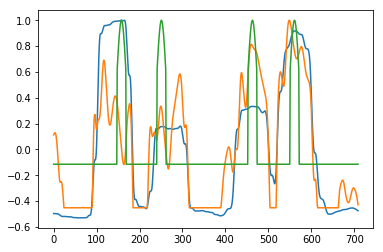

[1,  2311] loss: 0.084


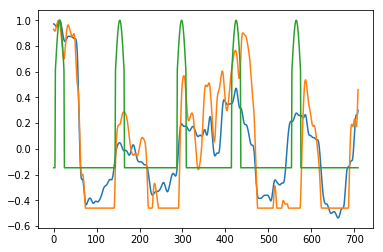

[1,  2341] loss: 0.085


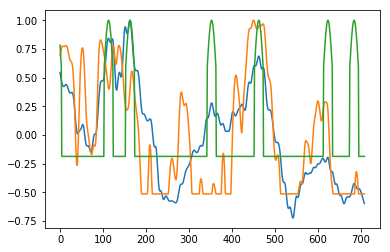

[1,  2371] loss: 0.086


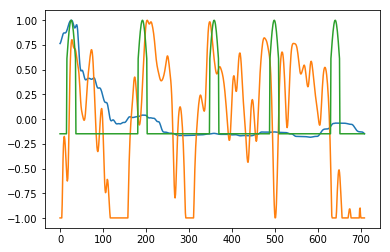

[1,  2401] loss: 0.087


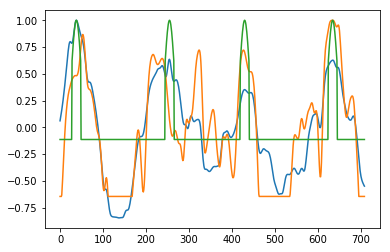

[1,  2431] loss: 0.088


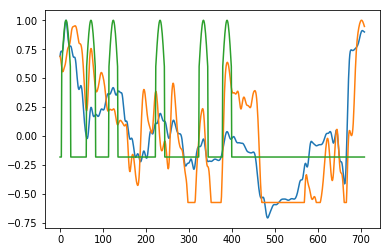

[1,  2461] loss: 0.089


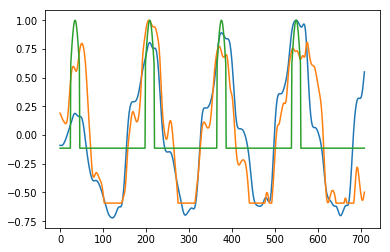

[1,  2491] loss: 0.089


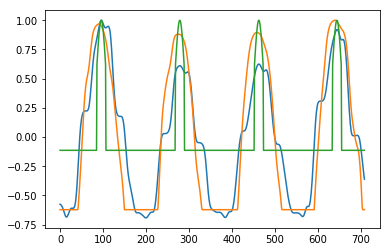

[1,  2521] loss: 0.091


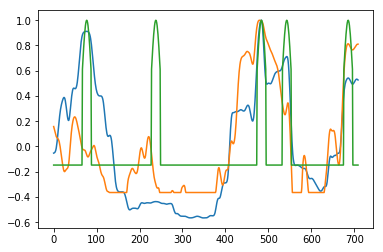

[1,  2551] loss: 0.091


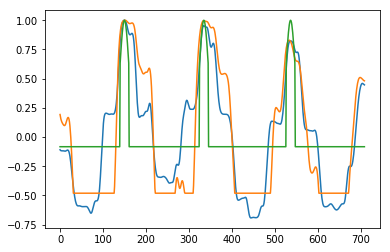

[1,  2581] loss: 0.092


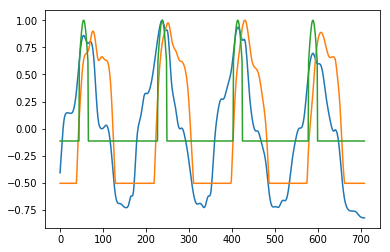

[1,  2611] loss: 0.093


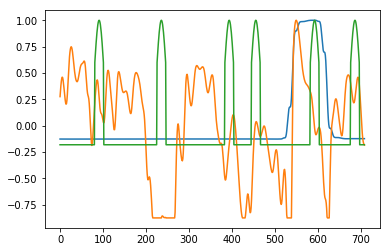

[1,  2641] loss: 0.094


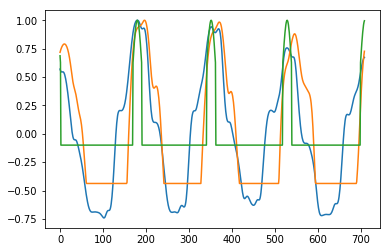

[1,  2671] loss: 0.095


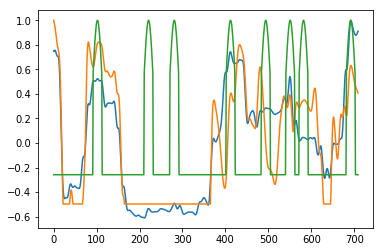

[1,  2701] loss: 0.096


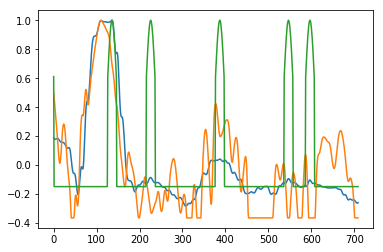

[1,  2731] loss: 0.097


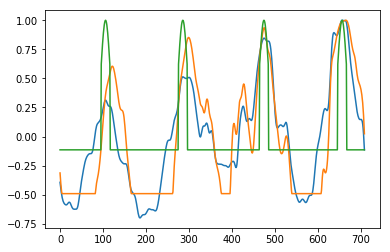

[1,  2761] loss: 0.098


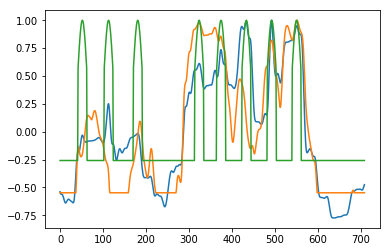

[1,  2791] loss: 0.099


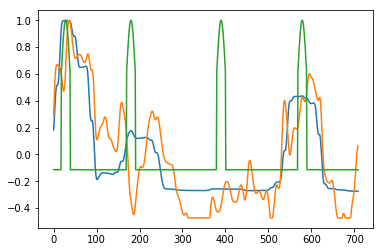

[1,  2821] loss: 0.100


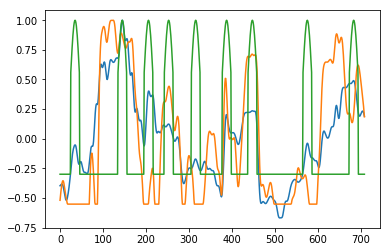

[1,  2851] loss: 0.101


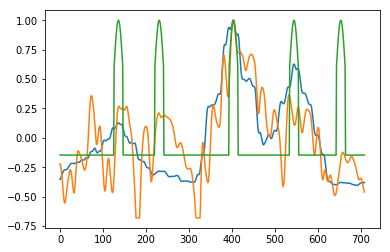

[1,  2881] loss: 0.102


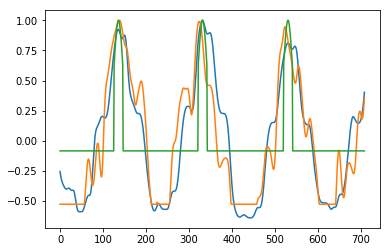

[1,  2911] loss: 0.102


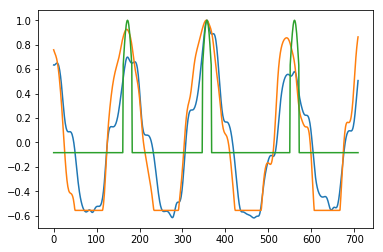

[1,  2941] loss: 0.103


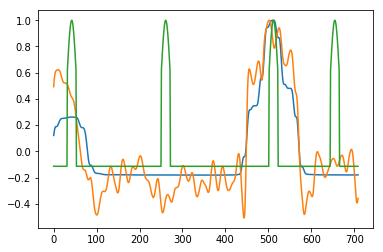

[1,  2971] loss: 0.104


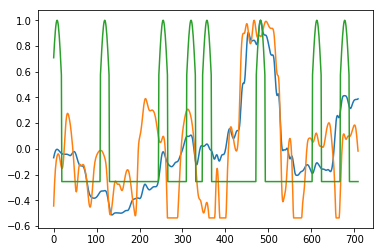

[1,  3001] loss: 0.106


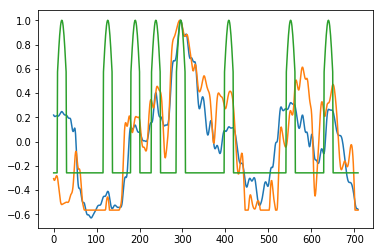

[1,  3031] loss: 0.107


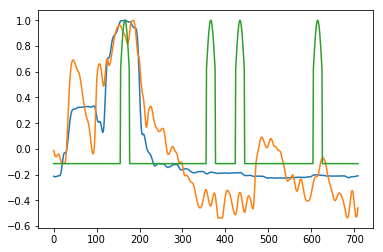

[1,  3061] loss: 0.107


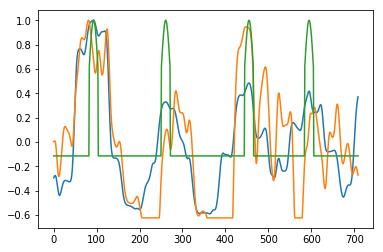

[1,  3091] loss: 0.108


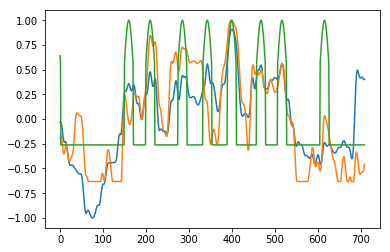

[1,  3121] loss: 0.109


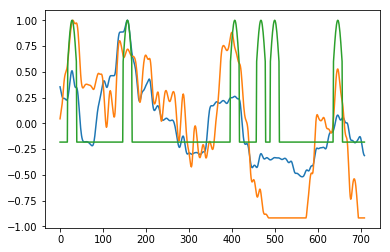

[1,  3151] loss: 0.111


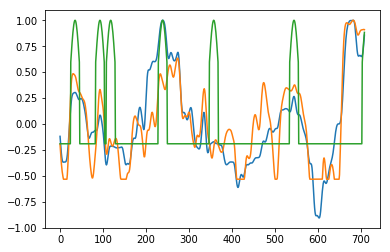

[1,  3181] loss: 0.111


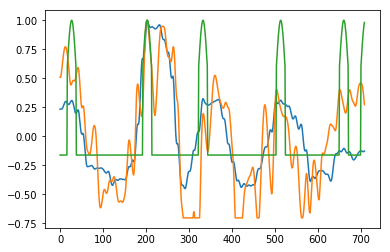

[1,  3211] loss: 0.112


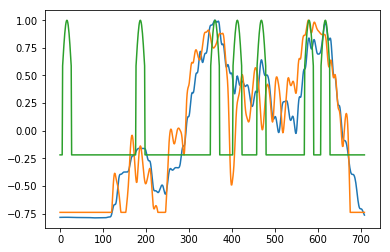

[1,  3241] loss: 0.113


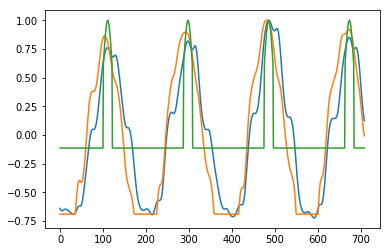

[1,  3271] loss: 0.114


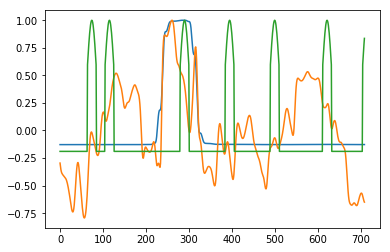

[1,  3301] loss: 0.115


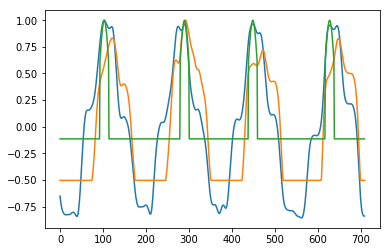

[1,  3331] loss: 0.116


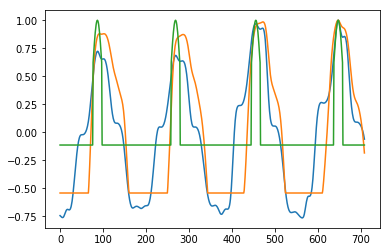

[1,  3361] loss: 0.117


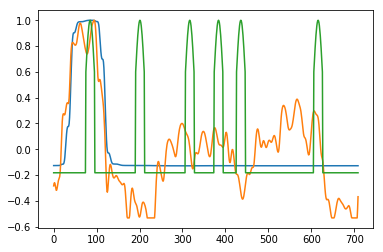

[1,  3391] loss: 0.117


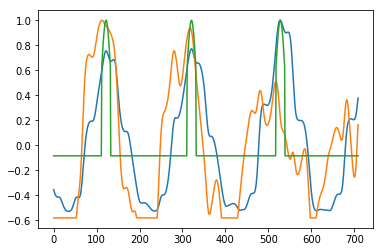

[1,  3421] loss: 0.118


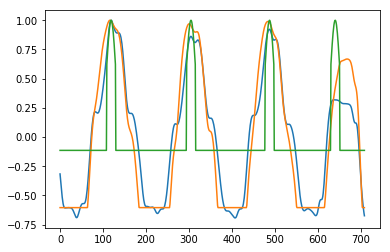

[1,  3451] loss: 0.119


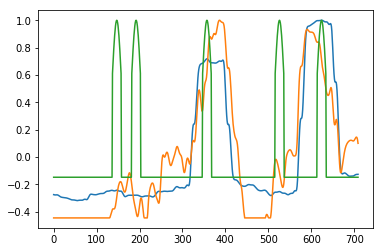

[1,  3481] loss: 0.121


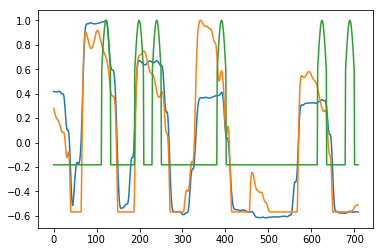

[1,  3511] loss: 0.122


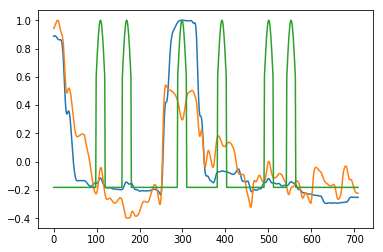

[1,  3541] loss: 0.122


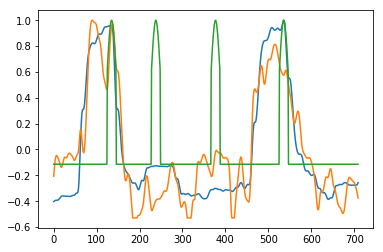

[1,  3571] loss: 0.123


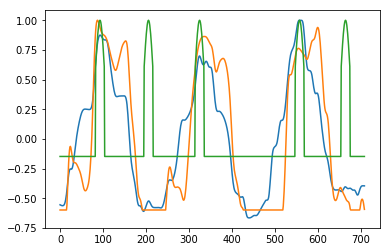

[1,  3601] loss: 0.124


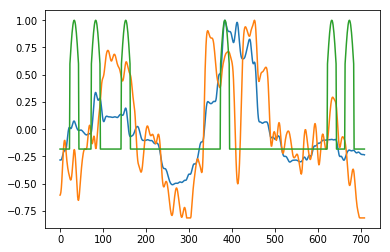

[1,  3631] loss: 0.125


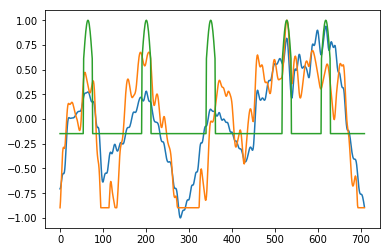

[1,  3661] loss: 0.126


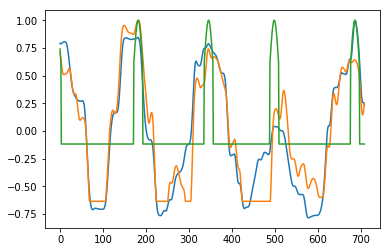

[1,  3691] loss: 0.127


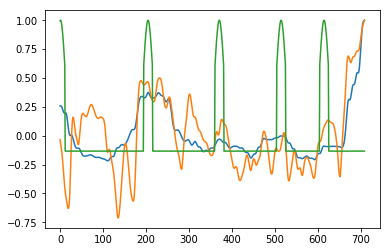

[1,  3721] loss: 0.128


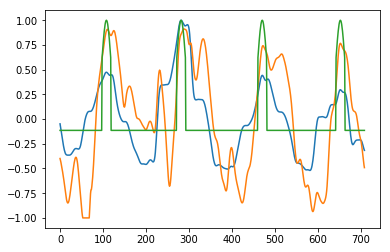

[1,  3751] loss: 0.129


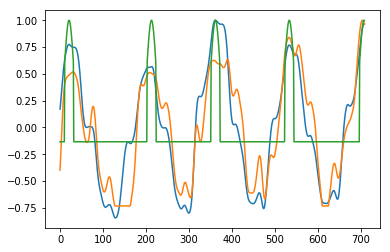

[1,  3781] loss: 0.130


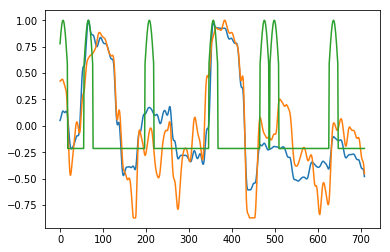

[1,  3811] loss: 0.132


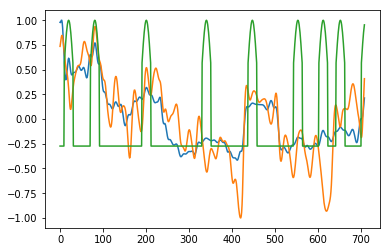

[1,  3841] loss: 0.133


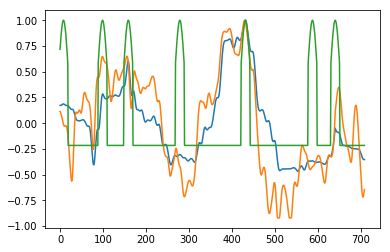

[1,  3871] loss: 0.134


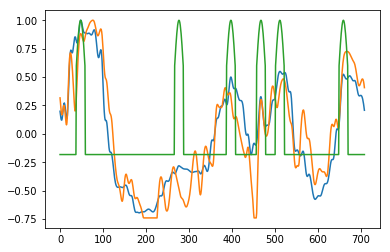

[1,  3901] loss: 0.134


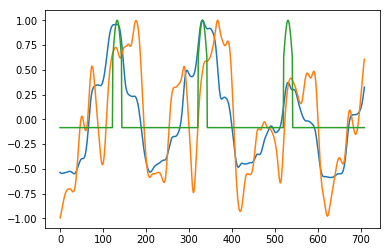

[1,  3931] loss: 0.135


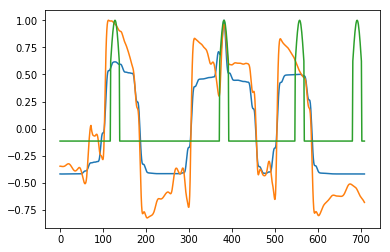

[1,  3961] loss: 0.136


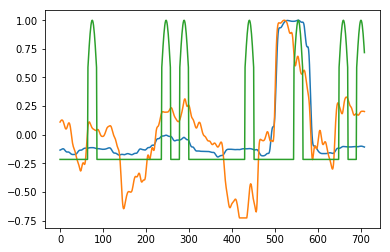

[1,  3991] loss: 0.137


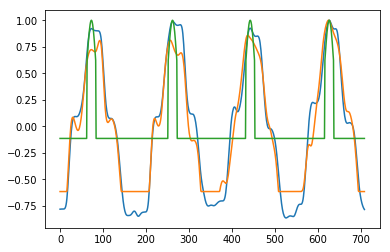

[1,  4021] loss: 0.138


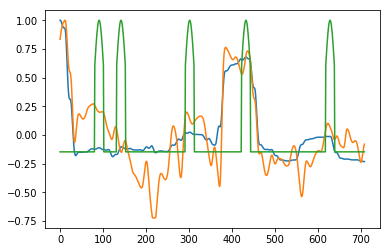

[1,  4051] loss: 0.139


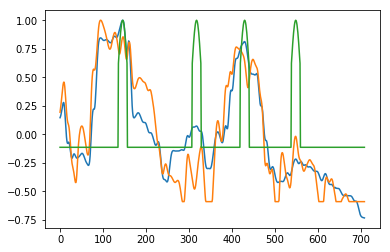

[1,  4081] loss: 0.140


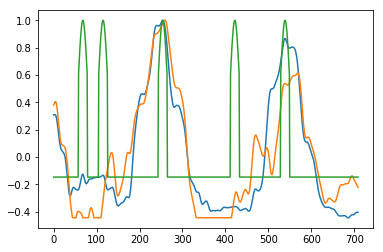

[1,  4111] loss: 0.141


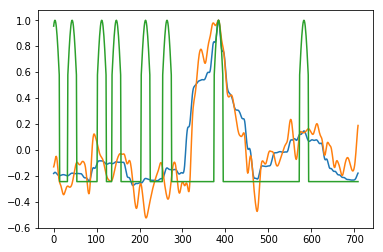

[1,  4141] loss: 0.142


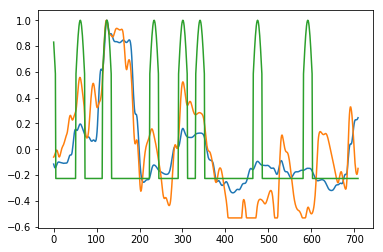

[1,  4171] loss: 0.143


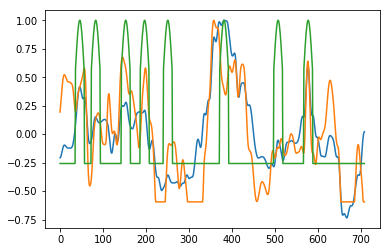

[1,  4201] loss: 0.144


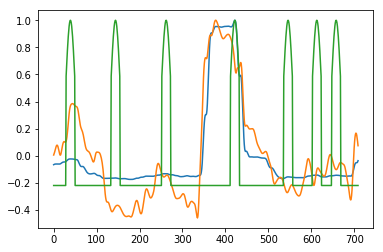

[1,  4231] loss: 0.145


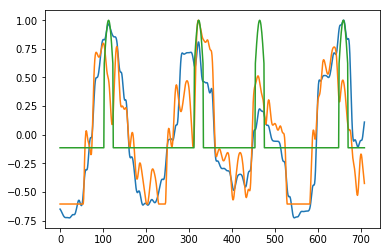

[1,  4261] loss: 0.146


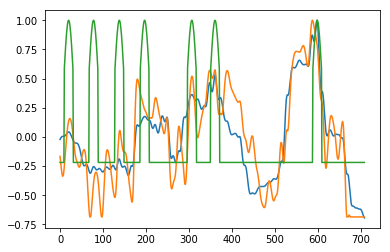

[1,  4291] loss: 0.147


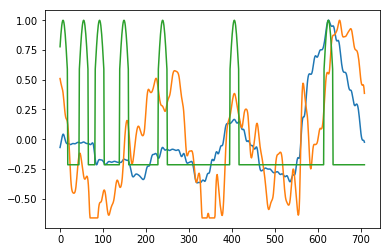

[1,  4321] loss: 0.148


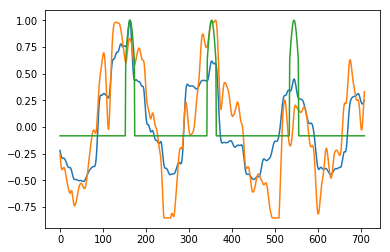

[1,  4351] loss: 0.149


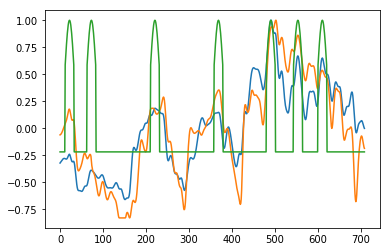

[1,  4381] loss: 0.150


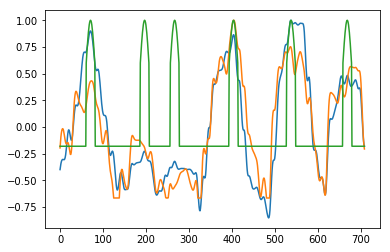

[1,  4411] loss: 0.151


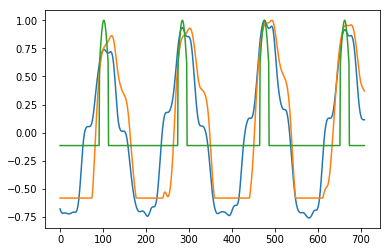

[1,  4441] loss: 0.151


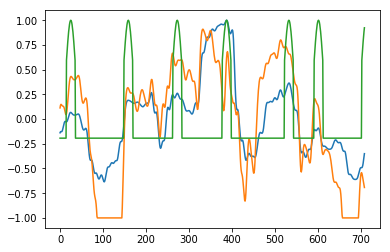

[1,  4471] loss: 0.152


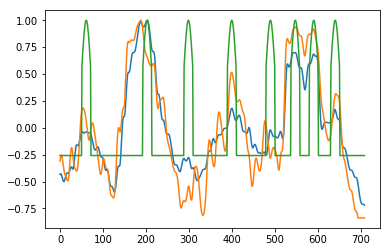

[1,  4501] loss: 0.153


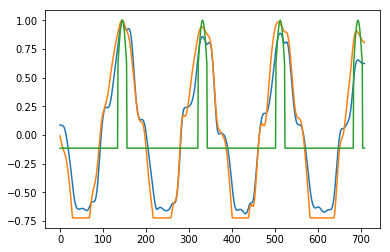

[1,  4531] loss: 0.154


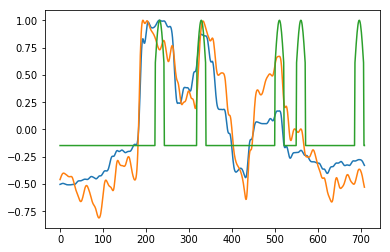

[1,  4561] loss: 0.155


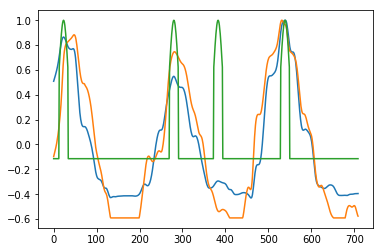

[1,  4591] loss: 0.156


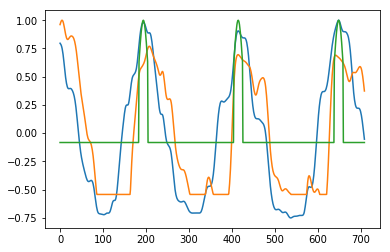

[1,  4621] loss: 0.156


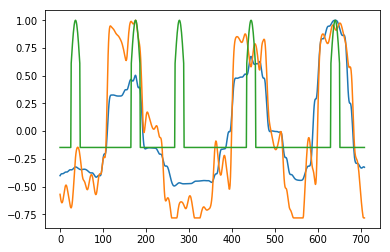

[1,  4651] loss: 0.157


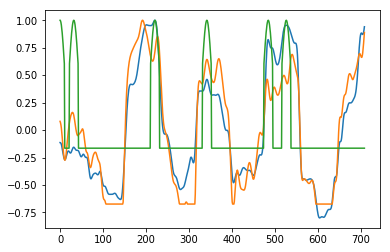

[1,  4681] loss: 0.158


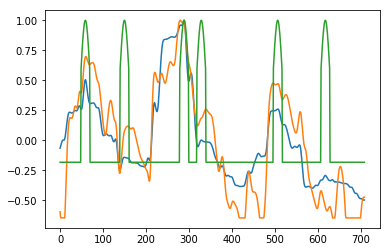

[1,  4711] loss: 0.159


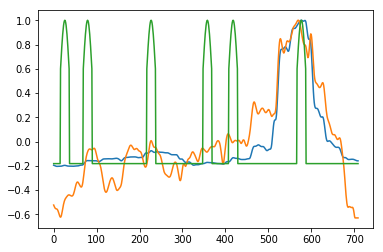

[1,  4741] loss: 0.160


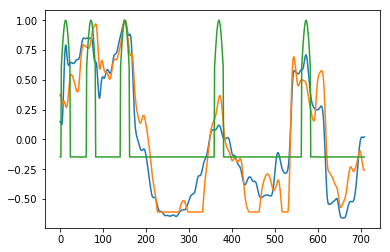

[1,  4771] loss: 0.161


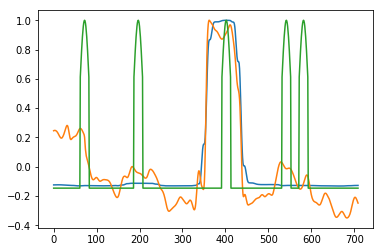

[1,  4801] loss: 0.162


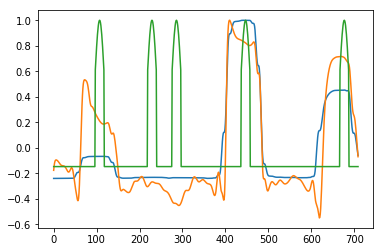

[1,  4831] loss: 0.163


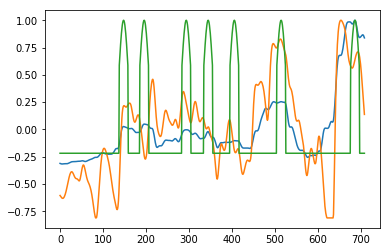

[1,  4861] loss: 0.164


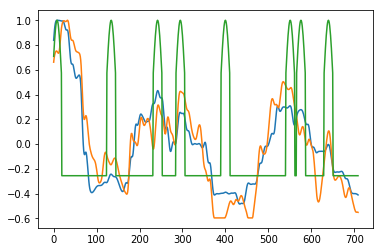

[1,  4891] loss: 0.165


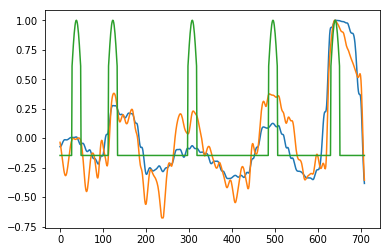

[1,  4921] loss: 0.166


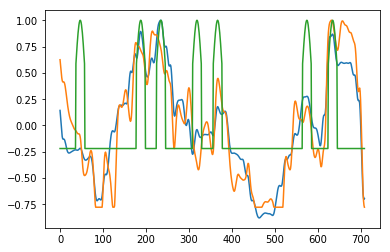

[1,  4951] loss: 0.168


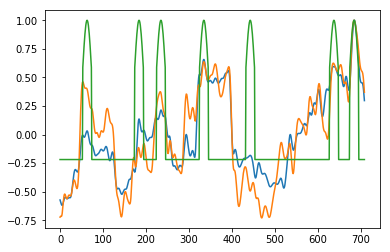

[1,  4981] loss: 0.169


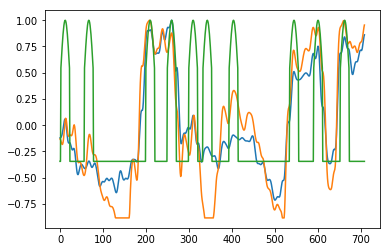

[1,  5011] loss: 0.170


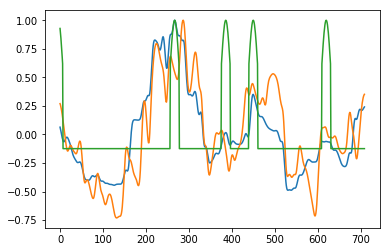

[1,  5041] loss: 0.171


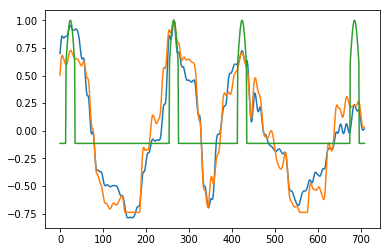

[1,  5071] loss: 0.172


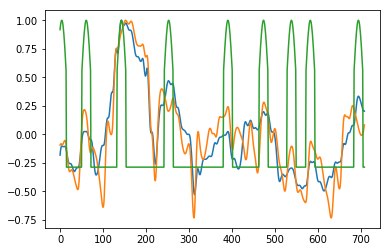

[1,  5101] loss: 0.173


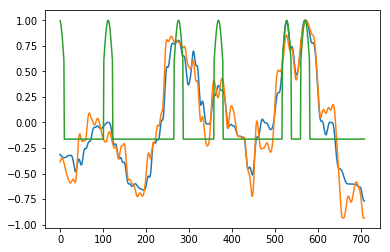

[1,  5131] loss: 0.174


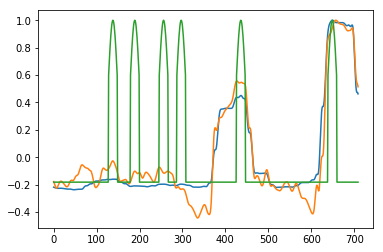

[1,  5161] loss: 0.174


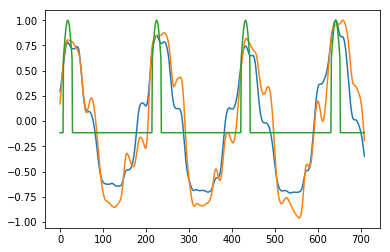

[1,  5191] loss: 0.175


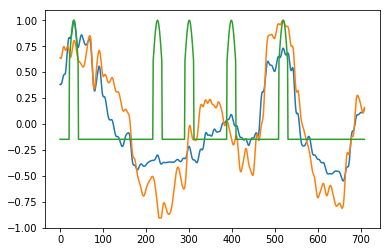

[1,  5221] loss: 0.176


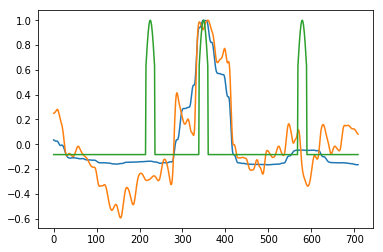

[1,  5251] loss: 0.177


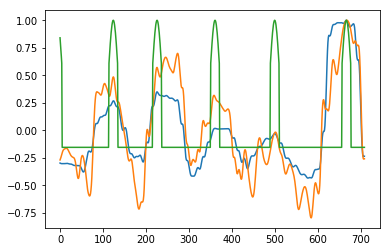

[1,  5281] loss: 0.178


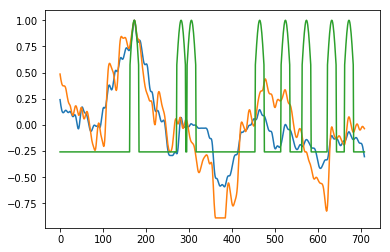

[1,  5311] loss: 0.179


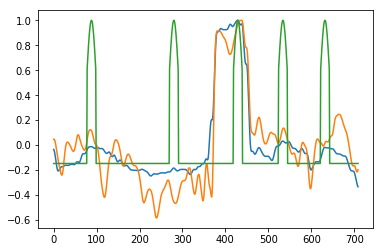

[1,  5341] loss: 0.180


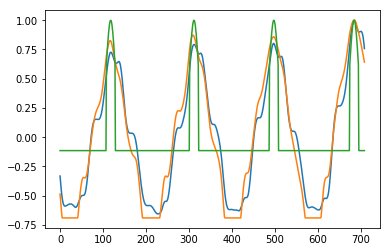

[1,  5371] loss: 0.181


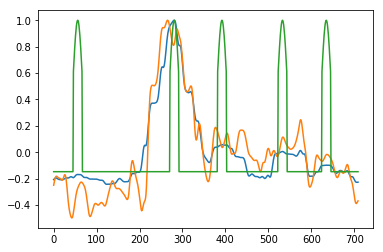

[1,  5401] loss: 0.182


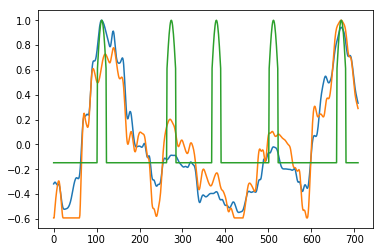

[1,  5431] loss: 0.182


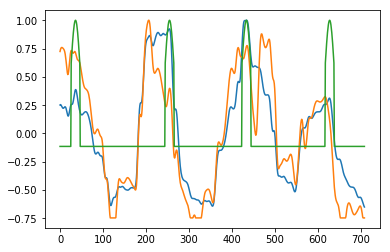

[1,  5461] loss: 0.183


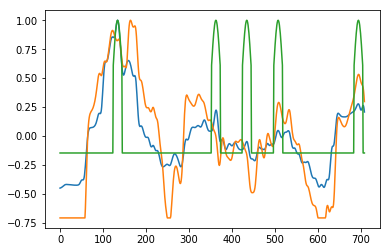

[1,  5491] loss: 0.184


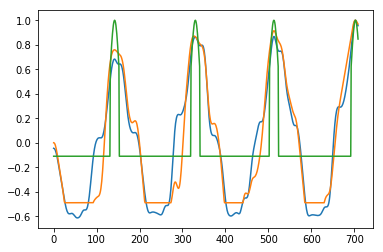

[1,  5521] loss: 0.185


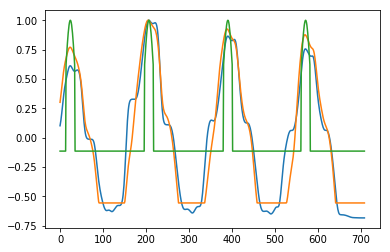

[1,  5551] loss: 0.186


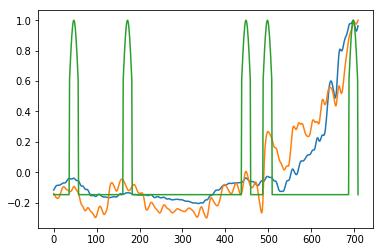

[1,  5581] loss: 0.187


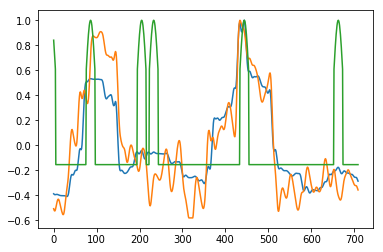

[1,  5611] loss: 0.188


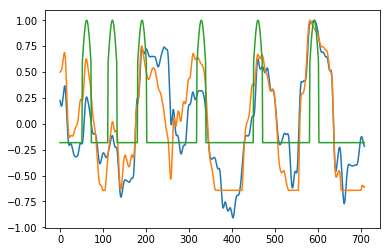

[1,  5641] loss: 0.189


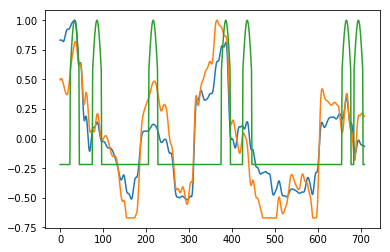

[1,  5671] loss: 0.189


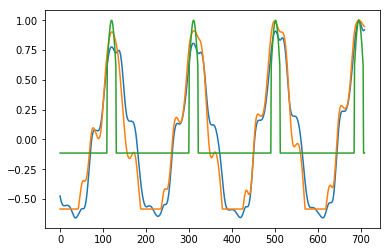

[1,  5701] loss: 0.190


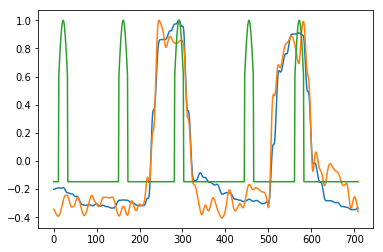

[1,  5731] loss: 0.191


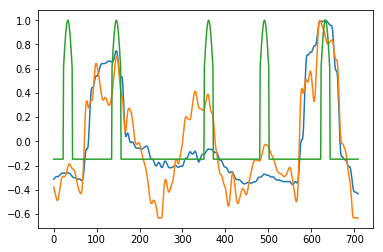

[1,  5761] loss: 0.192


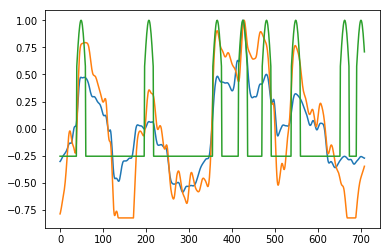

[1,  5791] loss: 0.193


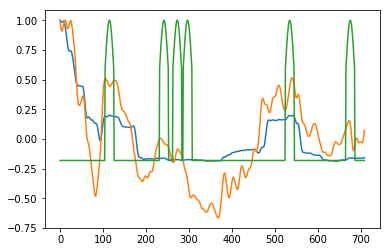

[1,  5821] loss: 0.195


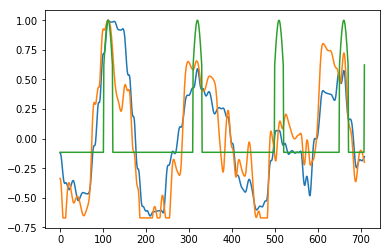

[1,  5851] loss: 0.196


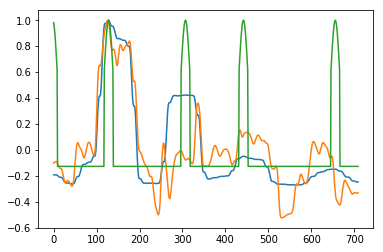

[1,  5881] loss: 0.197


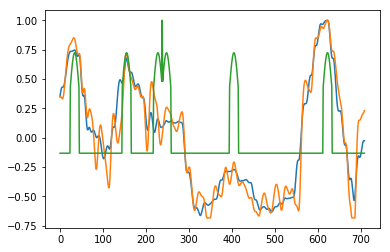

[1,  5911] loss: 0.198


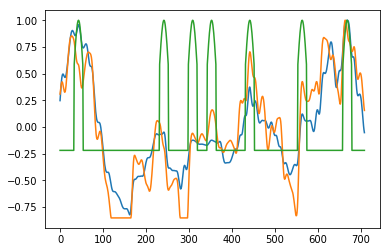

[1,  5941] loss: 0.199


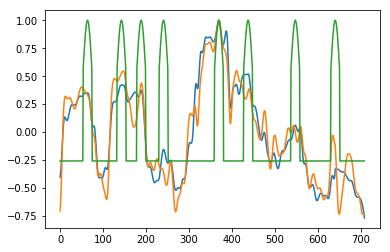

[1,  5971] loss: 0.200


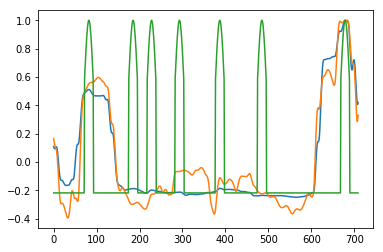

[1,  6001] loss: 0.201


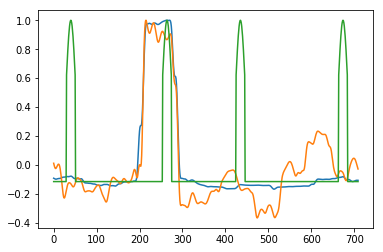

[1,  6031] loss: 0.202


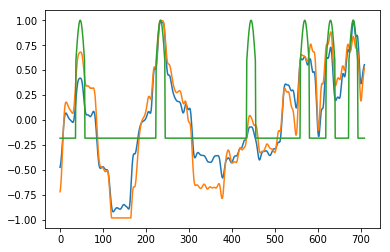

[1,  6061] loss: 0.203


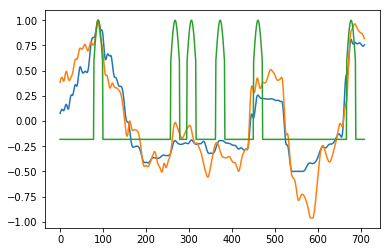

[1,  6091] loss: 0.204


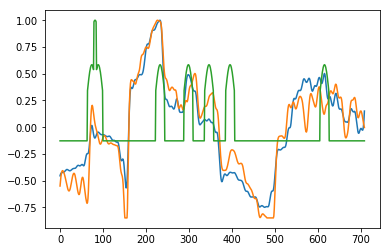

[1,  6121] loss: 0.205


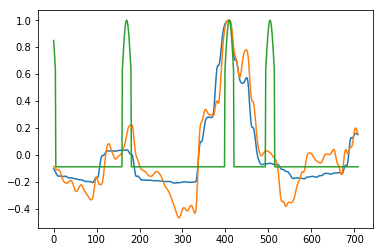

[1,  6151] loss: 0.206


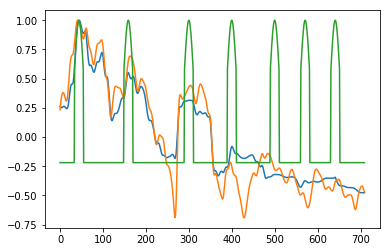

[1,  6181] loss: 0.207


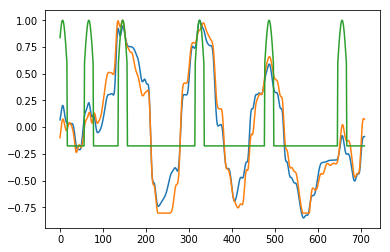

[1,  6211] loss: 0.208


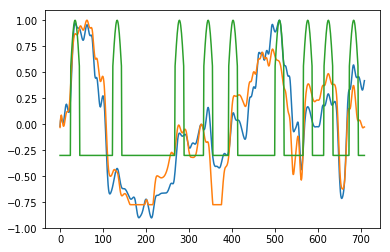

[1,  6241] loss: 0.209


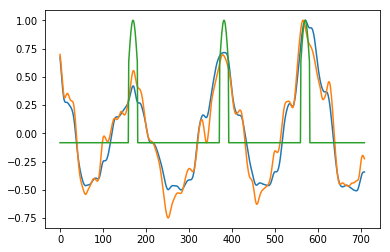

[1,  6271] loss: 0.210


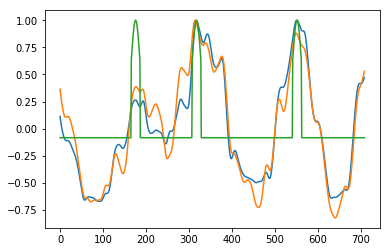

[1,  6301] loss: 0.211


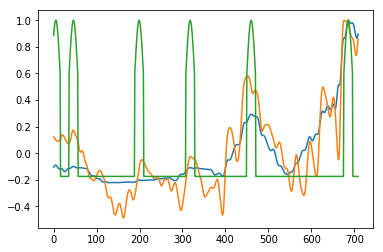

[1,  6331] loss: 0.211


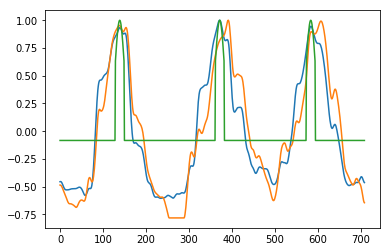

[1,  6361] loss: 0.212


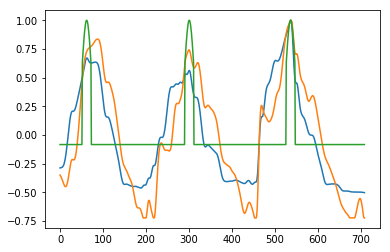

[1,  6391] loss: 0.213


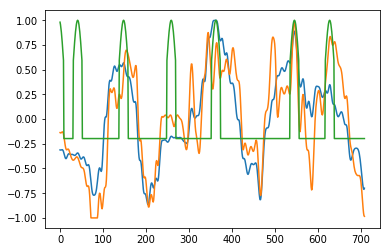

[1,  6421] loss: 0.214


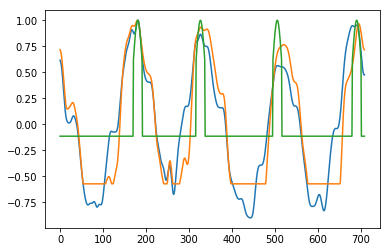

[1,  6451] loss: 0.215


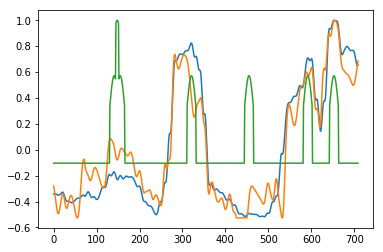

[1,  6481] loss: 0.216


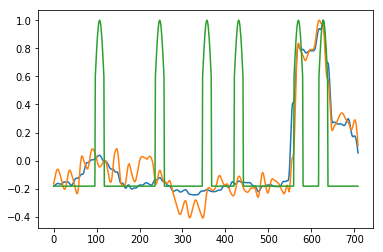

[1,  6511] loss: 0.217


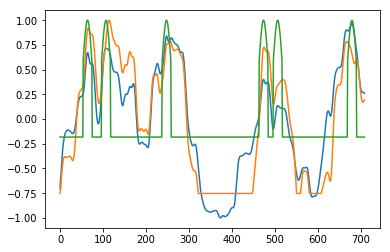

[1,  6541] loss: 0.218


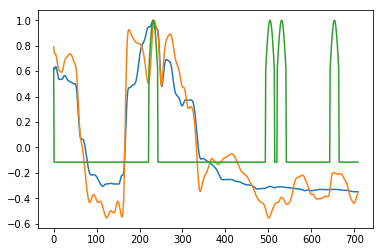

[1,  6571] loss: 0.219


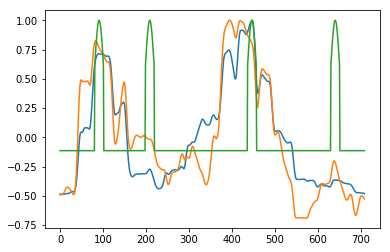

[1,  6601] loss: 0.219


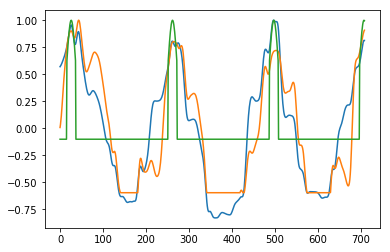

[1,  6631] loss: 0.221


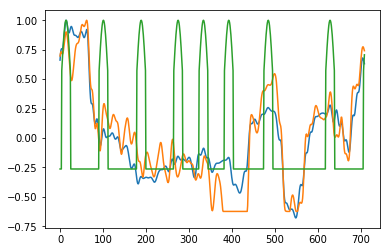

[1,  6661] loss: 0.221


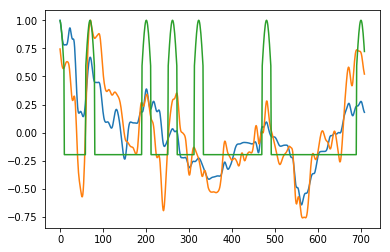

[1,  6691] loss: 0.222


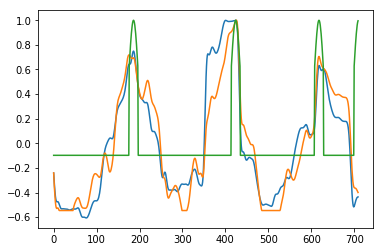

[1,  6721] loss: 0.224


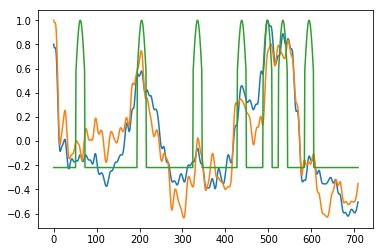

[1,  6751] loss: 0.225


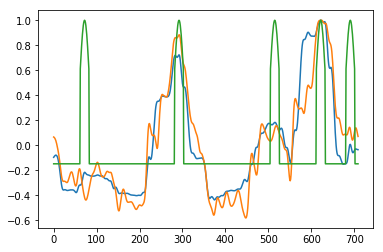

[1,  6781] loss: 0.226


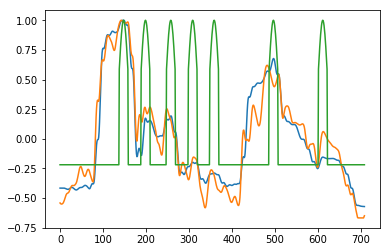

[1,  6811] loss: 0.227


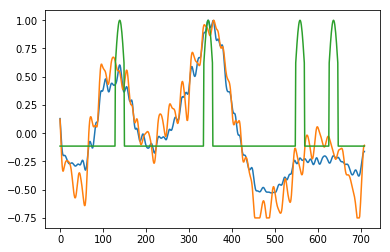

[1,  6841] loss: 0.228


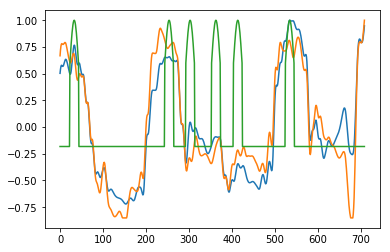

[1,  6871] loss: 0.229


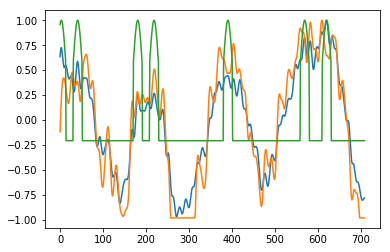

[1,  6901] loss: 0.229


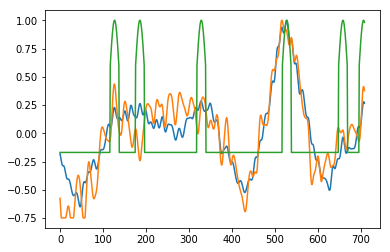

[1,  6931] loss: 0.231


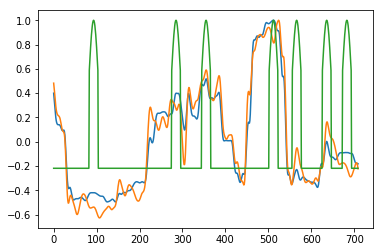

[1,  6961] loss: 0.232


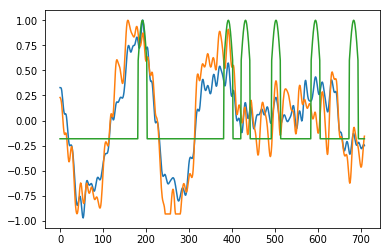

[1,  6991] loss: 0.233


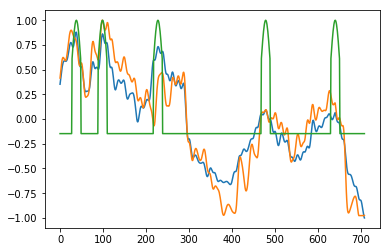

[1,  7021] loss: 0.233


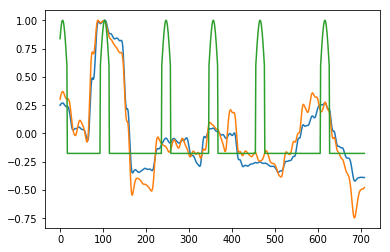

[1,  7051] loss: 0.234


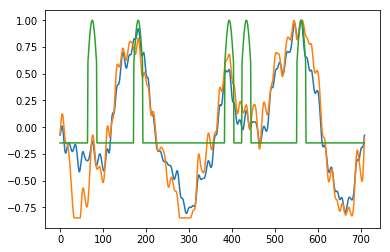

[1,  7081] loss: 0.235


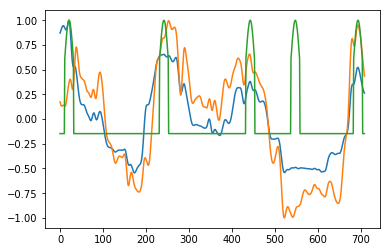

[1,  7111] loss: 0.236


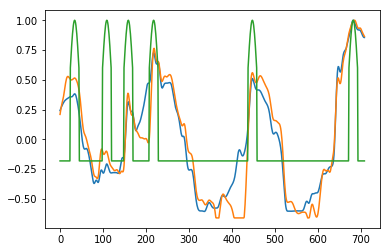

[1,  7141] loss: 0.237


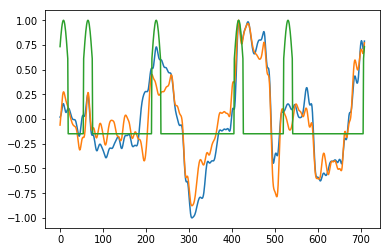

[1,  7171] loss: 0.238


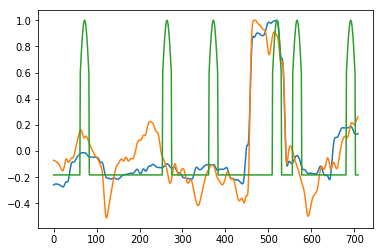

[1,  7201] loss: 0.239


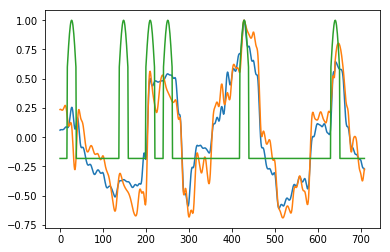

[1,  7231] loss: 0.240


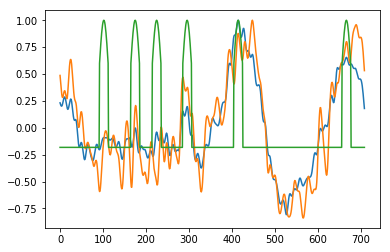

[1,  7261] loss: 0.241


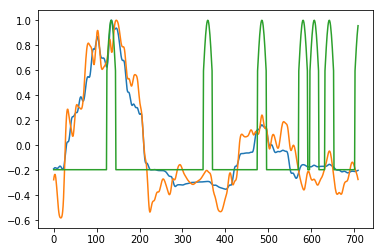

[1,  7291] loss: 0.242


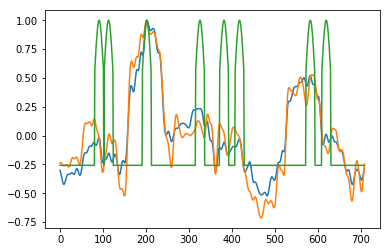

[1,  7321] loss: 0.243


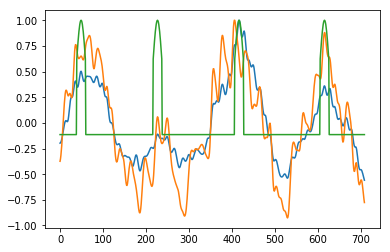

[1,  7351] loss: 0.243


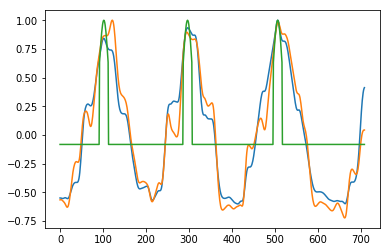

[1,  7381] loss: 0.244


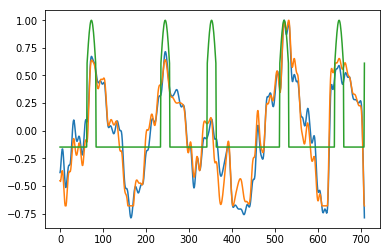

[1,  7411] loss: 0.245


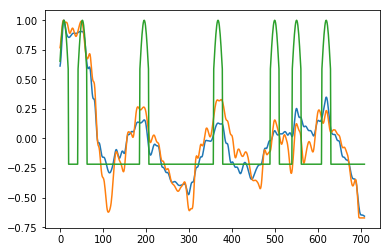

[1,  7441] loss: 0.246


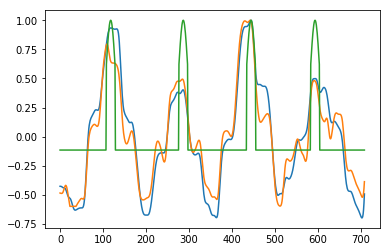

[1,  7471] loss: 0.247


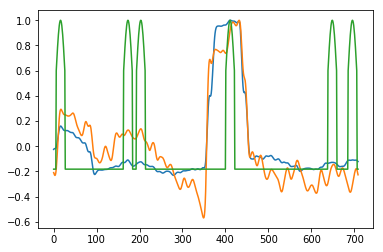

[1,  7501] loss: 0.248


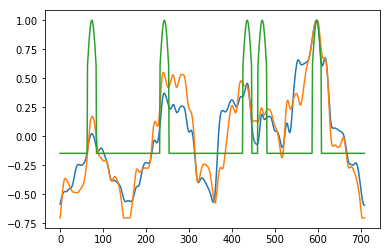

[1,  7531] loss: 0.249


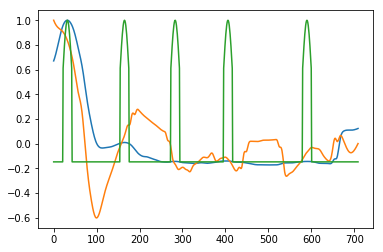

[1,  7561] loss: 0.250


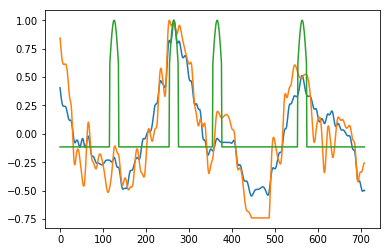

[1,  7591] loss: 0.251


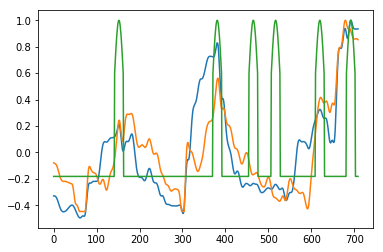

[1,  7621] loss: 0.252


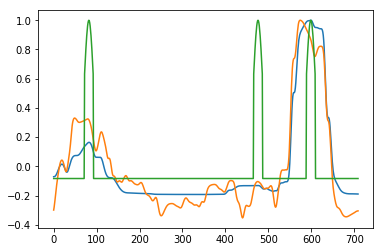

[1,  7651] loss: 0.253


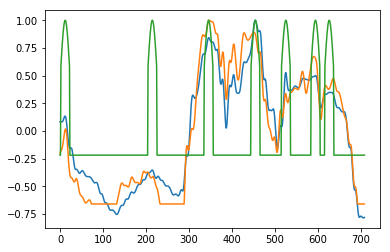

[1,  7681] loss: 0.253


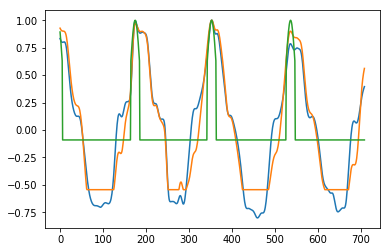

[1,  7711] loss: 0.254


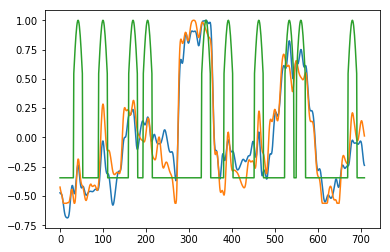

[1,  7741] loss: 0.255


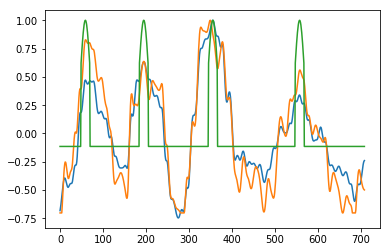

[1,  7771] loss: 0.256


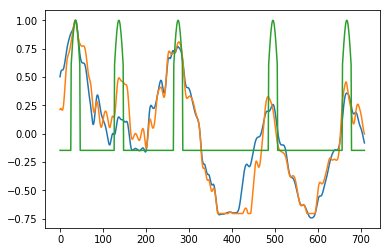

[1,  7801] loss: 0.257


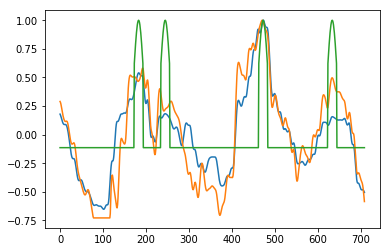

[1,  7831] loss: 0.258


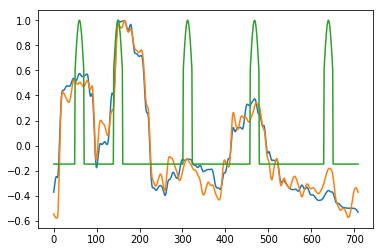

[1,  7861] loss: 0.259


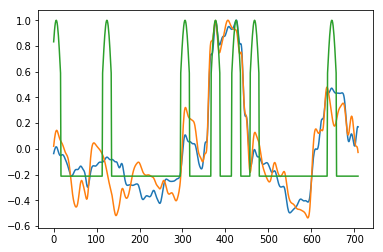

[1,  7891] loss: 0.260


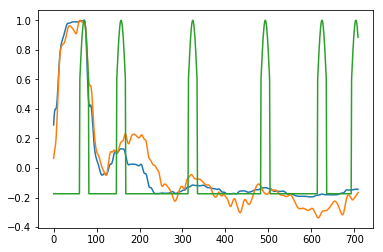

[1,  7921] loss: 0.261


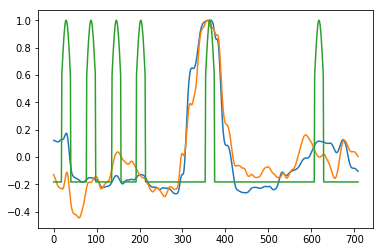

[1,  7951] loss: 0.262


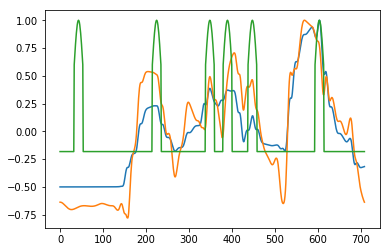

[1,  7981] loss: 0.263


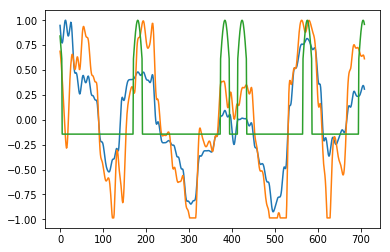

[1,  8011] loss: 0.264


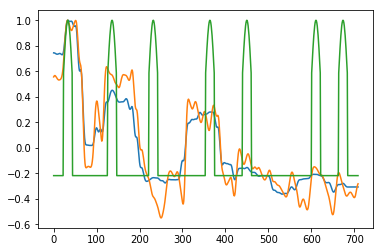

[1,  8041] loss: 0.265


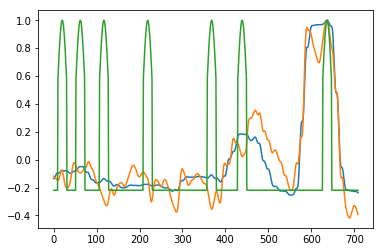

[1,  8071] loss: 0.266


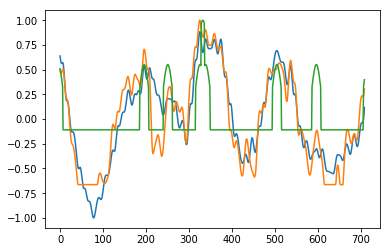

[1,  8101] loss: 0.266


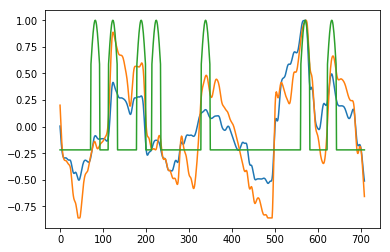

[1,  8131] loss: 0.267


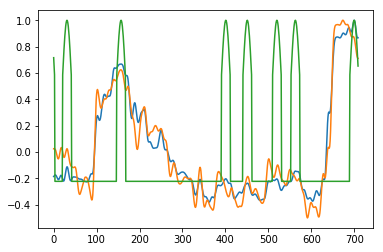

[1,  8161] loss: 0.268


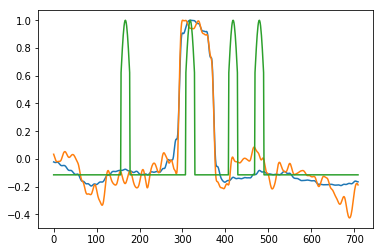

[1,  8191] loss: 0.269


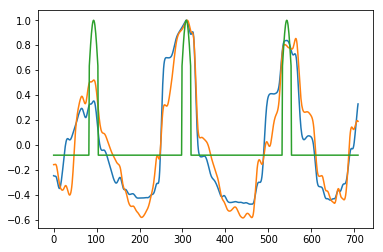

[1,  8221] loss: 0.270


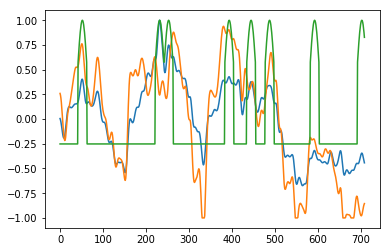

[1,  8251] loss: 0.271


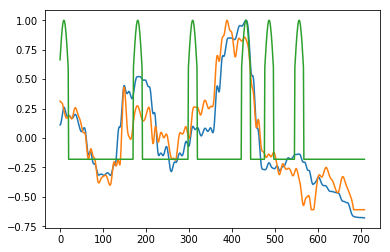

[1,  8281] loss: 0.272


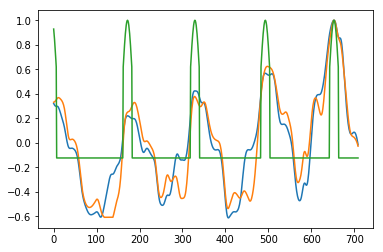

[1,  8311] loss: 0.273


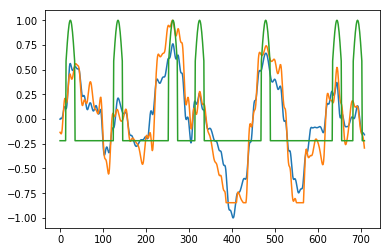

[1,  8341] loss: 0.274


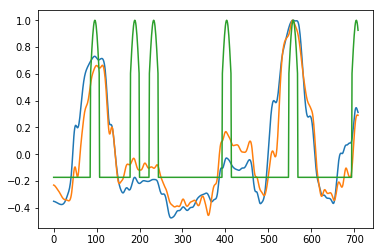

[1,  8371] loss: 0.275


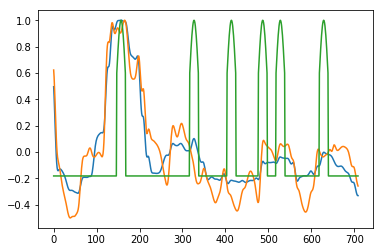

[1,  8401] loss: 0.276


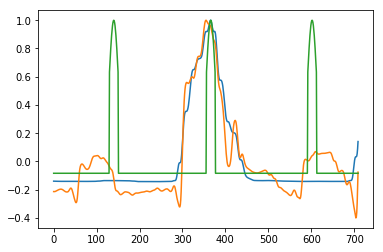

[1,  8431] loss: 0.277


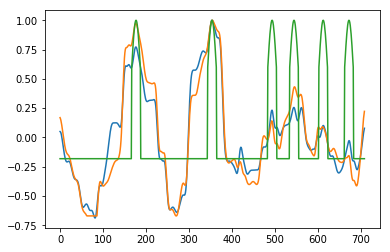

[1,  8461] loss: 0.278


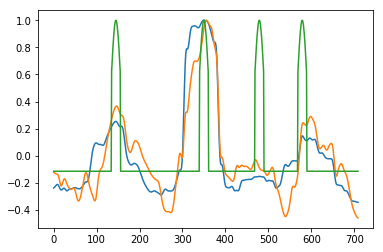

[1,  8491] loss: 0.279


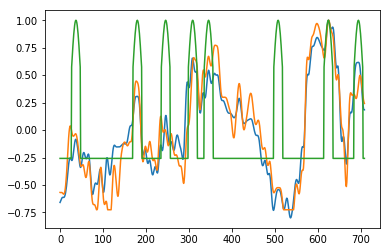

[1,  8521] loss: 0.280


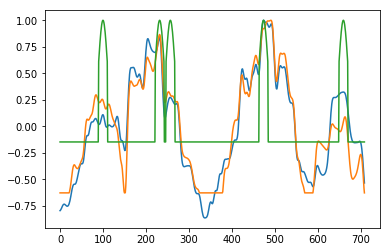

[1,  8551] loss: 0.281


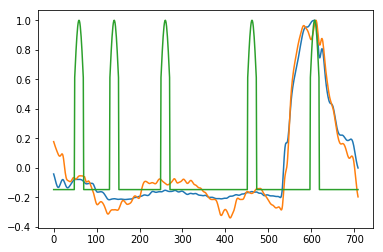

[1,  8581] loss: 0.282


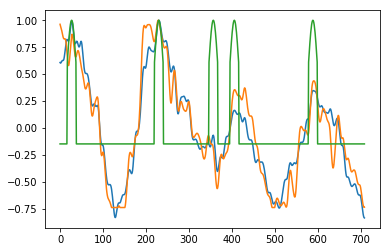

[1,  8611] loss: 0.283


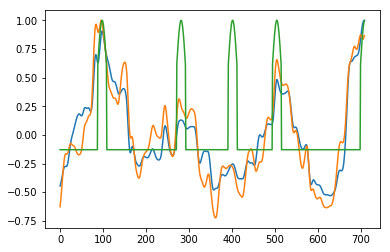

[1,  8641] loss: 0.284


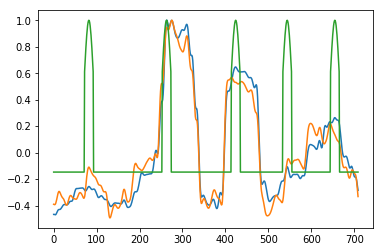

[1,  8671] loss: 0.285


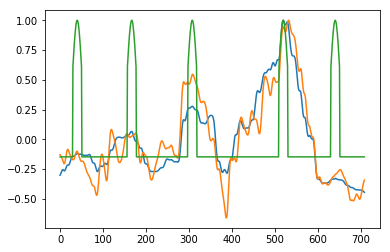

[1,  8701] loss: 0.285


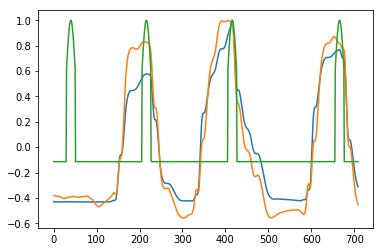

[1,  8731] loss: 0.286


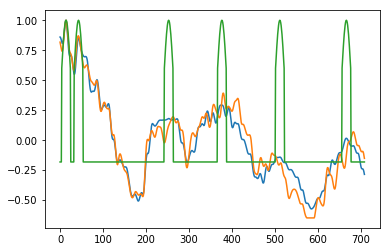

[1,  8761] loss: 0.287


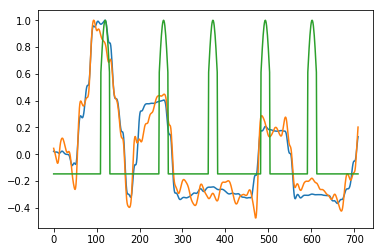

[1,  8791] loss: 0.288


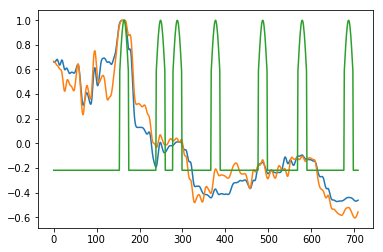

[1,  8821] loss: 0.289


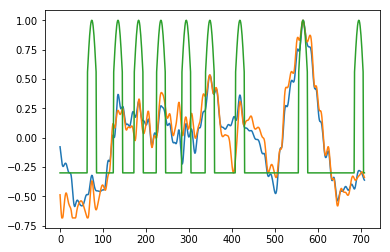

[1,  8851] loss: 0.290


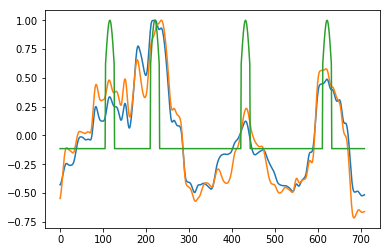

[1,  8881] loss: 0.291


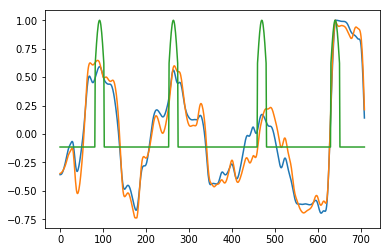

[1,  8911] loss: 0.292


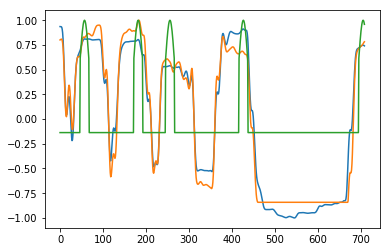

[1,  8941] loss: 0.293


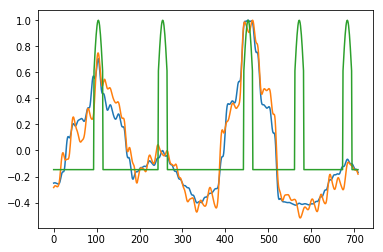

[1,  8971] loss: 0.294


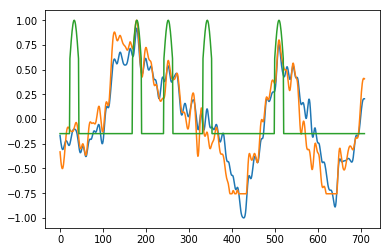

[1,  9001] loss: 0.295


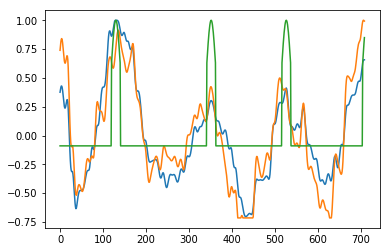

[1,  9031] loss: 0.296


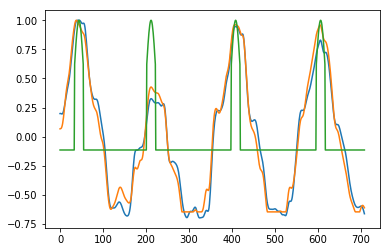

[1,  9061] loss: 0.297


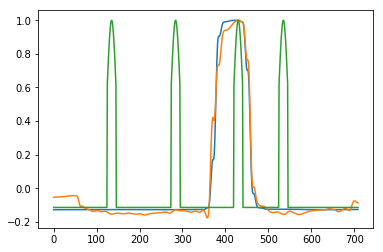

[1,  9091] loss: 0.297


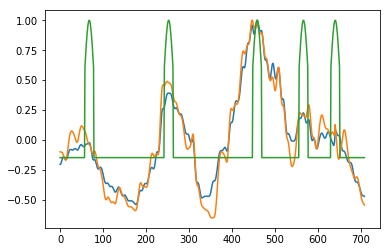

[1,  9121] loss: 0.298


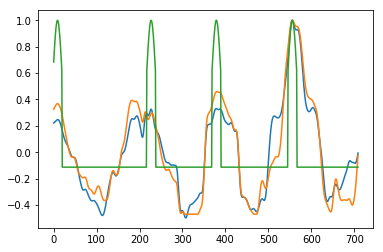

[1,  9151] loss: 0.299


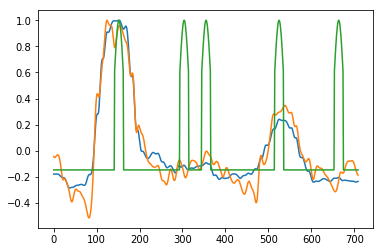

[1,  9181] loss: 0.300


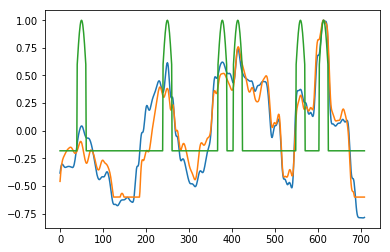

[1,  9211] loss: 0.301


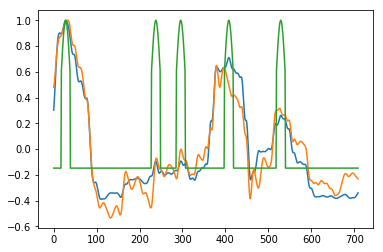

[1,  9241] loss: 0.302


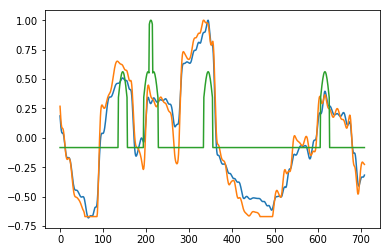

[1,  9271] loss: 0.303


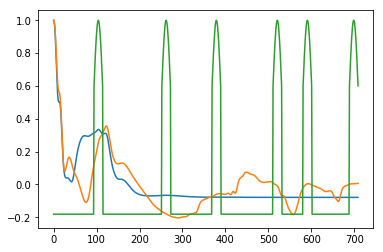

[1,  9301] loss: 0.304


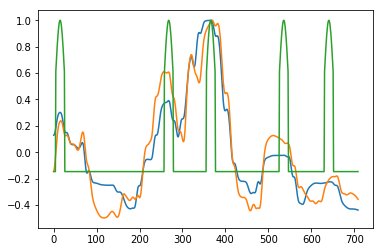

[1,  9331] loss: 0.305


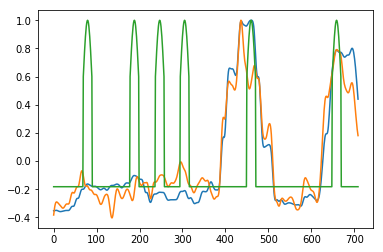

[1,  9361] loss: 0.306


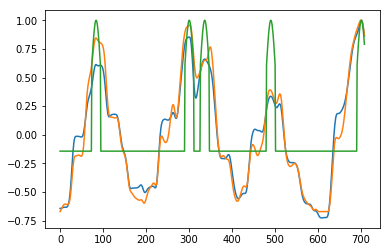

[1,  9391] loss: 0.307


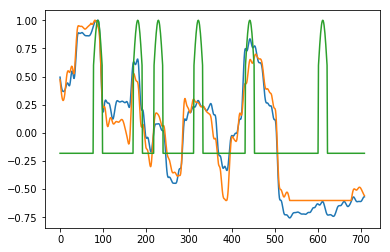

[1,  9421] loss: 0.308


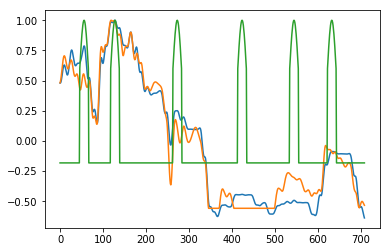

[1,  9451] loss: 0.309


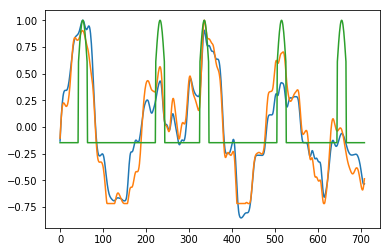

[1,  9481] loss: 0.310


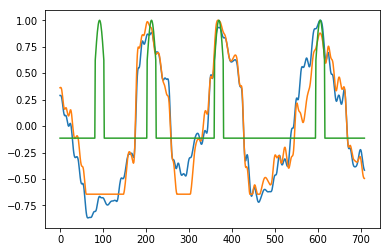

[1,  9511] loss: 0.311


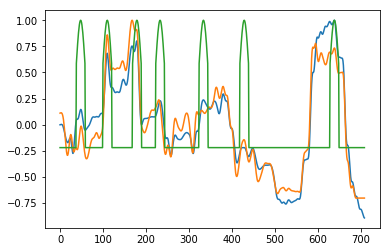

[1,  9541] loss: 0.311


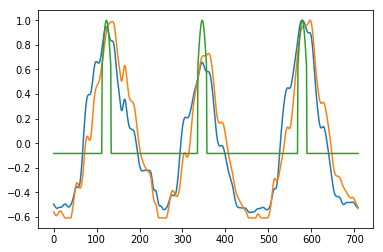

[1,  9571] loss: 0.312


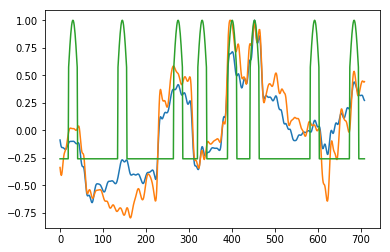

[1,  9601] loss: 0.313


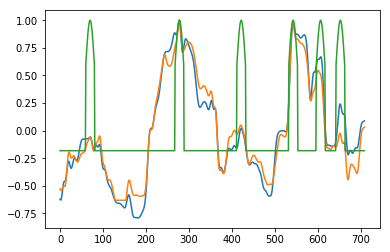

[1,  9631] loss: 0.314


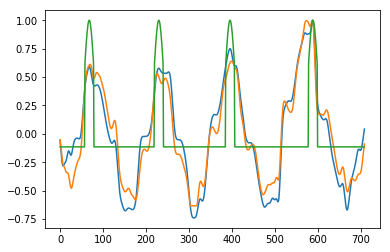

[1,  9661] loss: 0.315


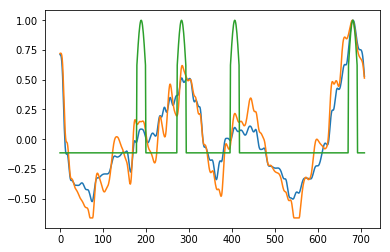

[1,  9691] loss: 0.316


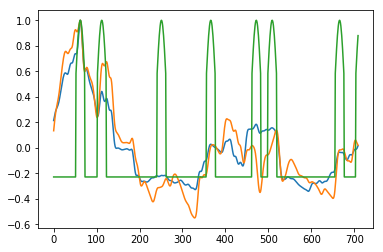

[1,  9721] loss: 0.317


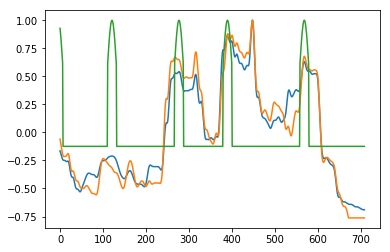

[1,  9751] loss: 0.318


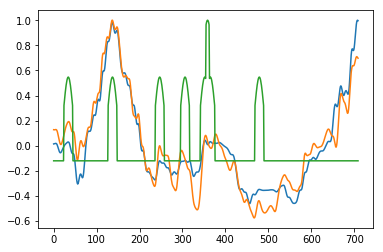

[1,  9781] loss: 0.319


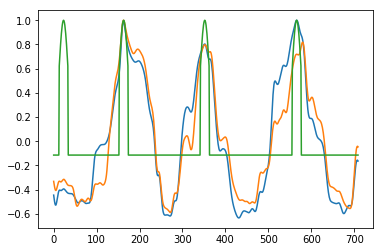

[1,  9811] loss: 0.320


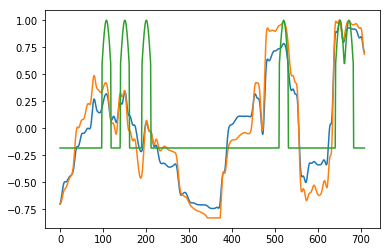

[1,  9841] loss: 0.321


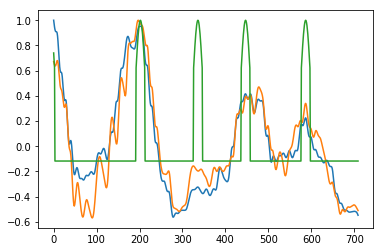

[1,  9871] loss: 0.322


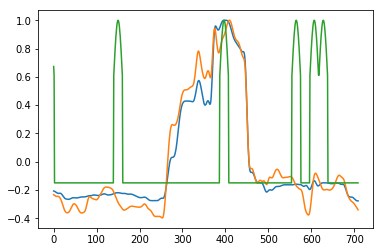

[1,  9901] loss: 0.323


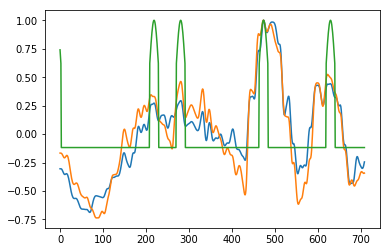

[1,  9931] loss: 0.324


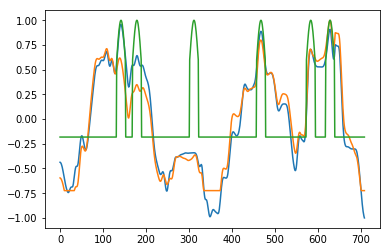

[1,  9961] loss: 0.325


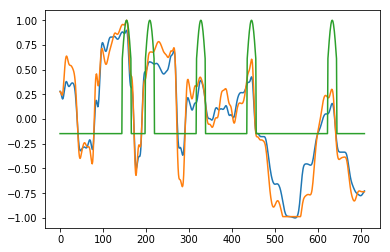

[1,  9991] loss: 0.326


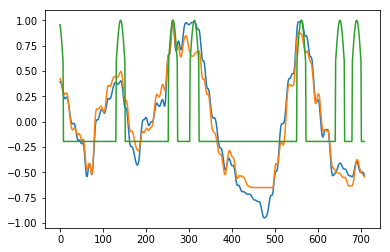

[1, 10021] loss: 0.327


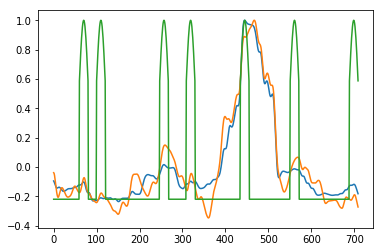

[1, 10051] loss: 0.328


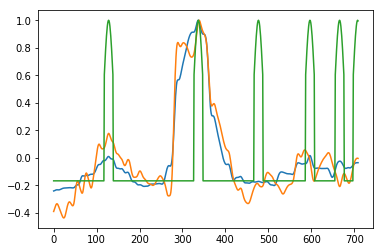

[1, 10081] loss: 0.329


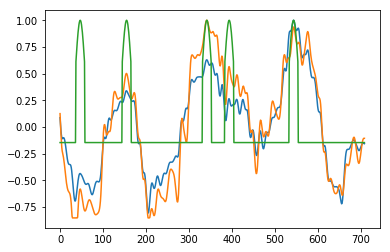

[1, 10111] loss: 0.330


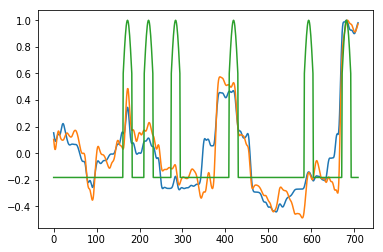

[1, 10141] loss: 0.331


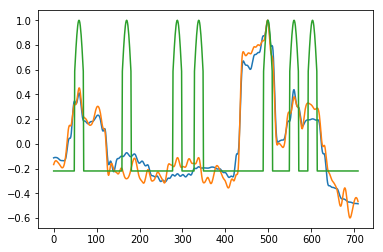

[1, 10171] loss: 0.332


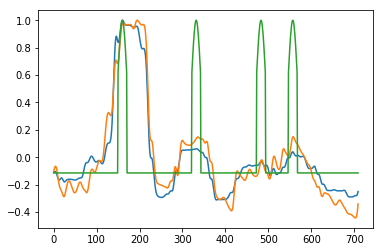

[1, 10201] loss: 0.333


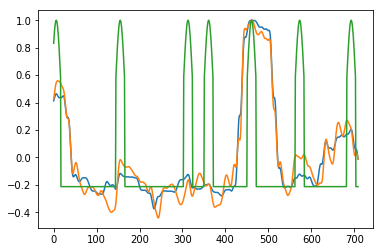

[1, 10231] loss: 0.334


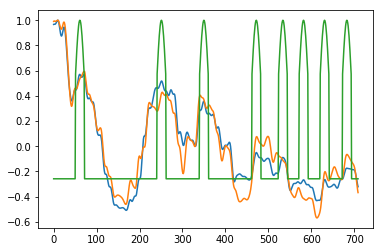

[1, 10261] loss: 0.335


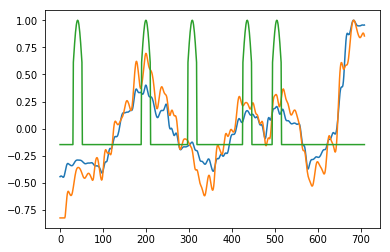

[1, 10291] loss: 0.336


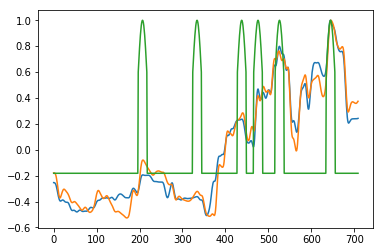

[1, 10321] loss: 0.337


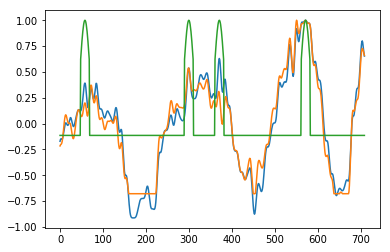

[1, 10351] loss: 0.338


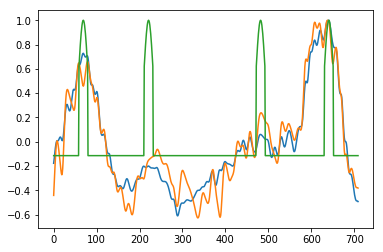

[1, 10381] loss: 0.339


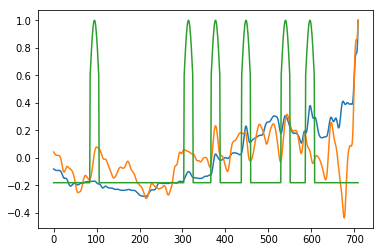

[1, 10411] loss: 0.340


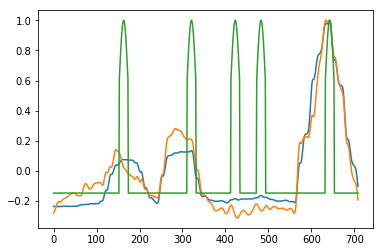

[1, 10441] loss: 0.342


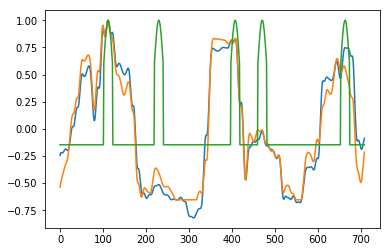

[1, 10471] loss: 0.343


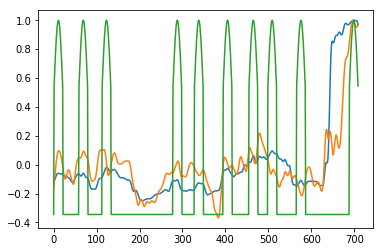

[1, 10501] loss: 0.344


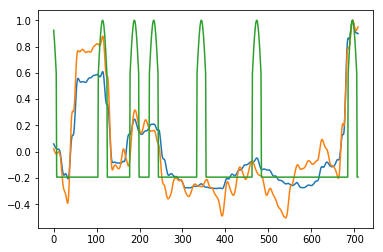

[1, 10531] loss: 0.345


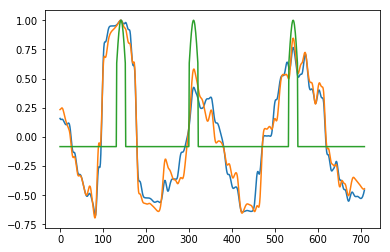

[1, 10561] loss: 0.346


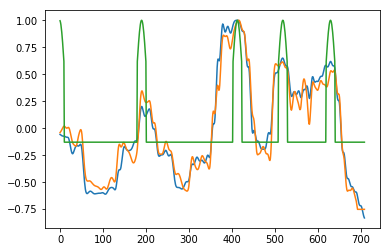

[1, 10591] loss: 0.347


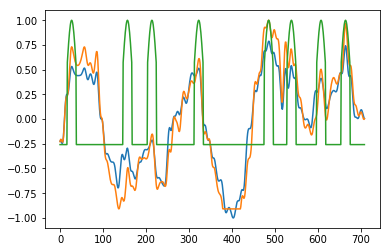

[1, 10621] loss: 0.348


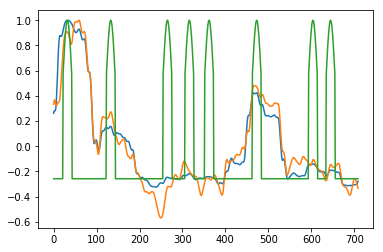

[1, 10651] loss: 0.349


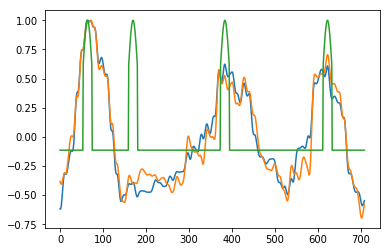

[1, 10681] loss: 0.350


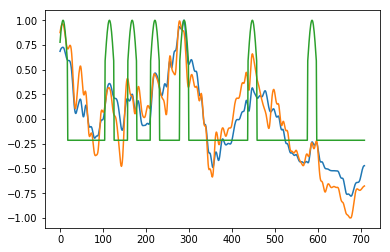

[1, 10711] loss: 0.351


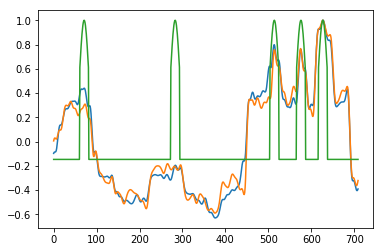

[1, 10741] loss: 0.352


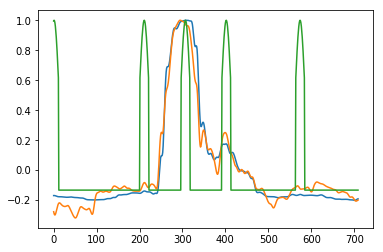

[1, 10771] loss: 0.353


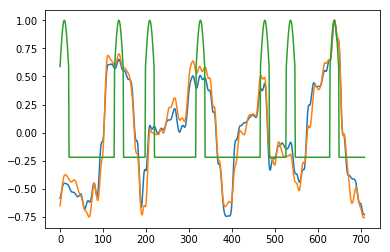

[1, 10801] loss: 0.354


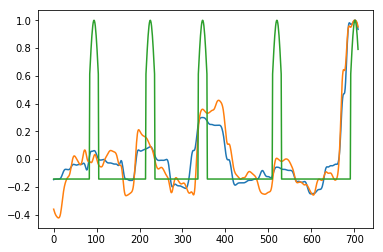

[1, 10831] loss: 0.355


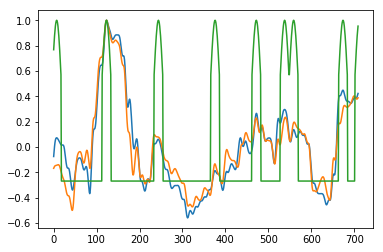

[1, 10861] loss: 0.356


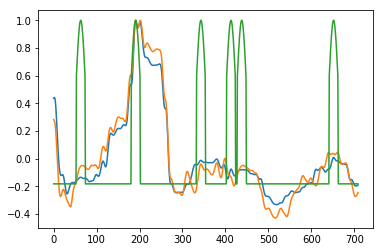

[1, 10891] loss: 0.357


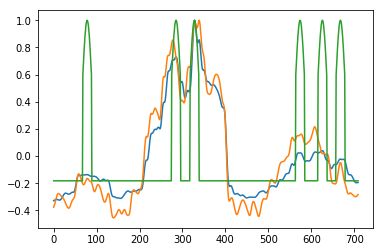

[1, 10921] loss: 0.358


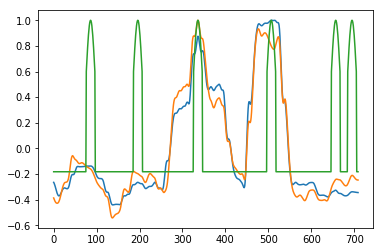

[1, 10951] loss: 0.359


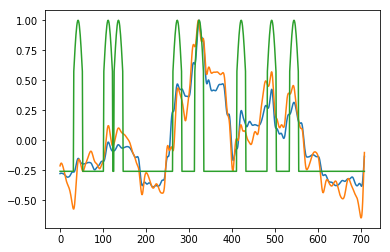

[1, 10981] loss: 0.360


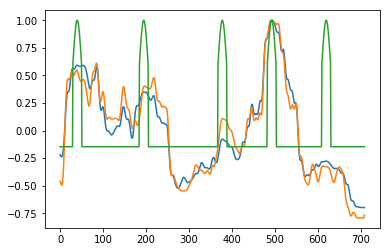

[1, 11011] loss: 0.361


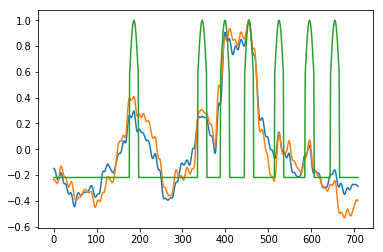

[1, 11041] loss: 0.362


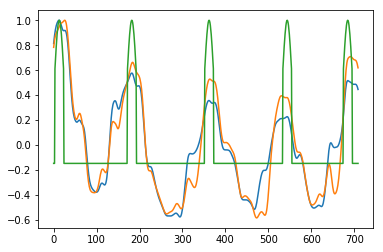

[1, 11071] loss: 0.363


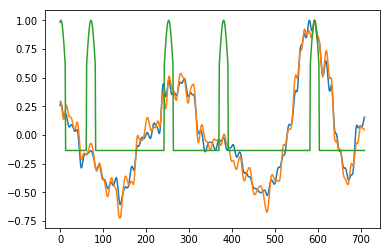

[1, 11101] loss: 0.364


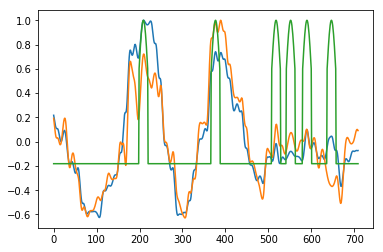

[1, 11131] loss: 0.365


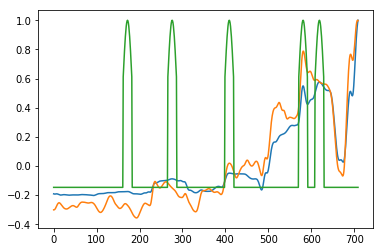

[1, 11161] loss: 0.366


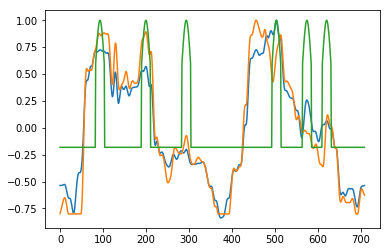

[1, 11191] loss: 0.367


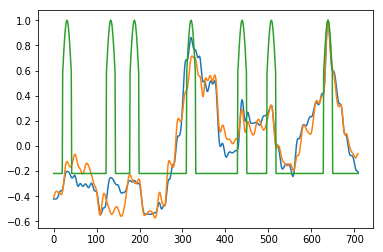

[1, 11221] loss: 0.368


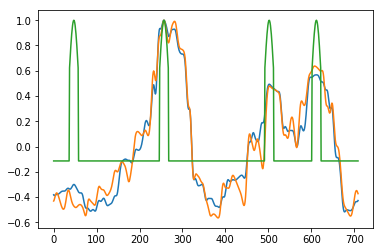

[1, 11251] loss: 0.369


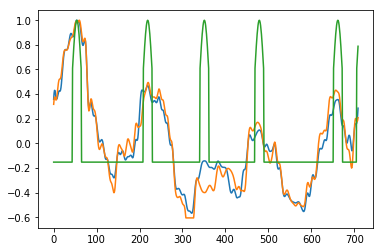

[1, 11281] loss: 0.370


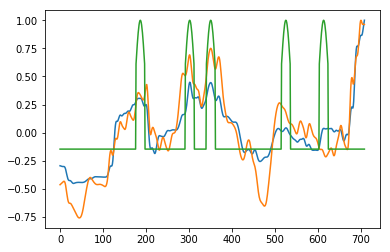

[1, 11311] loss: 0.371


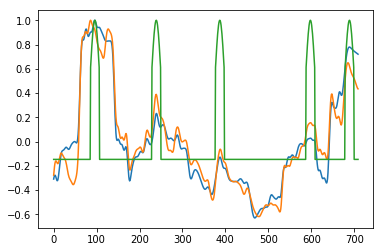

[1, 11341] loss: 0.372


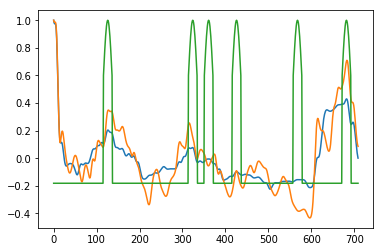

[1, 11371] loss: 0.373


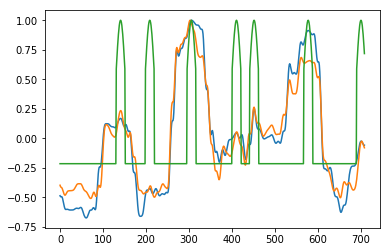

[1, 11401] loss: 0.374


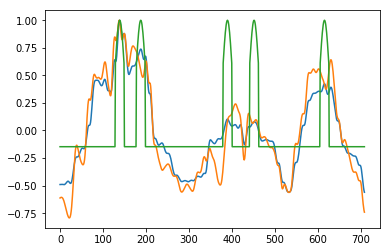

[1, 11431] loss: 0.375


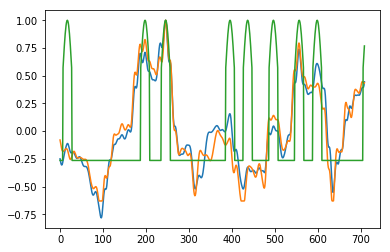

[1, 11461] loss: 0.376


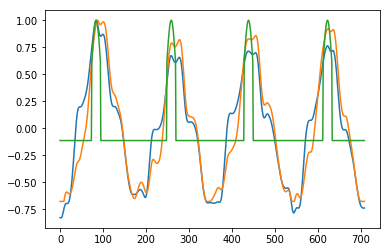

[1, 11491] loss: 0.377


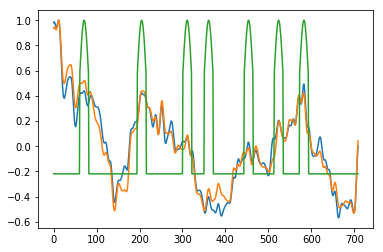

[1, 11521] loss: 0.377


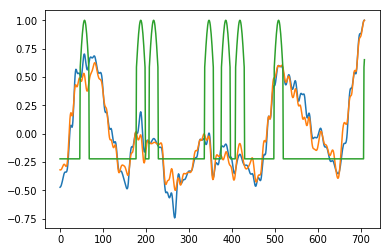

[1, 11551] loss: 0.378


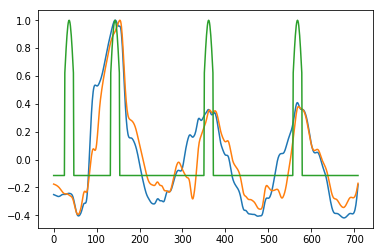

[1, 11581] loss: 0.379


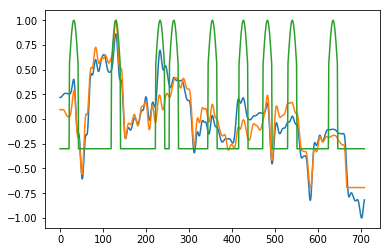

[1, 11611] loss: 0.380


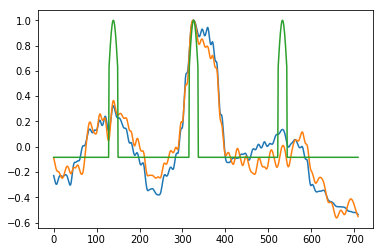

[1, 11641] loss: 0.381


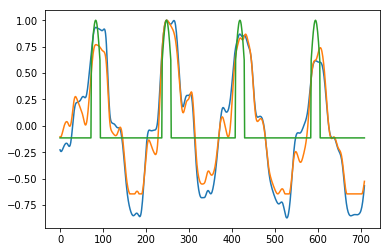

[1, 11671] loss: 0.382


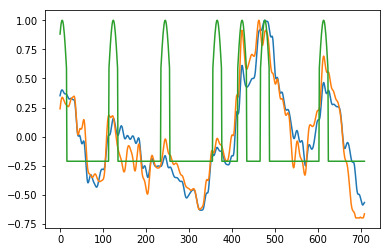

[1, 11701] loss: 0.383


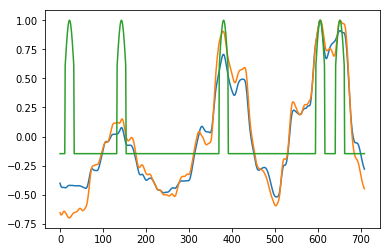

[1, 11731] loss: 0.384


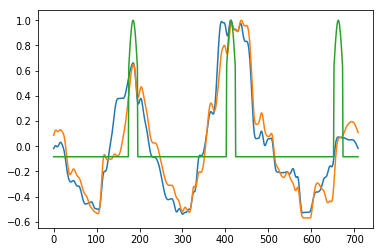

[1, 11761] loss: 0.384


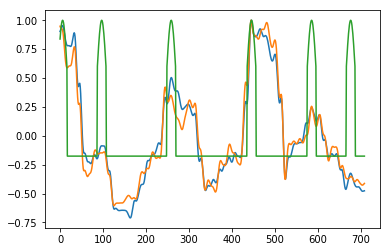

[1, 11791] loss: 0.386


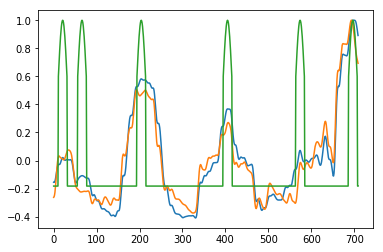

[1, 11821] loss: 0.387


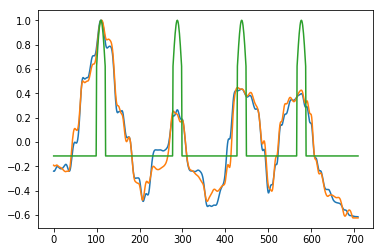

[1, 11851] loss: 0.388


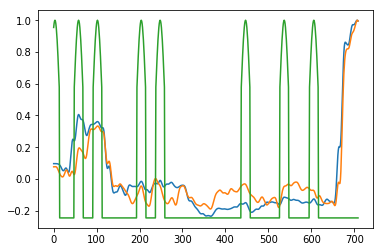

[1, 11881] loss: 0.389


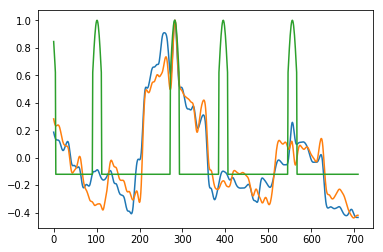

[1, 11911] loss: 0.390


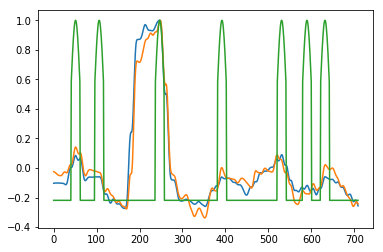

[1, 11941] loss: 0.391


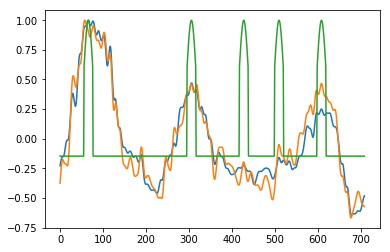

[1, 11971] loss: 0.391


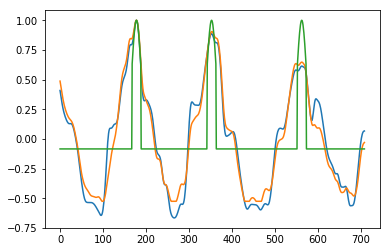

[1, 12001] loss: 0.392


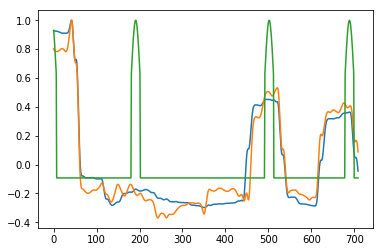

[1, 12031] loss: 0.393


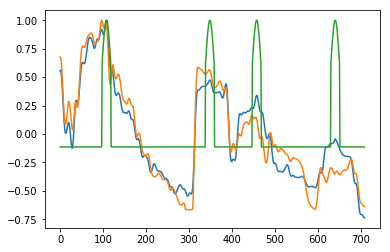

[1, 12061] loss: 0.394


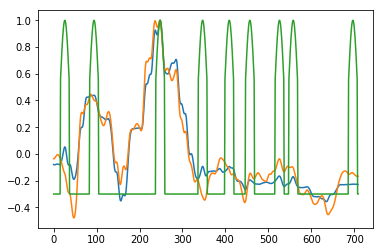

[1, 12091] loss: 0.396


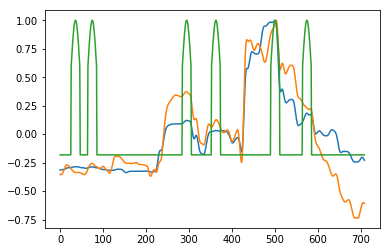

[1, 12121] loss: 0.396


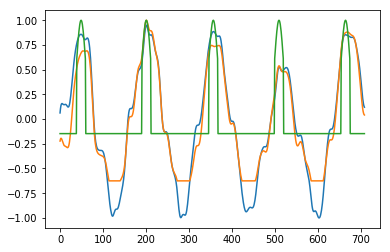

[1, 12151] loss: 0.397


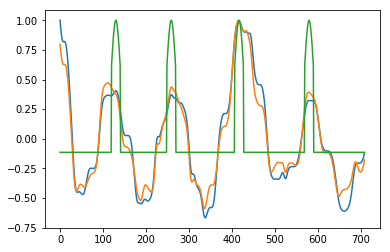

[1, 12181] loss: 0.399


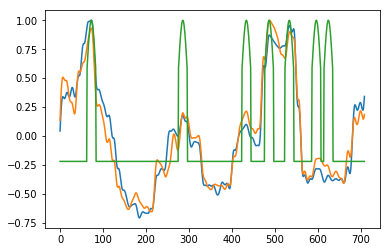

[1, 12211] loss: 0.400


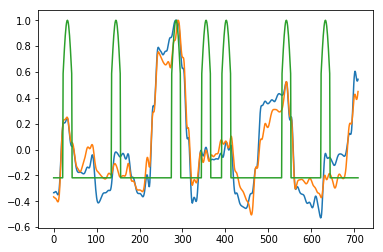

[1, 12241] loss: 0.401


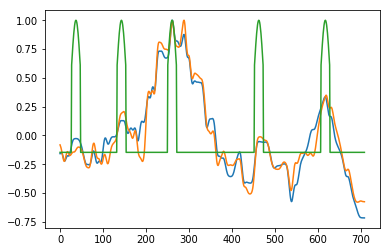

[1, 12271] loss: 0.402


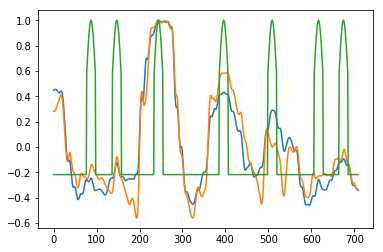

[1, 12301] loss: 0.403


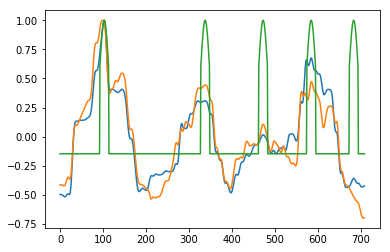

[1, 12331] loss: 0.404


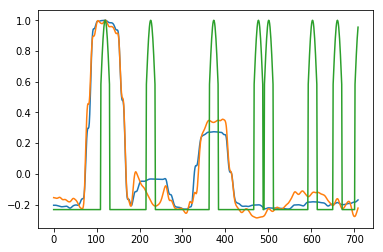

[1, 12361] loss: 0.405


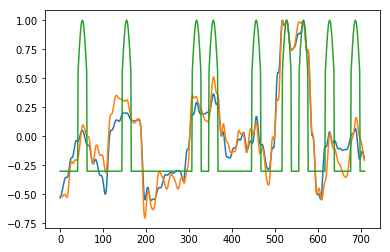

[1, 12391] loss: 0.405


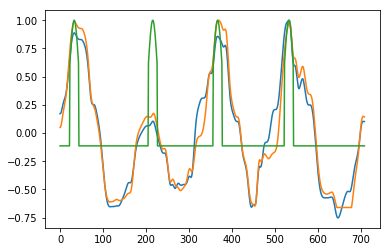

[1, 12421] loss: 0.406


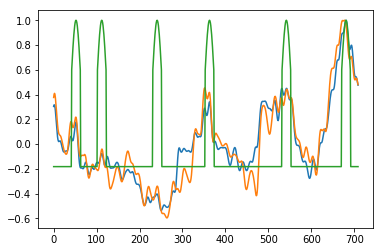

[1, 12451] loss: 0.408


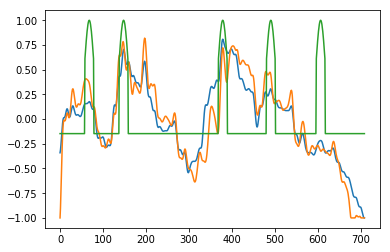

[1, 12481] loss: 0.409


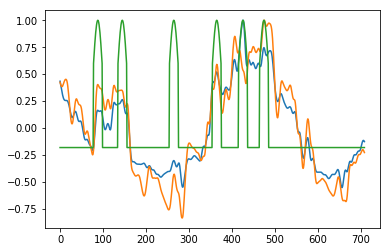

[1, 12511] loss: 0.410


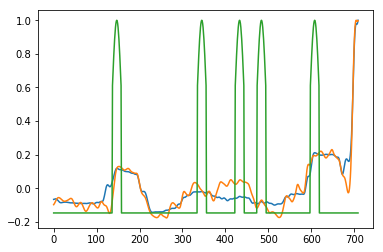

[1, 12541] loss: 0.411


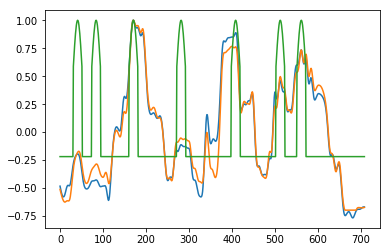

[1, 12571] loss: 0.412


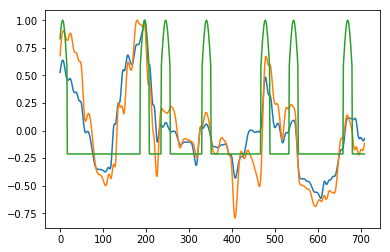

[1, 12601] loss: 0.413


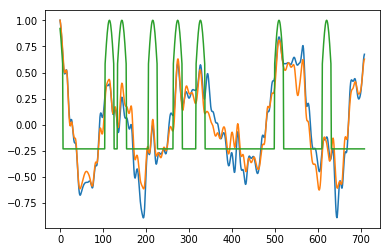

[1, 12631] loss: 0.413


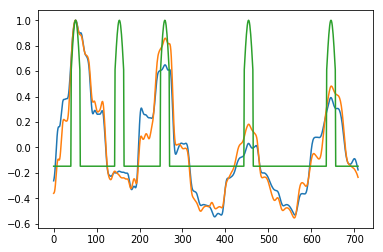

[1, 12661] loss: 0.414


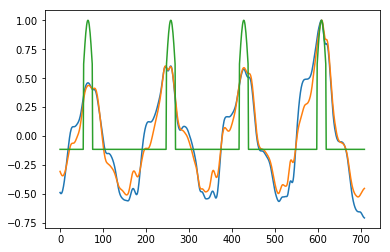

[1, 12691] loss: 0.415


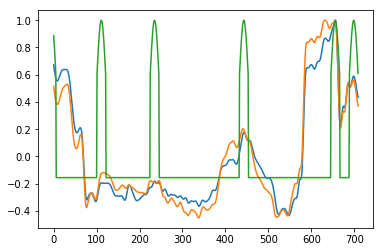

[1, 12721] loss: 0.416


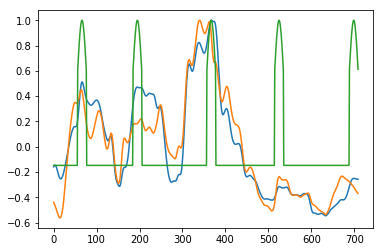

[1, 12751] loss: 0.417


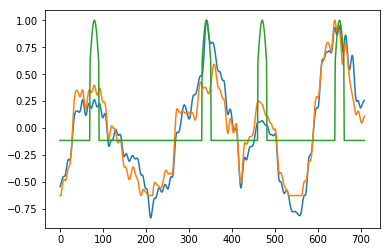

[1, 12781] loss: 0.418


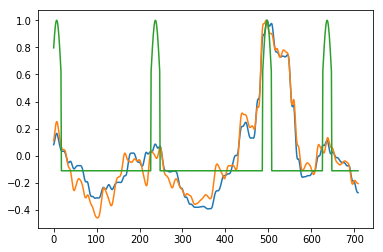

[1, 12811] loss: 0.419


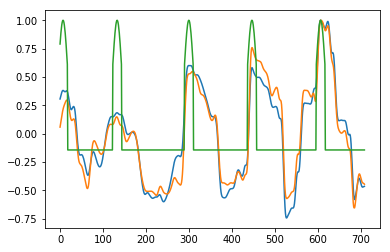

[1, 12841] loss: 0.420


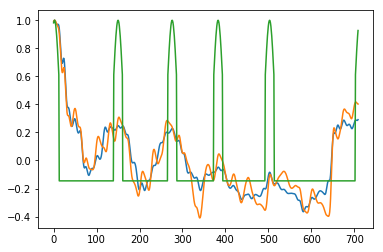

[1, 12871] loss: 0.421


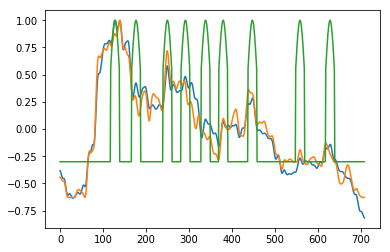

[1, 12901] loss: 0.422


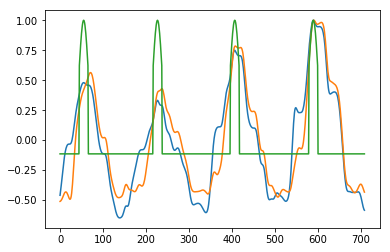

[1, 12931] loss: 0.423


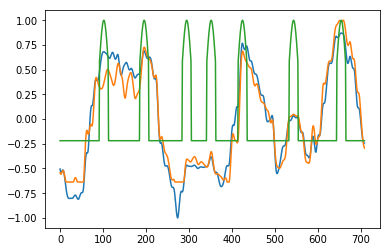

[1, 12961] loss: 0.424


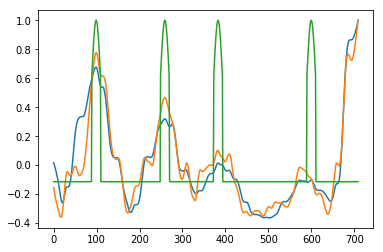

[1, 12991] loss: 0.424


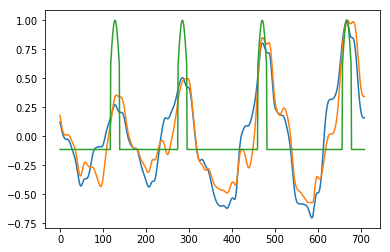

[1, 13021] loss: 0.426


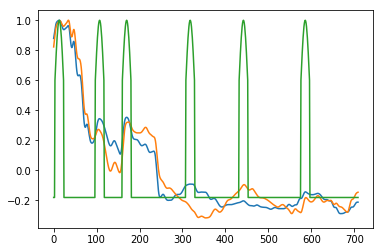

[1, 13051] loss: 0.427


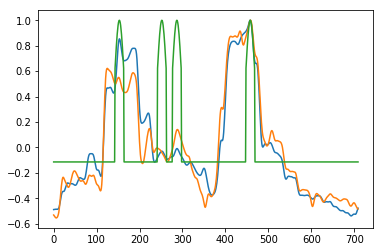

[1, 13081] loss: 0.428


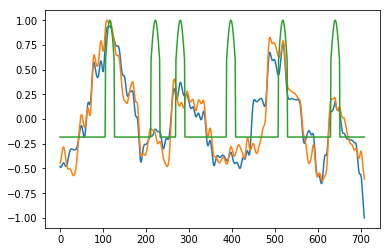

[1, 13111] loss: 0.429


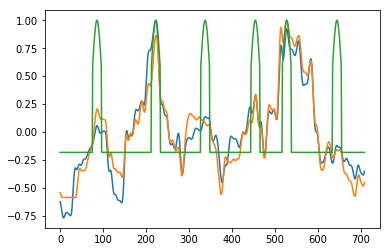

[1, 13141] loss: 0.430


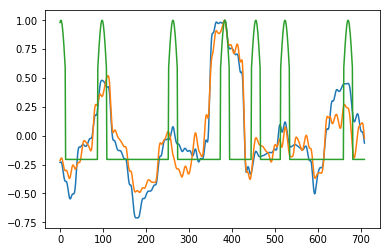

[1, 13171] loss: 0.431


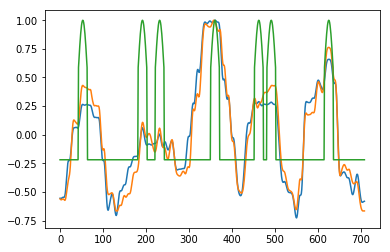

[1, 13201] loss: 0.432


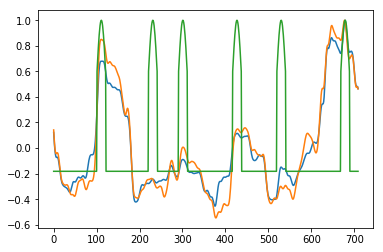

[1, 13231] loss: 0.432


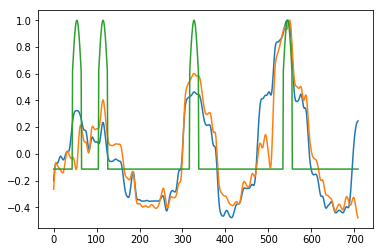

[1, 13261] loss: 0.433


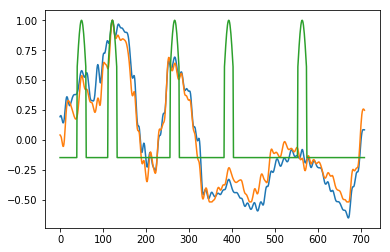

[1, 13291] loss: 0.435


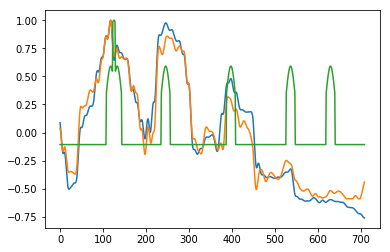

[1, 13321] loss: 0.435


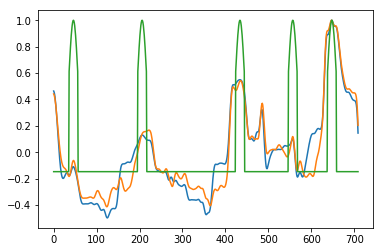

[1, 13351] loss: 0.436


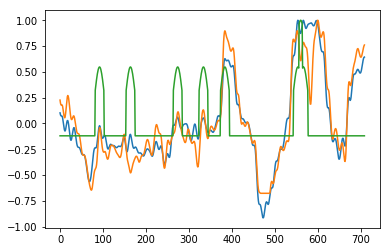

[1, 13381] loss: 0.437


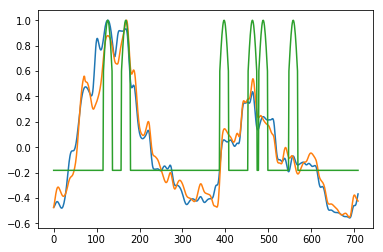

[1, 13411] loss: 0.438


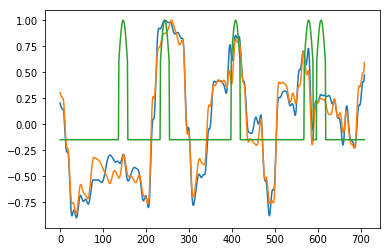

(447,)


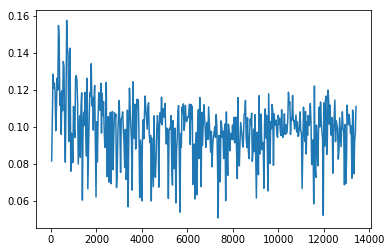

[2,    31] loss: 0.439


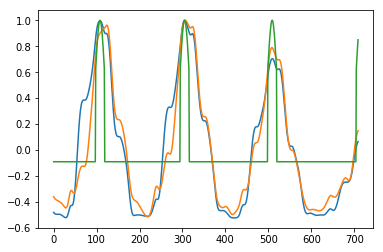

[2,    61] loss: 0.440


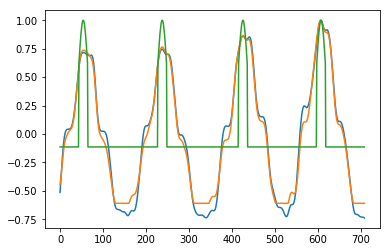

[2,    91] loss: 0.441


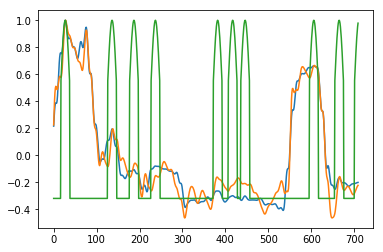

[2,   121] loss: 0.442


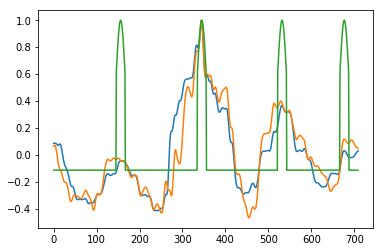

[2,   151] loss: 0.443


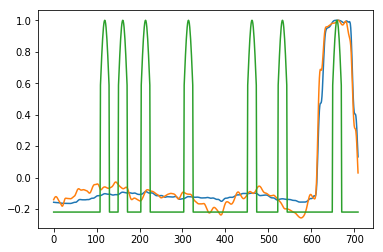

[2,   181] loss: 0.443


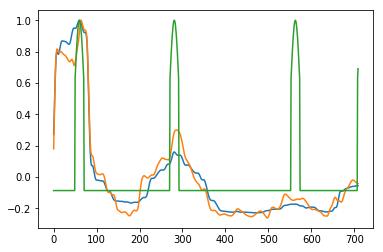

[2,   211] loss: 0.444


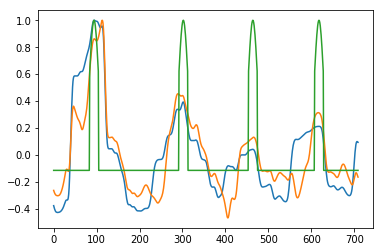

[2,   241] loss: 0.445


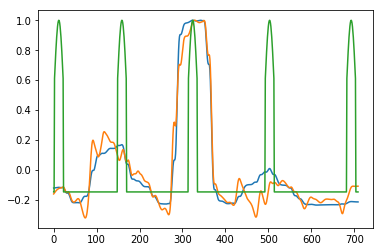

[2,   271] loss: 0.446


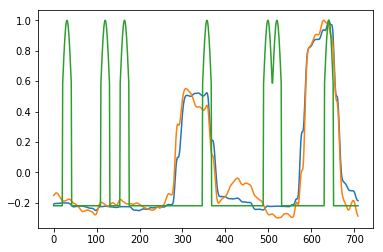

[2,   301] loss: 0.447


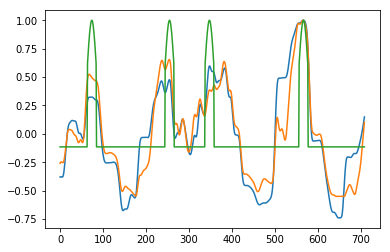

[2,   331] loss: 0.448


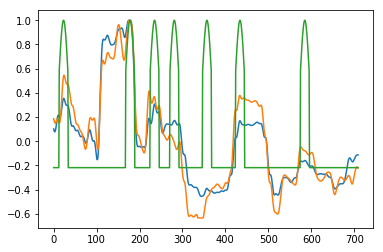

[2,   361] loss: 0.449


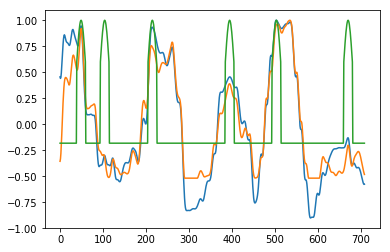

[2,   391] loss: 0.450


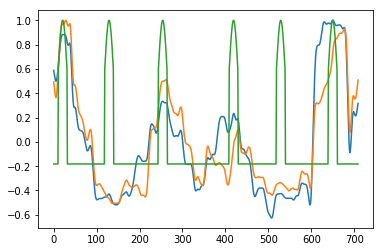

[2,   421] loss: 0.451


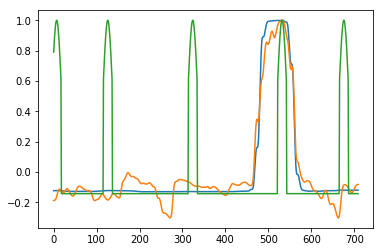

[2,   451] loss: 0.452


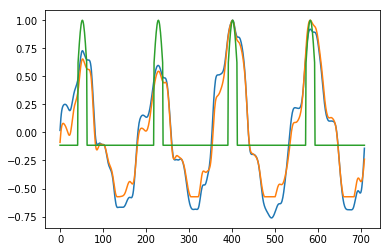

[2,   481] loss: 0.453


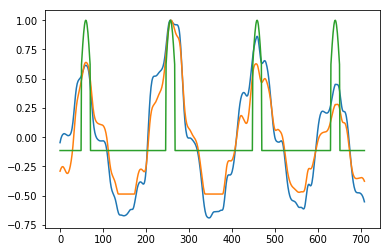

[2,   511] loss: 0.453


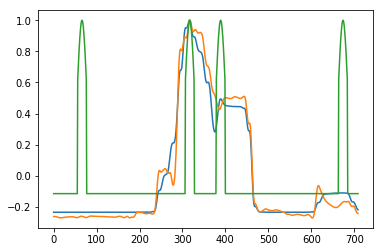

[2,   541] loss: 0.455


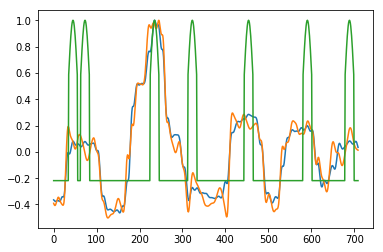

[2,   571] loss: 0.456


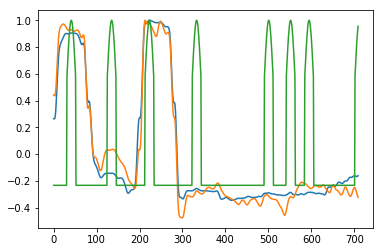

[2,   601] loss: 0.456


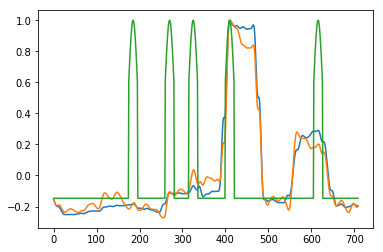

[2,   631] loss: 0.457


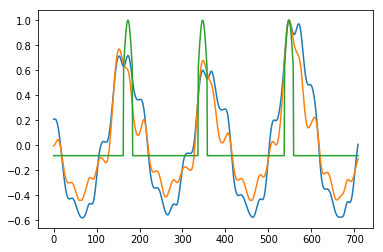

[2,   661] loss: 0.458


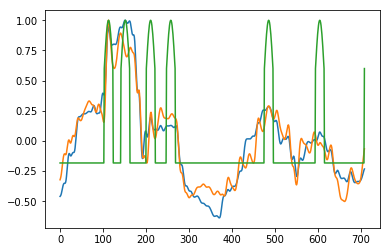

[2,   691] loss: 0.459


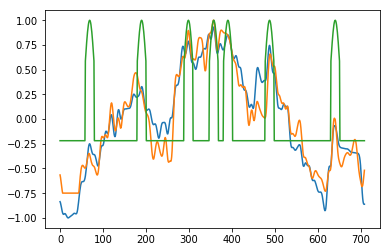

[2,   721] loss: 0.460


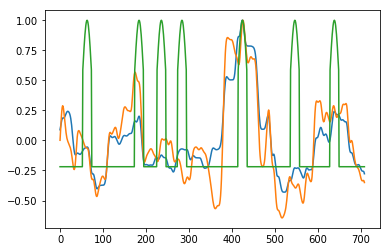

[2,   751] loss: 0.461


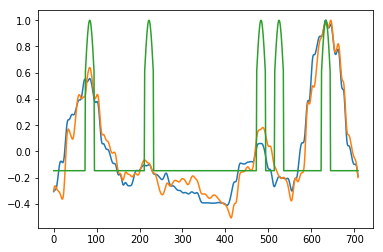

[2,   781] loss: 0.462


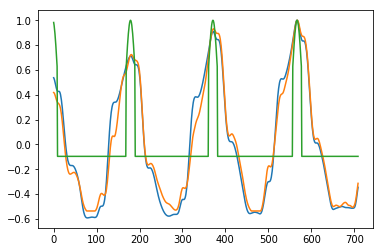

[2,   811] loss: 0.463


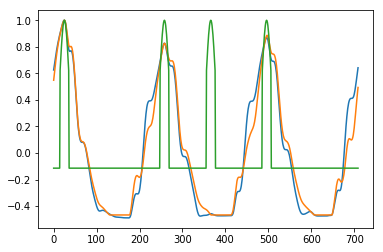

[2,   841] loss: 0.464


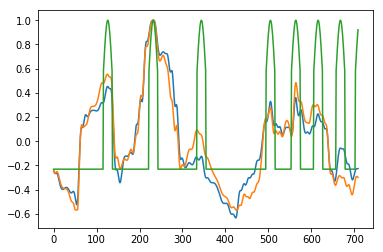

[2,   871] loss: 0.464


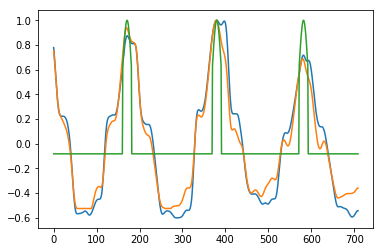

[2,   901] loss: 0.465


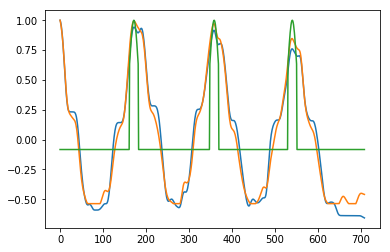

[2,   931] loss: 0.466


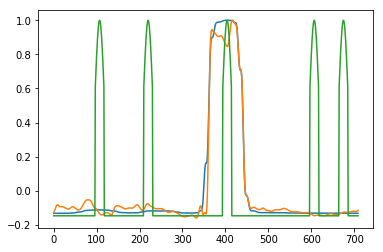

[2,   961] loss: 0.467


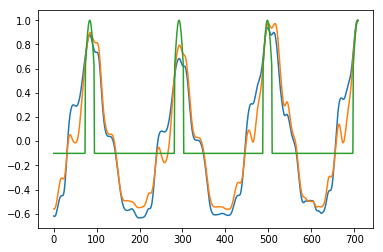

[2,   991] loss: 0.468


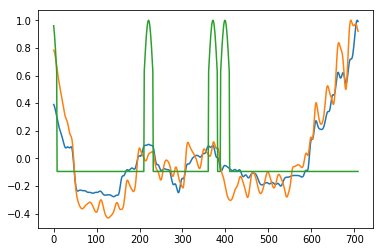

[2,  1021] loss: 0.468


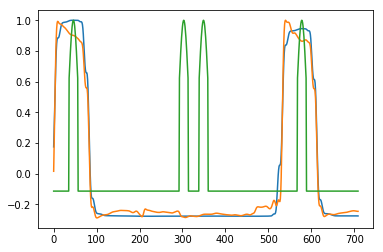

[2,  1051] loss: 0.469


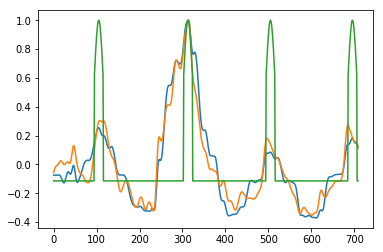

[2,  1081] loss: 0.470


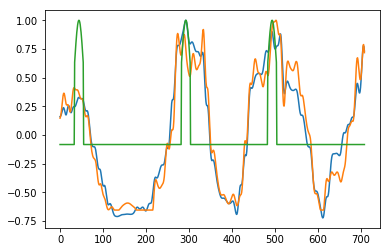

[2,  1111] loss: 0.471


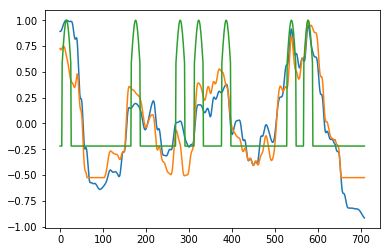

[2,  1141] loss: 0.472


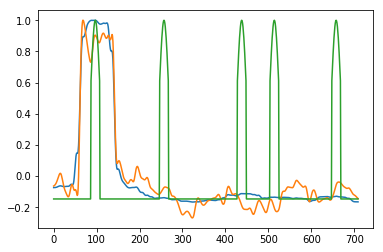

[2,  1171] loss: 0.473


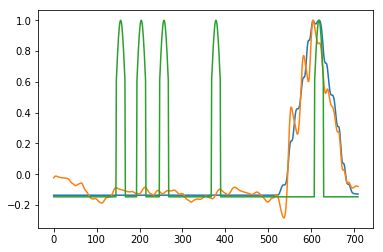

[2,  1201] loss: 0.474


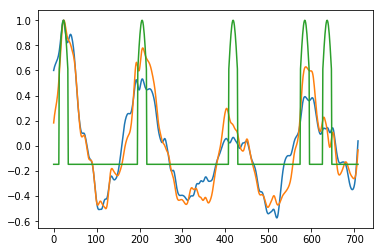

[2,  1231] loss: 0.475


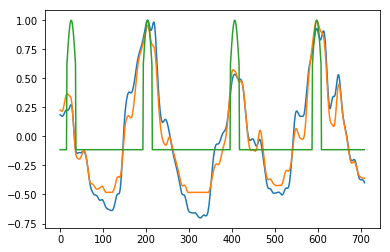

[2,  1261] loss: 0.475


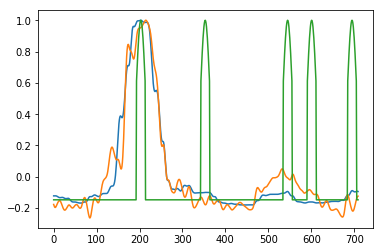

[2,  1291] loss: 0.476


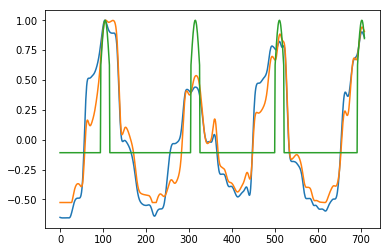

[2,  1321] loss: 0.477


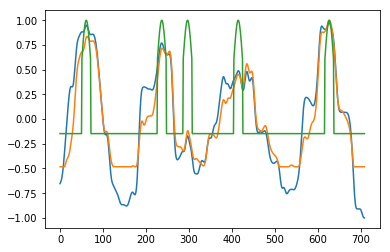

[2,  1351] loss: 0.478


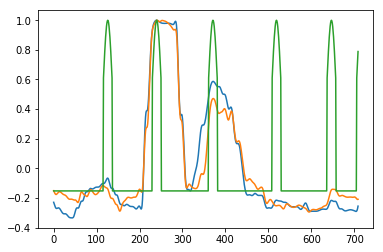

[2,  1381] loss: 0.479


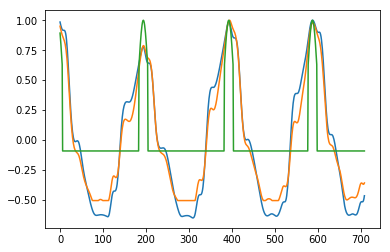

[2,  1411] loss: 0.479


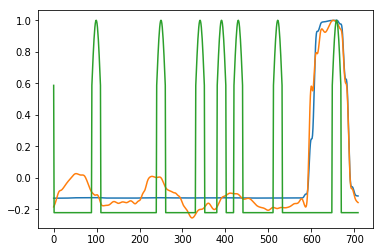

[2,  1441] loss: 0.480


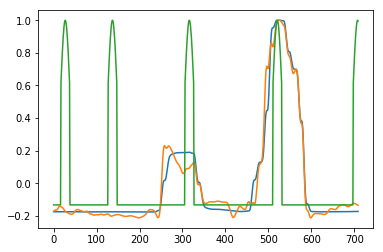

[2,  1471] loss: 0.481


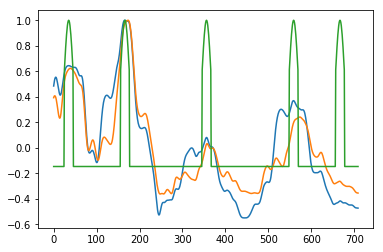

[2,  1501] loss: 0.482


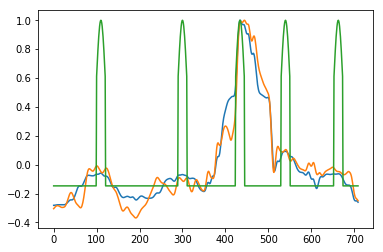

[2,  1531] loss: 0.483


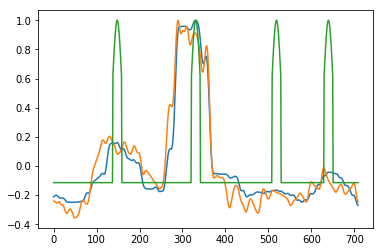

[2,  1561] loss: 0.484


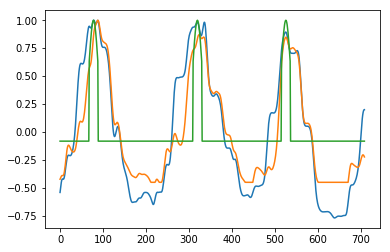

[2,  1591] loss: 0.485


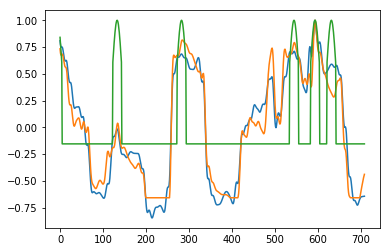

[2,  1621] loss: 0.485


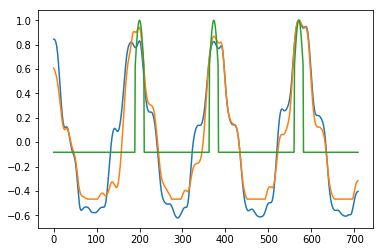

[2,  1651] loss: 0.486


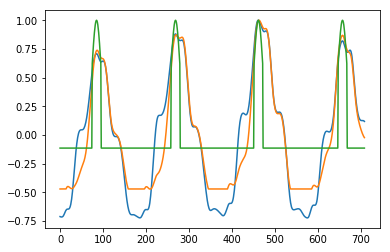

[2,  1681] loss: 0.487


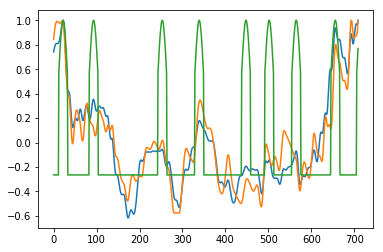

[2,  1711] loss: 0.488


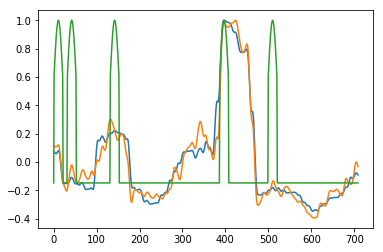

[2,  1741] loss: 0.489


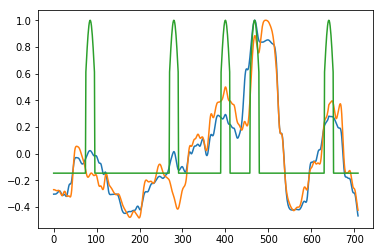

[2,  1771] loss: 0.490


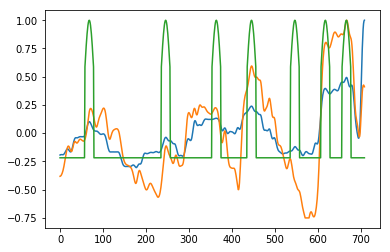

[2,  1801] loss: 0.491


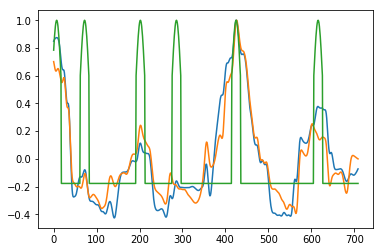

[2,  1831] loss: 0.492


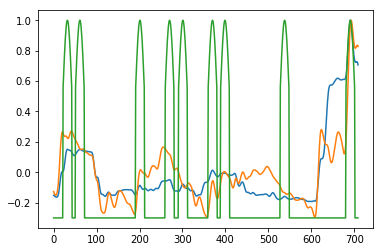

[2,  1861] loss: 0.493


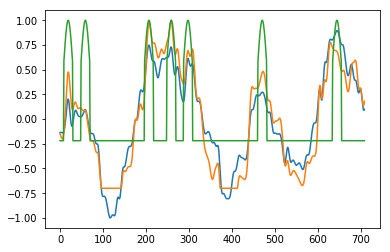

[2,  1891] loss: 0.494


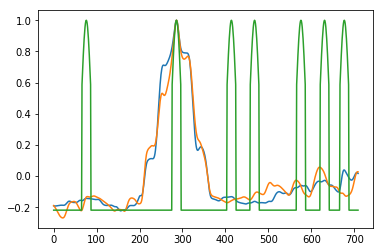

[2,  1921] loss: 0.495


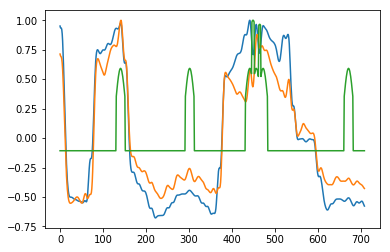

[2,  1951] loss: 0.496


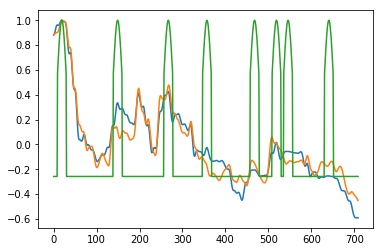

[2,  1981] loss: 0.497


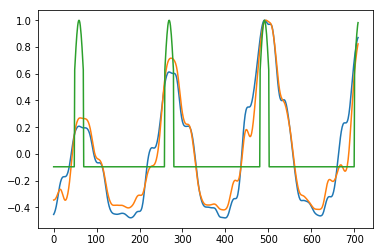

[2,  2011] loss: 0.498


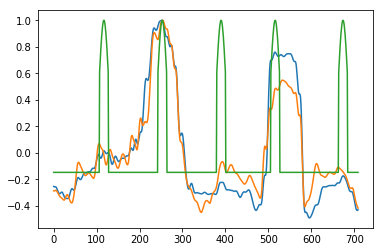

[2,  2041] loss: 0.498


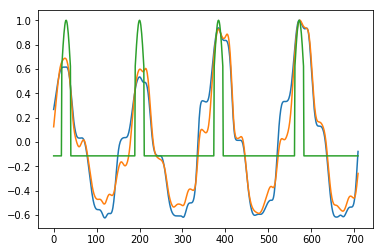

[2,  2071] loss: 0.499


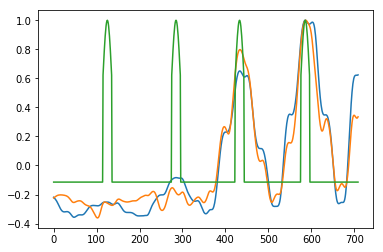

[2,  2101] loss: 0.500


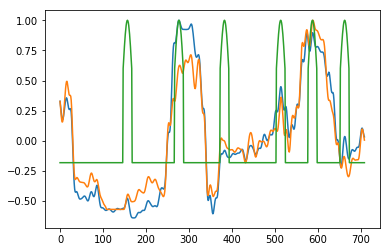

[2,  2131] loss: 0.501


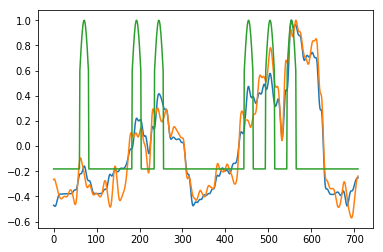

[2,  2161] loss: 0.502


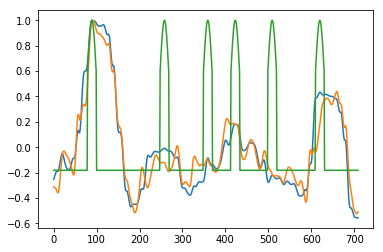

[2,  2191] loss: 0.503


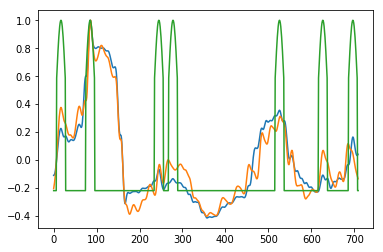

[2,  2221] loss: 0.504


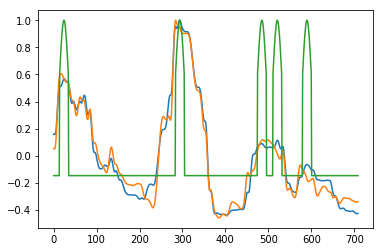

[2,  2251] loss: 0.505


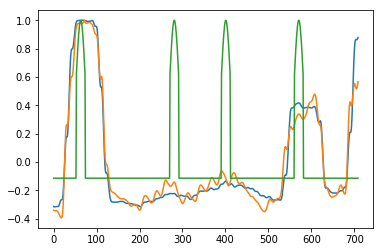

[2,  2281] loss: 0.506


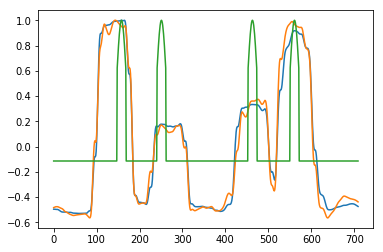

[2,  2311] loss: 0.508


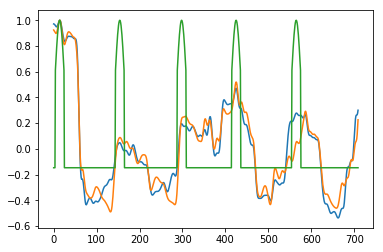

[2,  2341] loss: 0.508


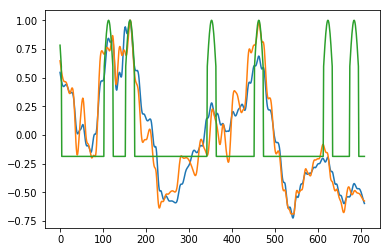

[2,  2371] loss: 0.509


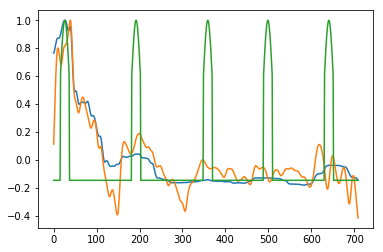

[2,  2401] loss: 0.510


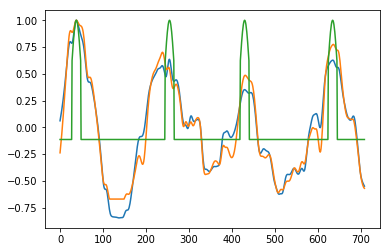

[2,  2431] loss: 0.511


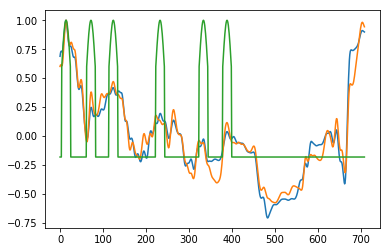

[2,  2461] loss: 0.512


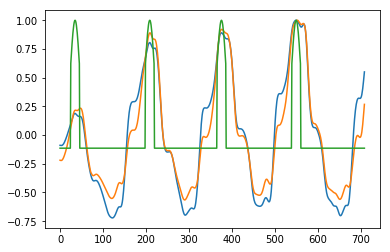

[2,  2491] loss: 0.513


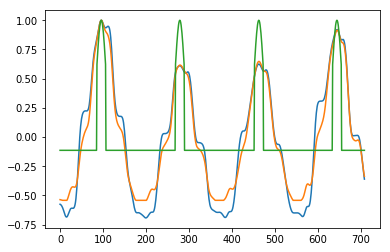

[2,  2521] loss: 0.514


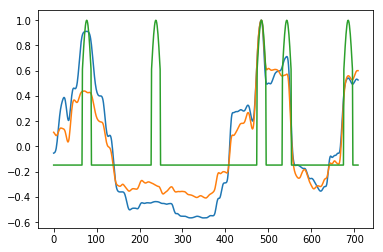

[2,  2551] loss: 0.514


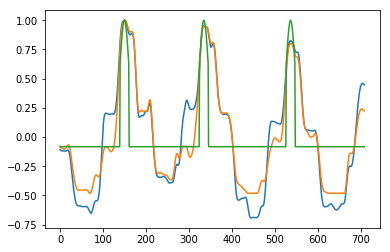

[2,  2581] loss: 0.515


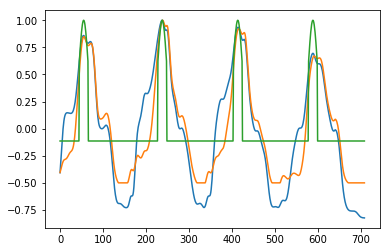

[2,  2611] loss: 0.516


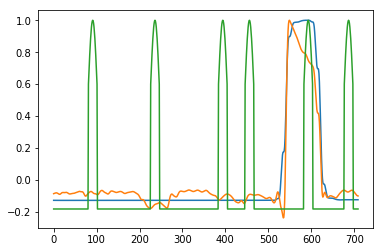

[2,  2641] loss: 0.517


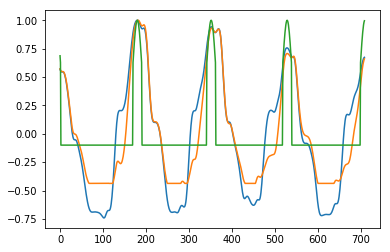

[2,  2671] loss: 0.518


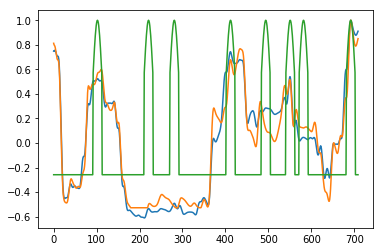

[2,  2701] loss: 0.519


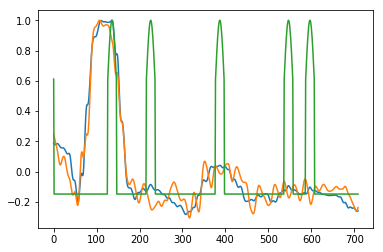

[2,  2731] loss: 0.519


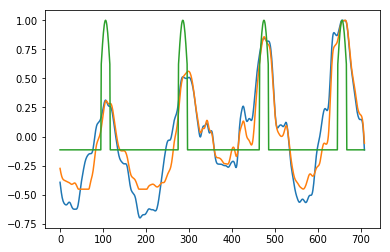

[2,  2761] loss: 0.520


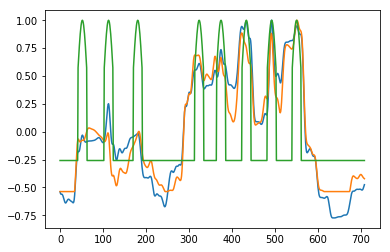

[2,  2791] loss: 0.521


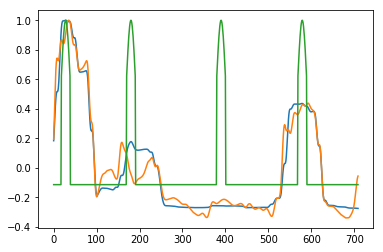

[2,  2821] loss: 0.522


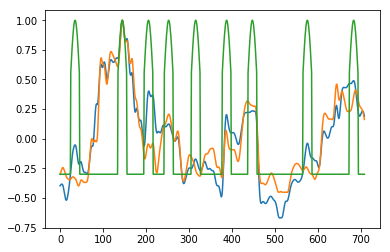

[2,  2851] loss: 0.523


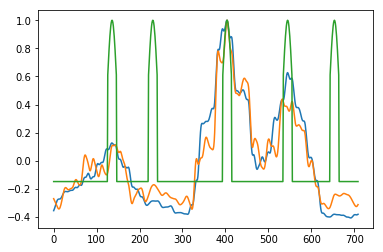

[2,  2881] loss: 0.524


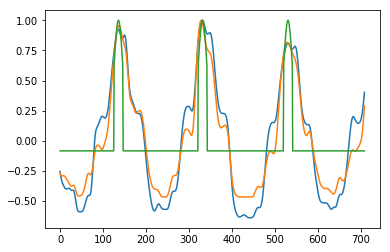

[2,  2911] loss: 0.525


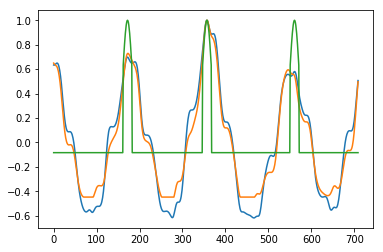

[2,  2941] loss: 0.526


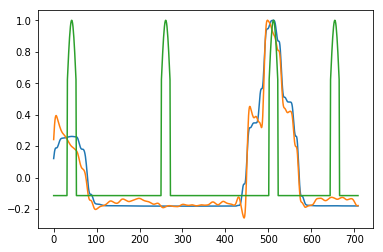

[2,  2971] loss: 0.527


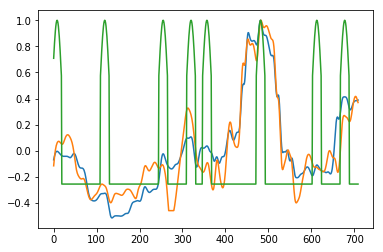

[2,  3001] loss: 0.528


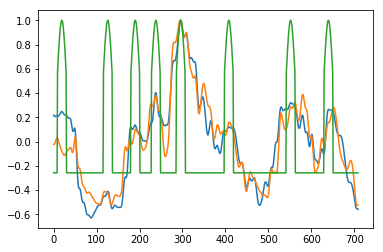

[2,  3031] loss: 0.529


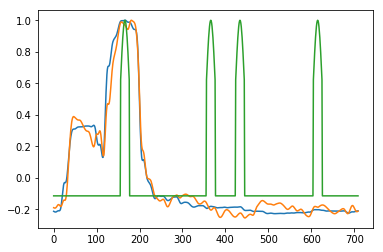

[2,  3061] loss: 0.529


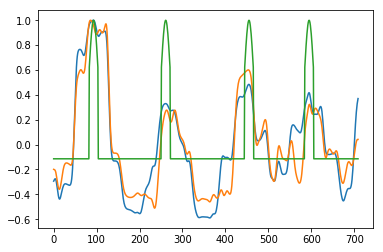

[2,  3091] loss: 0.530


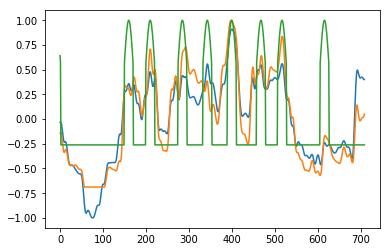

[2,  3121] loss: 0.531


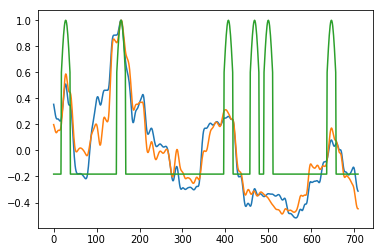

[2,  3151] loss: 0.532


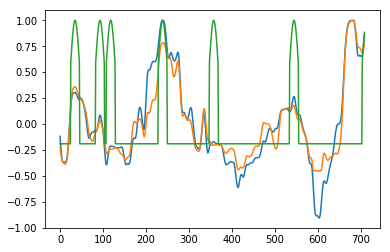

[2,  3181] loss: 0.533


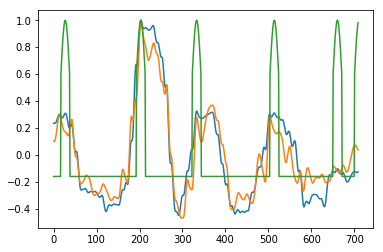

[2,  3211] loss: 0.534


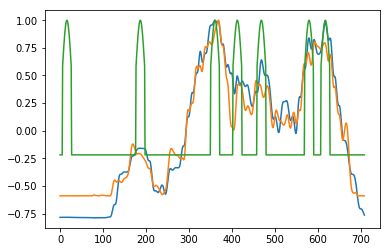

[2,  3241] loss: 0.535


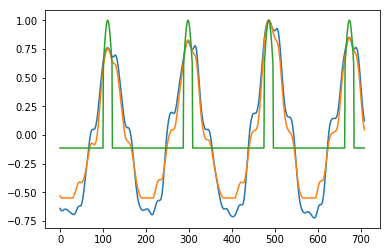

[2,  3271] loss: 0.536


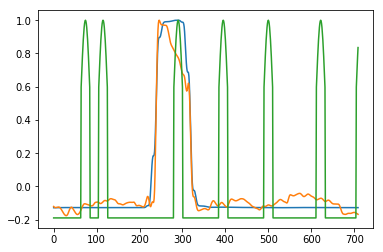

[2,  3301] loss: 0.537


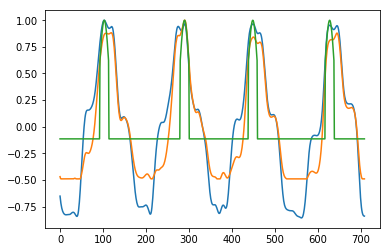

[2,  3331] loss: 0.537


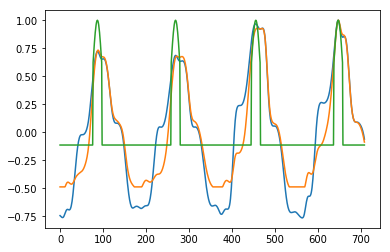

[2,  3361] loss: 0.538


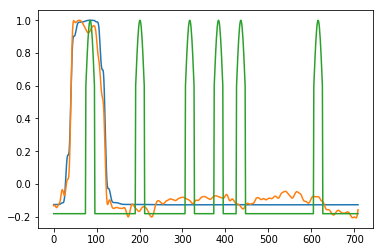

[2,  3391] loss: 0.539


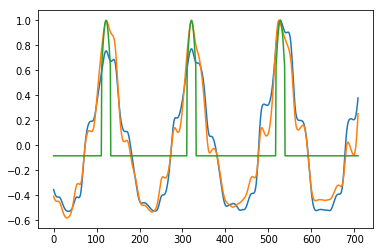

[2,  3421] loss: 0.540


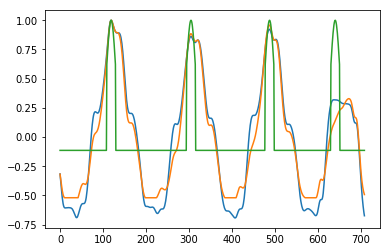

[2,  3451] loss: 0.541


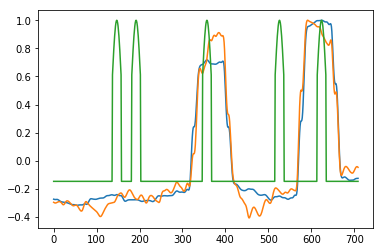

[2,  3481] loss: 0.542


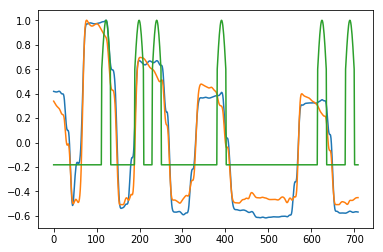

[2,  3511] loss: 0.543


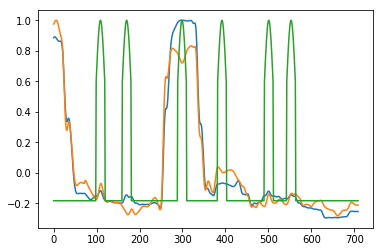

[2,  3541] loss: 0.544


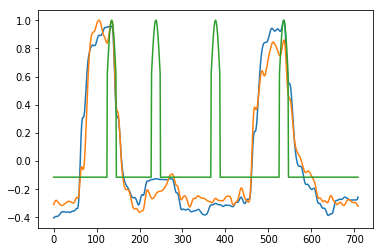

[2,  3571] loss: 0.544


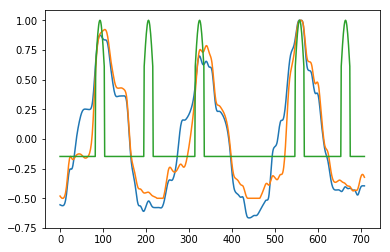

[2,  3601] loss: 0.546


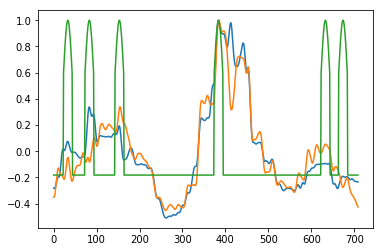

[2,  3631] loss: 0.547


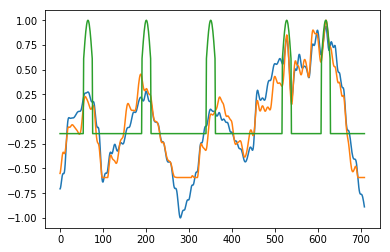

[2,  3661] loss: 0.548


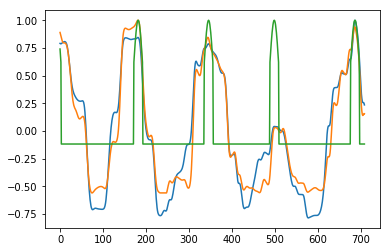

[2,  3691] loss: 0.549


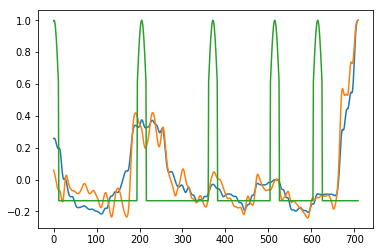

[2,  3721] loss: 0.549


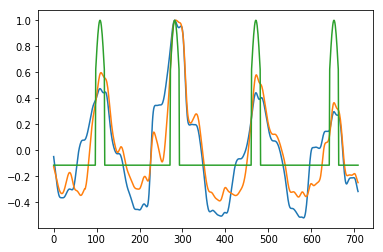

[2,  3751] loss: 0.550


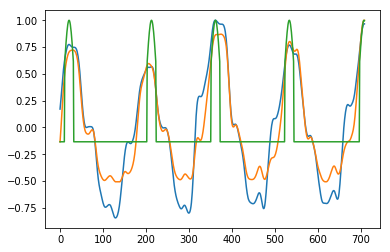

[2,  3781] loss: 0.551


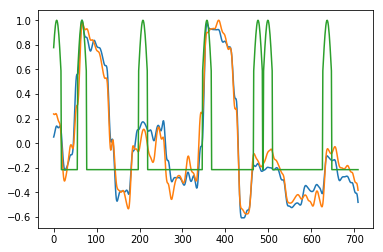

[2,  3811] loss: 0.553


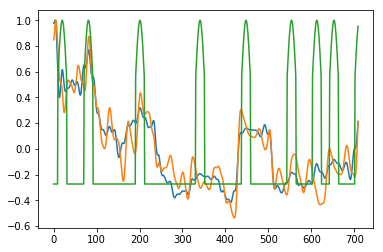

[2,  3841] loss: 0.554


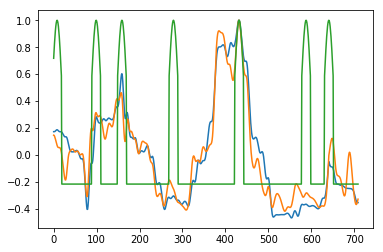

[2,  3871] loss: 0.555


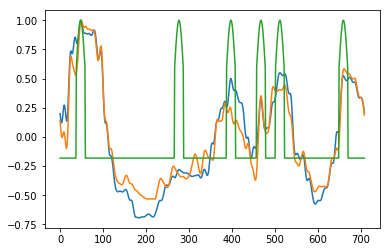

[2,  3901] loss: 0.555


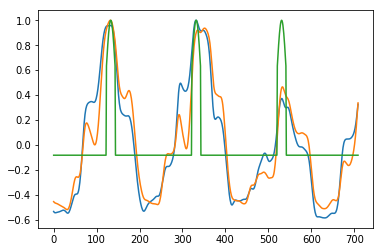

[2,  3931] loss: 0.556


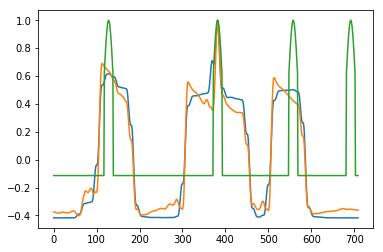

[2,  3961] loss: 0.557


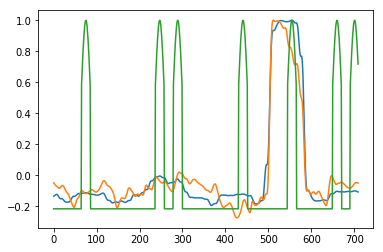

[2,  3991] loss: 0.557


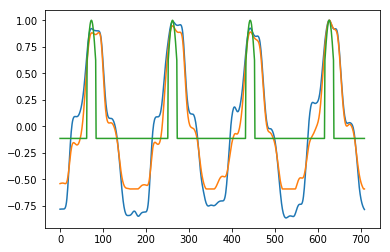

[2,  4021] loss: 0.558


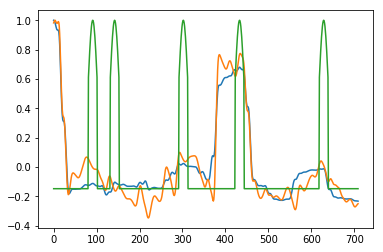

[2,  4051] loss: 0.559


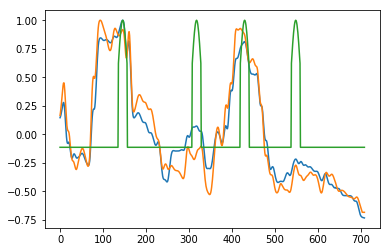

[2,  4081] loss: 0.560


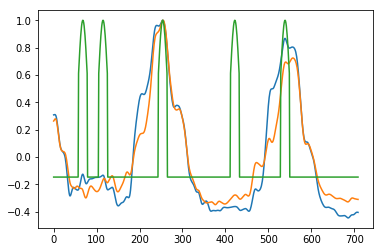

[2,  4111] loss: 0.561


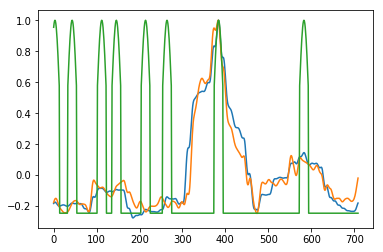

[2,  4141] loss: 0.562


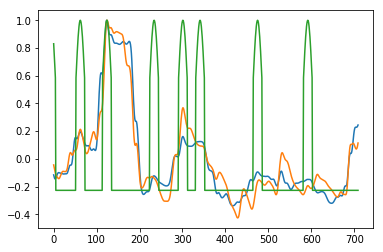

[2,  4171] loss: 0.563


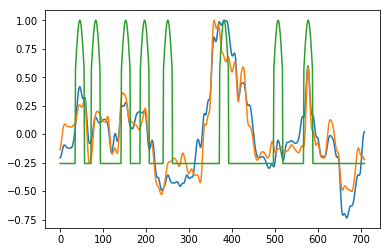

[2,  4201] loss: 0.564


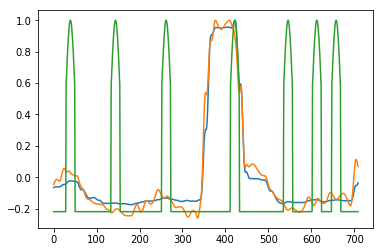

[2,  4231] loss: 0.565


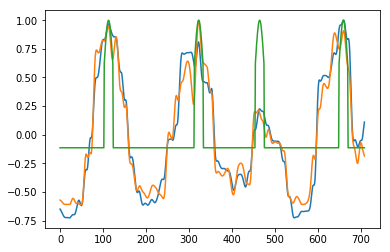

[2,  4261] loss: 0.566


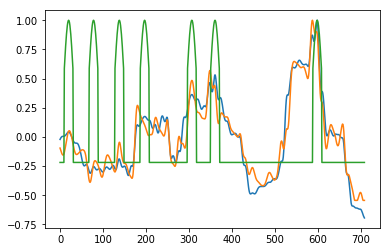

[2,  4291] loss: 0.568


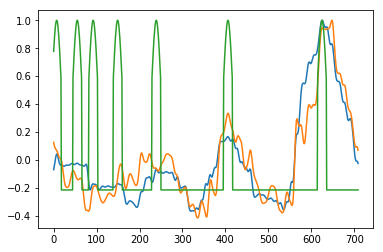

[2,  4321] loss: 0.568


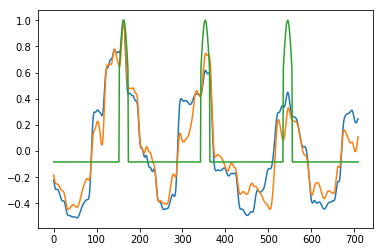

[2,  4351] loss: 0.569


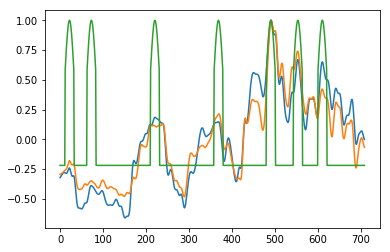

[2,  4381] loss: 0.570


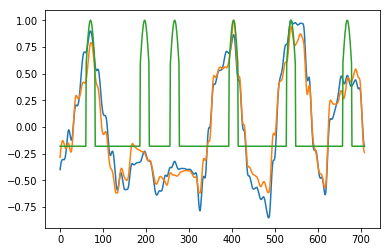

[2,  4411] loss: 0.571


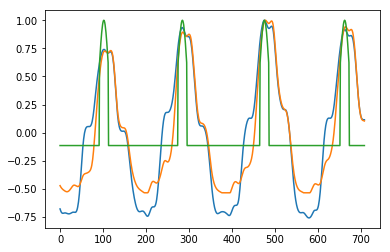

[2,  4441] loss: 0.572


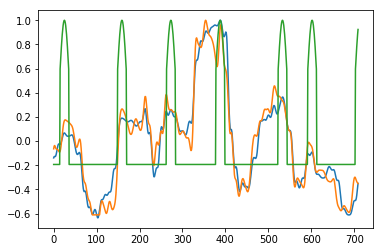

[2,  4471] loss: 0.572


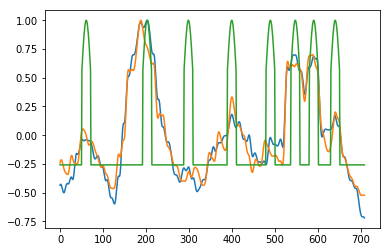

[2,  4501] loss: 0.573


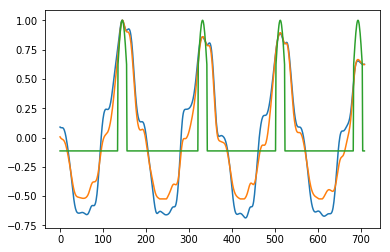

[2,  4531] loss: 0.574


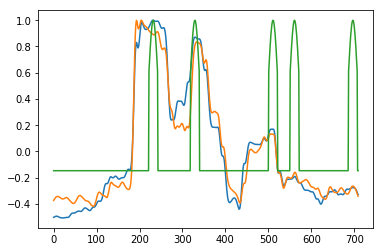

[2,  4561] loss: 0.575


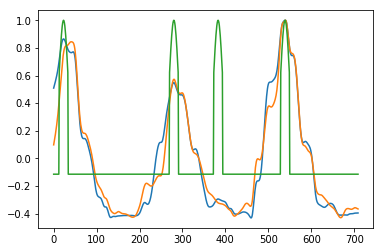

[2,  4591] loss: 0.575


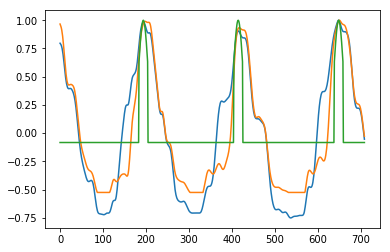

[2,  4621] loss: 0.576


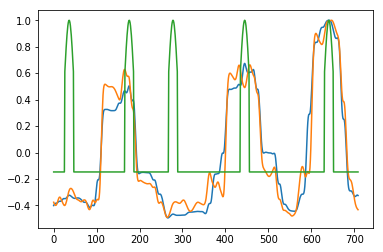

[2,  4651] loss: 0.577


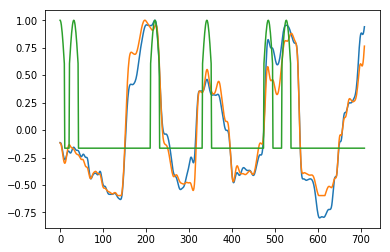

[2,  4681] loss: 0.578


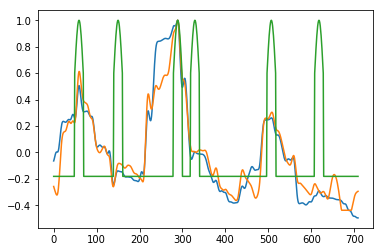

[2,  4711] loss: 0.579


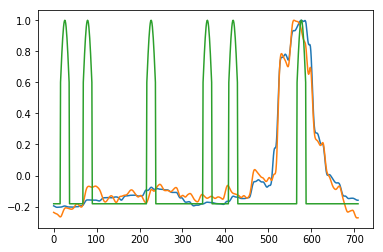

[2,  4741] loss: 0.580


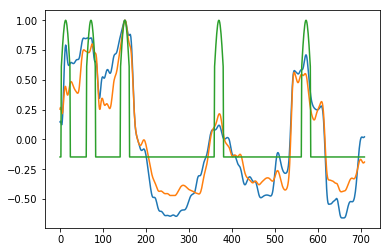

[2,  4771] loss: 0.581


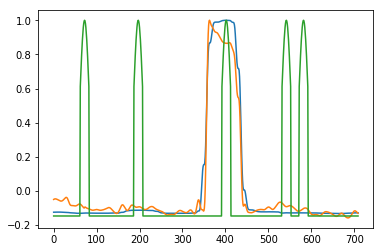

[2,  4801] loss: 0.582


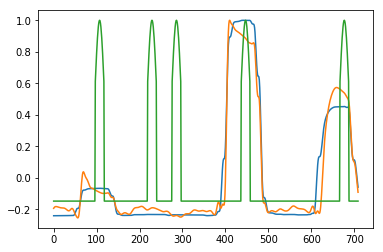

[2,  4831] loss: 0.583


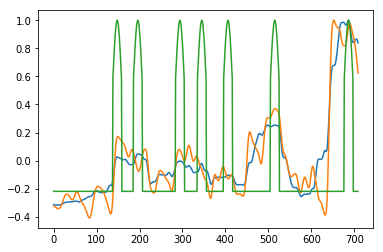

[2,  4861] loss: 0.584


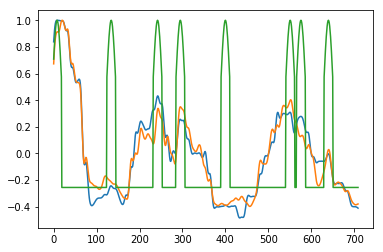

[2,  4891] loss: 0.585


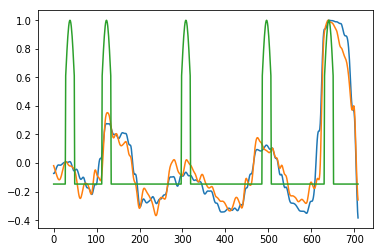

[2,  4921] loss: 0.586


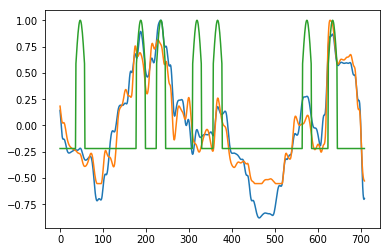

[2,  4951] loss: 0.587


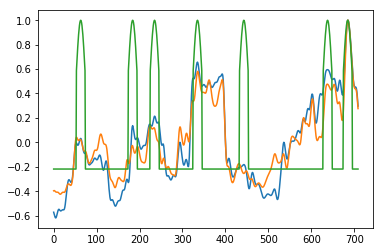

[2,  4981] loss: 0.588


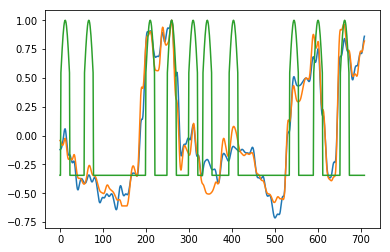

[2,  5011] loss: 0.589


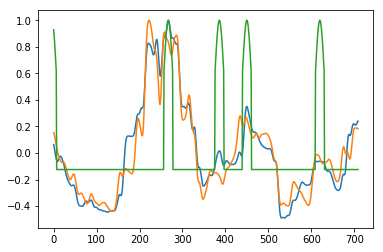

[2,  5041] loss: 0.590


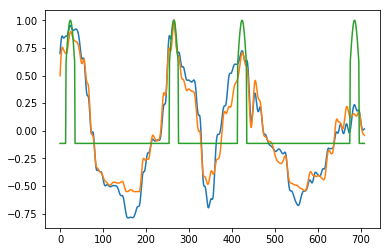

[2,  5071] loss: 0.591


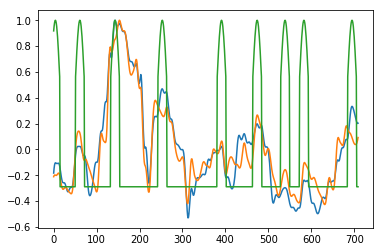

[2,  5101] loss: 0.592


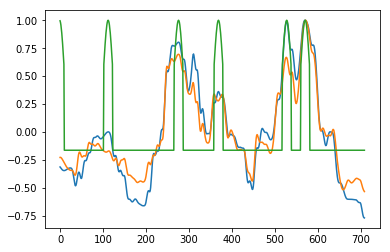

[2,  5131] loss: 0.593


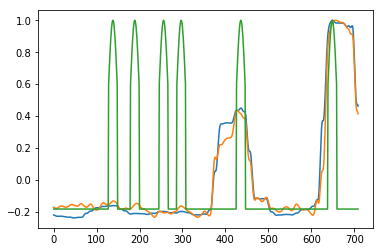

[2,  5161] loss: 0.594


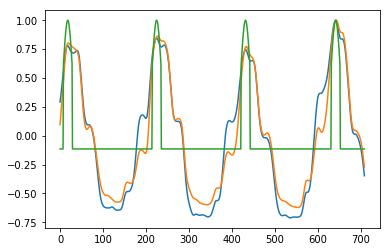

[2,  5191] loss: 0.595


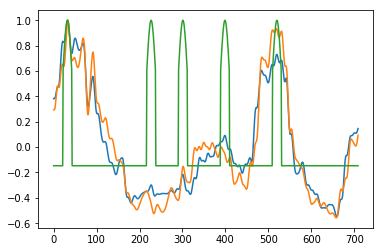

[2,  5221] loss: 0.596


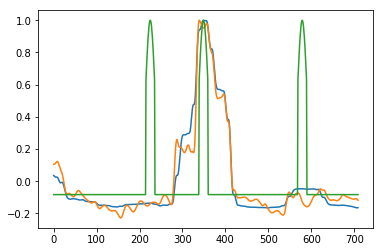

[2,  5251] loss: 0.597


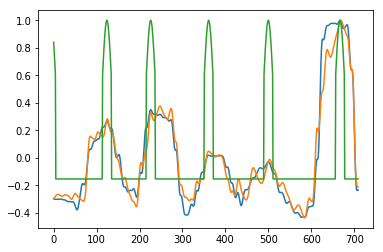

[2,  5281] loss: 0.598


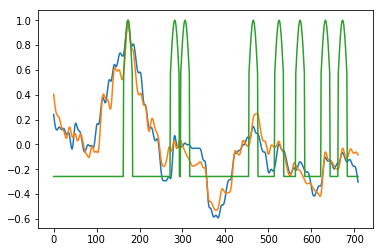

[2,  5311] loss: 0.599


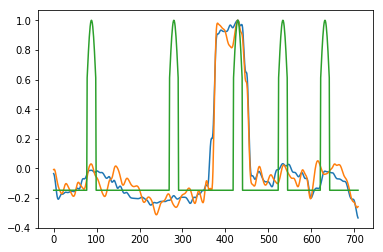

[2,  5341] loss: 0.599


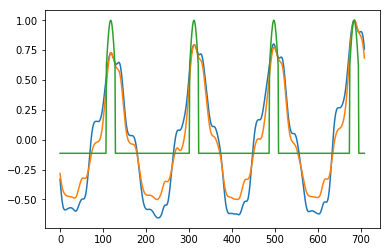

[2,  5371] loss: 0.600


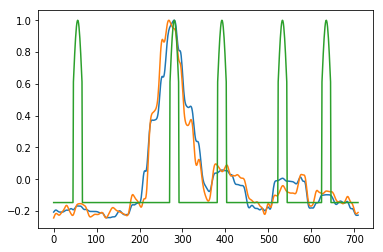

[2,  5401] loss: 0.601


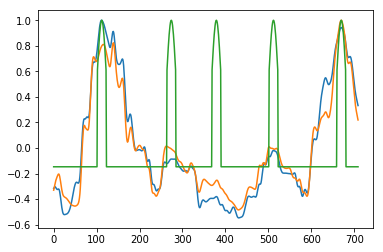

[2,  5431] loss: 0.602


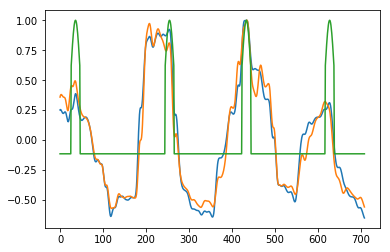

[2,  5461] loss: 0.603


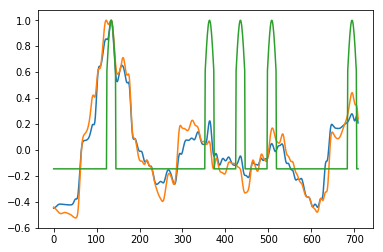

[2,  5491] loss: 0.603


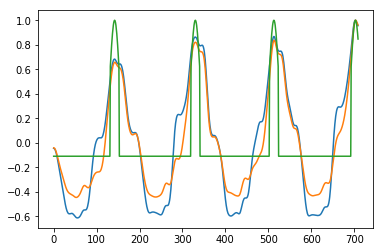

[2,  5521] loss: 0.604


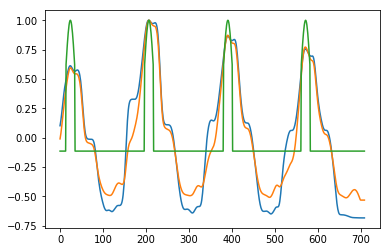

[2,  5551] loss: 0.605


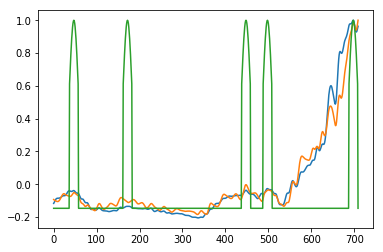

[2,  5581] loss: 0.606


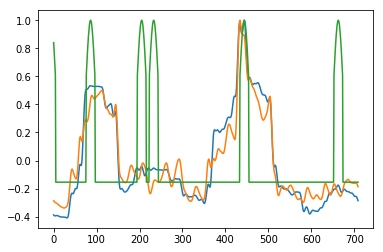

[2,  5611] loss: 0.607


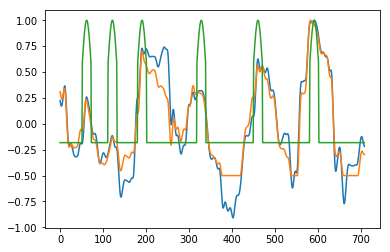

[2,  5641] loss: 0.608


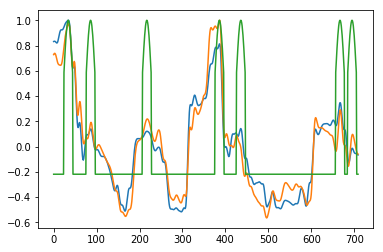

[2,  5671] loss: 0.609


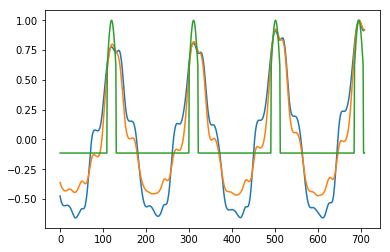

[2,  5701] loss: 0.610


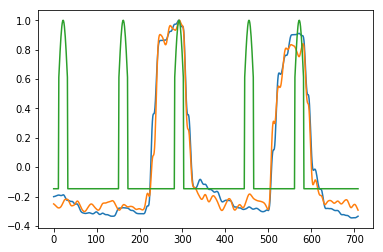

[2,  5731] loss: 0.610


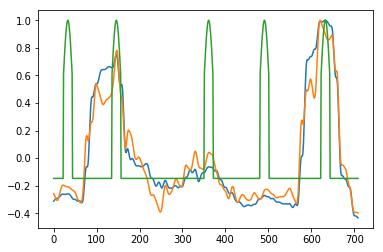

[2,  5761] loss: 0.612


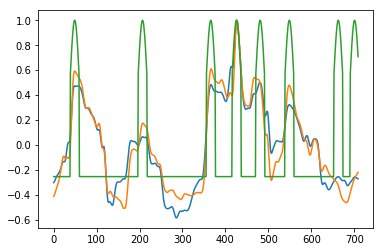

[2,  5791] loss: 0.613


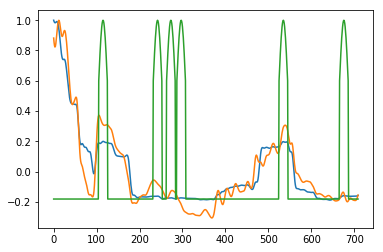

[2,  5821] loss: 0.614


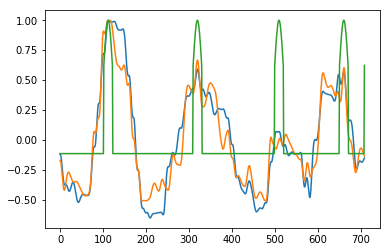

[2,  5851] loss: 0.615


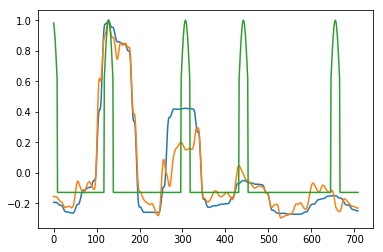

[2,  5881] loss: 0.616


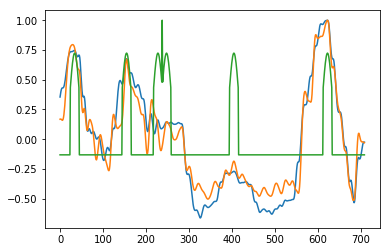

[2,  5911] loss: 0.617


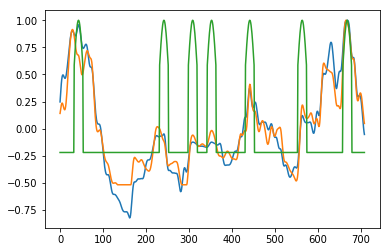

[2,  5941] loss: 0.618


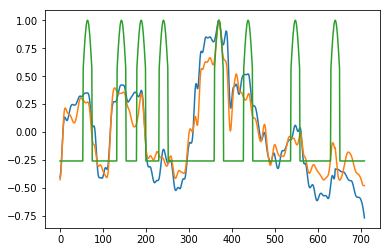

[2,  5971] loss: 0.619


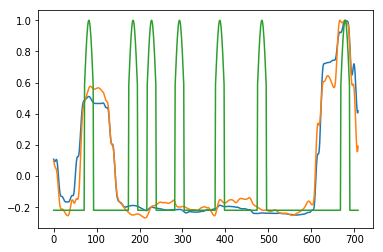

[2,  6001] loss: 0.620


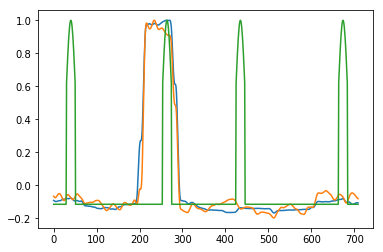

[2,  6031] loss: 0.621


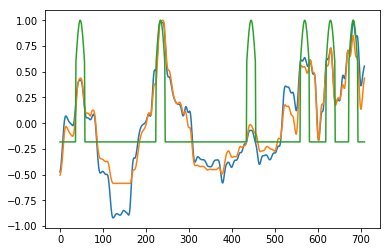

[2,  6061] loss: 0.622


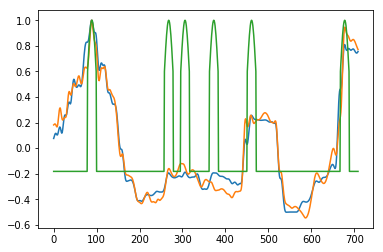

[2,  6091] loss: 0.623


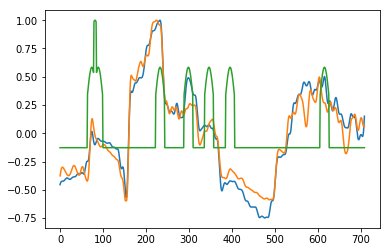

[2,  6121] loss: 0.624


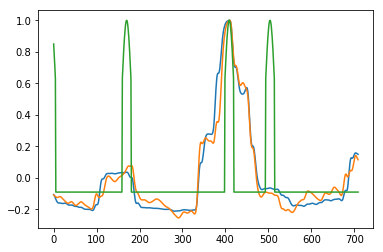

[2,  6151] loss: 0.625


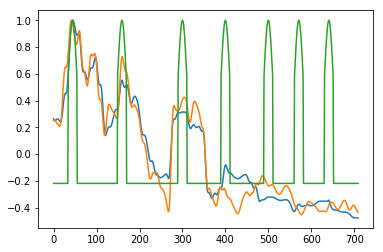

[2,  6181] loss: 0.626


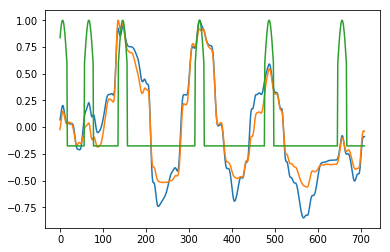

[2,  6211] loss: 0.627


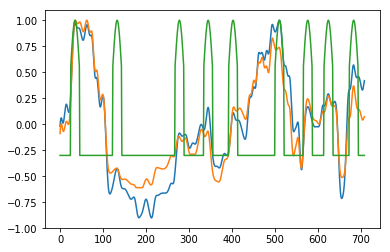

[2,  6241] loss: 0.628


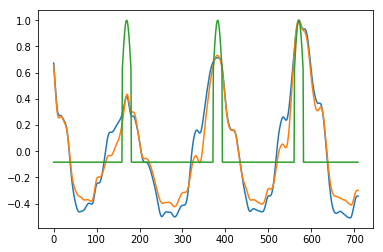

[2,  6271] loss: 0.629


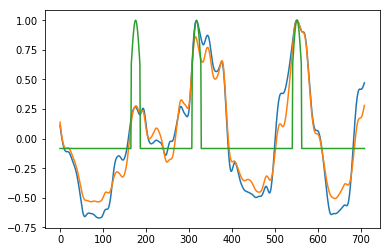

[2,  6301] loss: 0.630


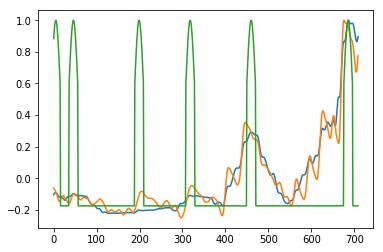

[2,  6331] loss: 0.630


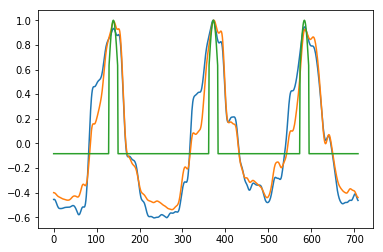

[2,  6361] loss: 0.631


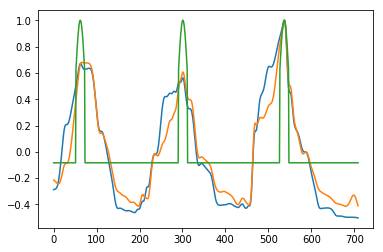

[2,  6391] loss: 0.632


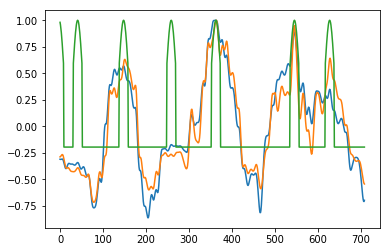

[2,  6421] loss: 0.633


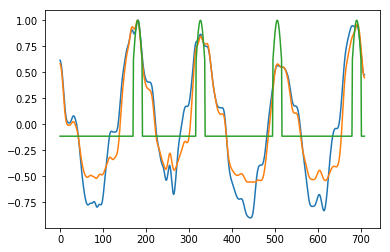

[2,  6451] loss: 0.634


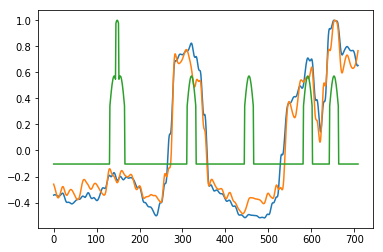

[2,  6481] loss: 0.635


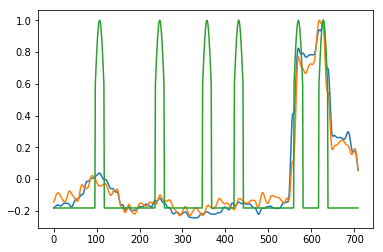

[2,  6511] loss: 0.635


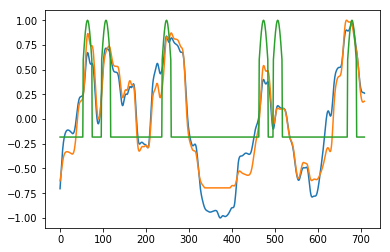

[2,  6541] loss: 0.637


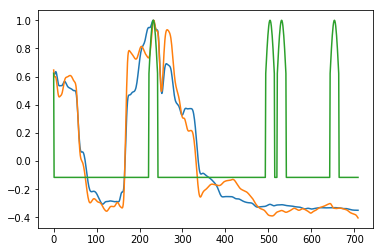

[2,  6571] loss: 0.637


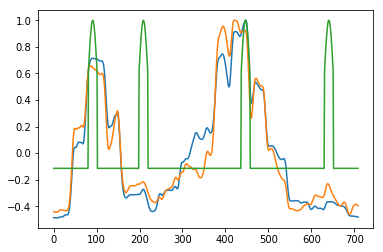

[2,  6601] loss: 0.638


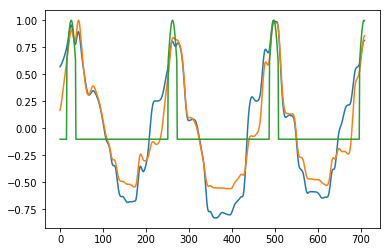

[2,  6631] loss: 0.639


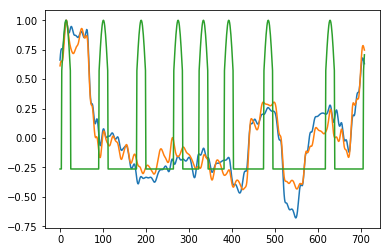

[2,  6661] loss: 0.640


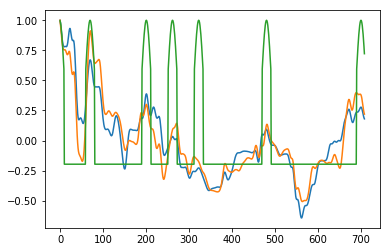

[2,  6691] loss: 0.641


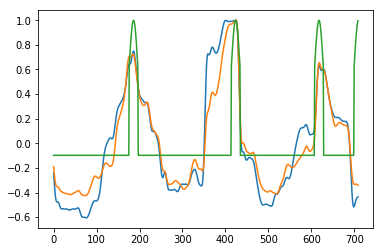

[2,  6721] loss: 0.642


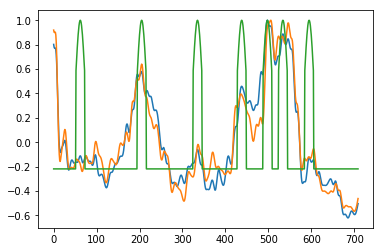

[2,  6751] loss: 0.643


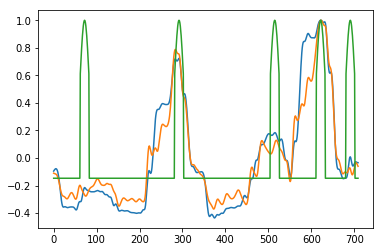

[2,  6781] loss: 0.644


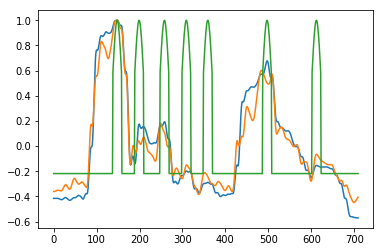

[2,  6811] loss: 0.645


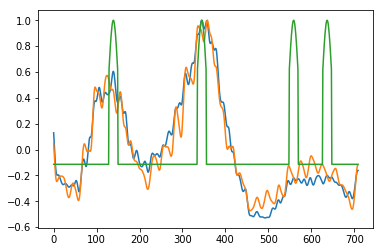

[2,  6841] loss: 0.646


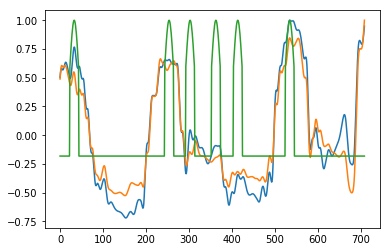

[2,  6871] loss: 0.647


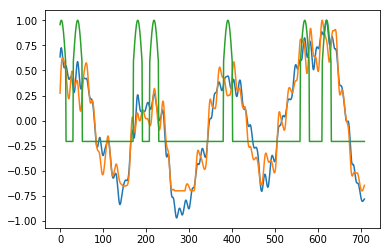

[2,  6901] loss: 0.648


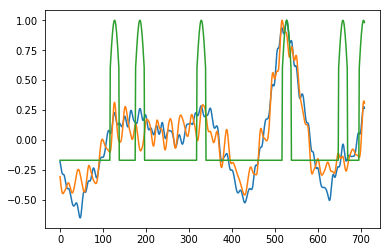

[2,  6931] loss: 0.649


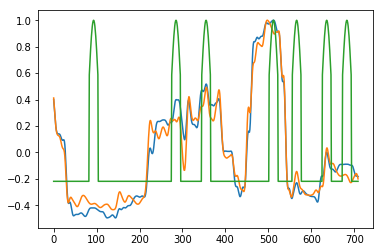

[2,  6961] loss: 0.650


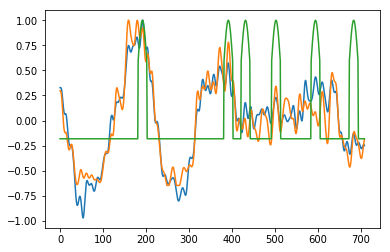

[2,  6991] loss: 0.651


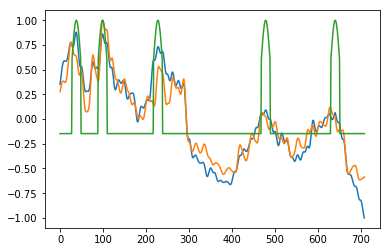

[2,  7021] loss: 0.652


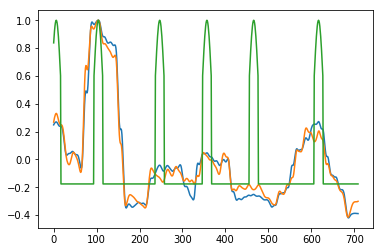

[2,  7051] loss: 0.653


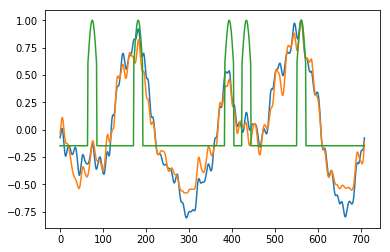

[2,  7081] loss: 0.654


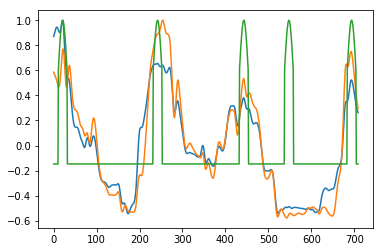

[2,  7111] loss: 0.654


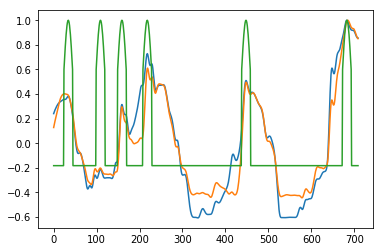

[2,  7141] loss: 0.655


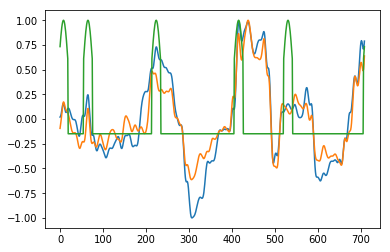

[2,  7171] loss: 0.656


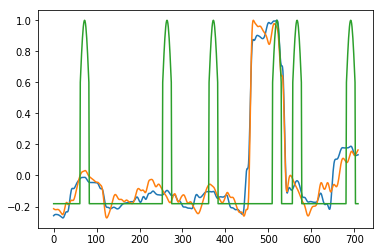

[2,  7201] loss: 0.657


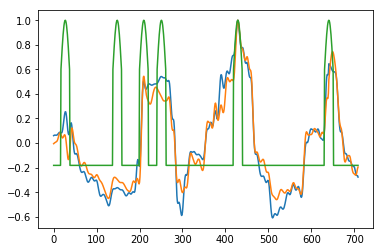

[2,  7231] loss: 0.658


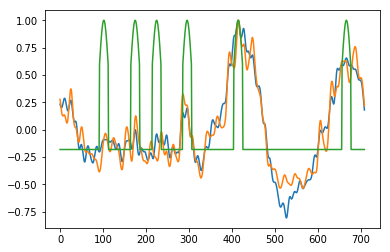

[2,  7261] loss: 0.659


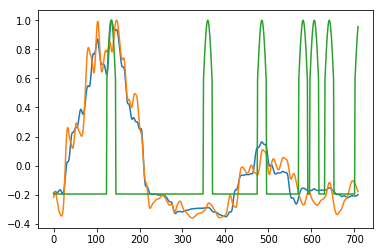

[2,  7291] loss: 0.660


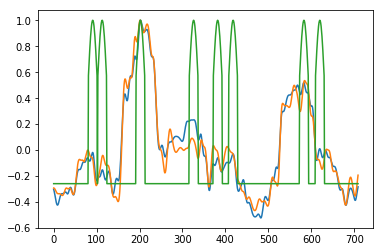

[2,  7321] loss: 0.661


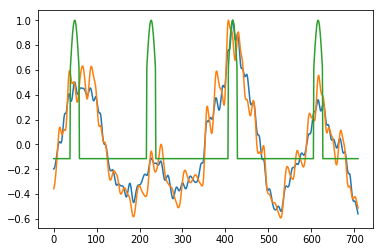

[2,  7351] loss: 0.662


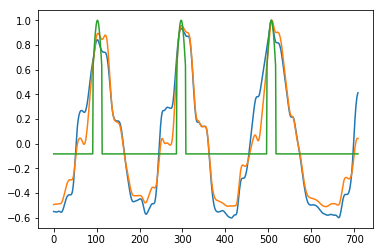

[2,  7381] loss: 0.663


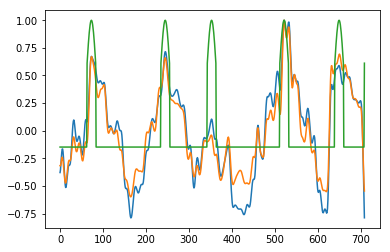

[2,  7411] loss: 0.663


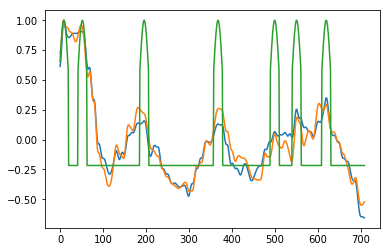

[2,  7441] loss: 0.664


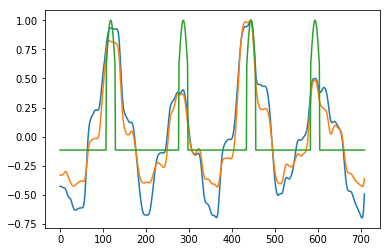

[2,  7471] loss: 0.665


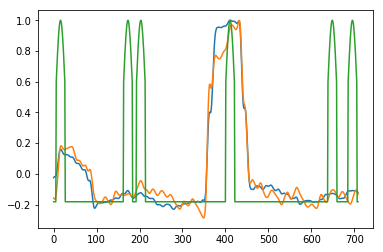

[2,  7501] loss: 0.666


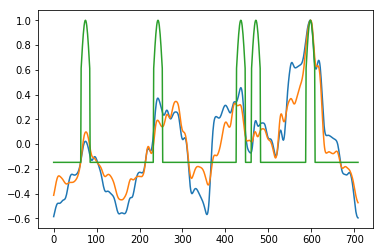

[2,  7531] loss: 0.667


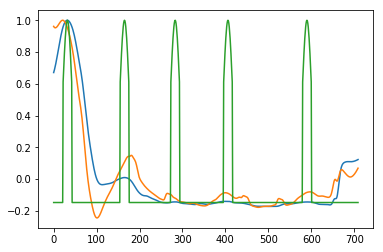

[2,  7561] loss: 0.668


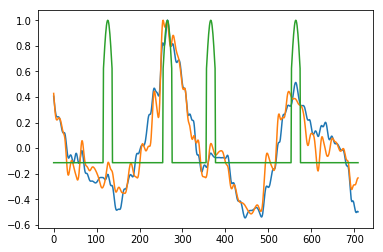

[2,  7591] loss: 0.669


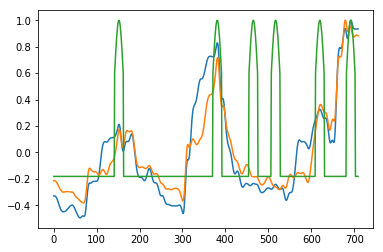

[2,  7621] loss: 0.670


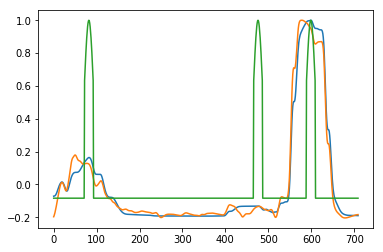

[2,  7651] loss: 0.671


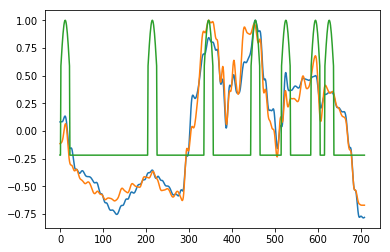

[2,  7681] loss: 0.671


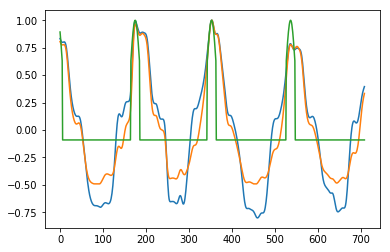

[2,  7711] loss: 0.672


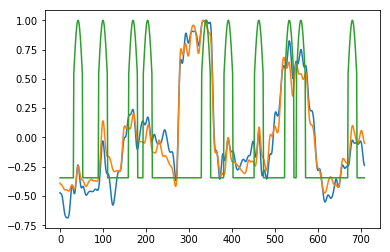

[2,  7741] loss: 0.673


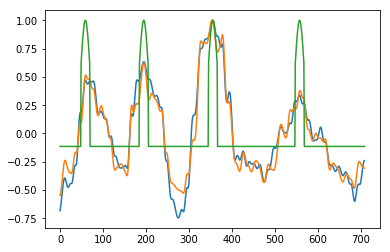

[2,  7771] loss: 0.674


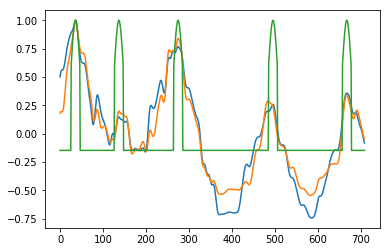

[2,  7801] loss: 0.675


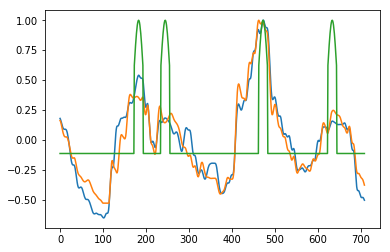

[2,  7831] loss: 0.676


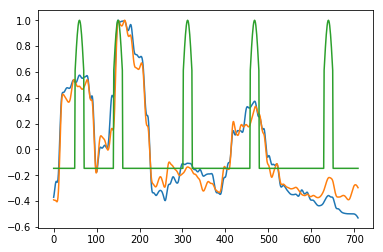

[2,  7861] loss: 0.677


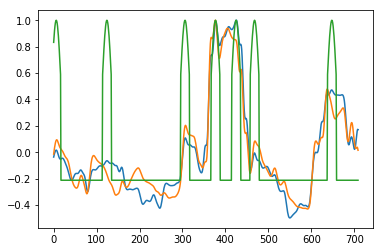

[2,  7891] loss: 0.678


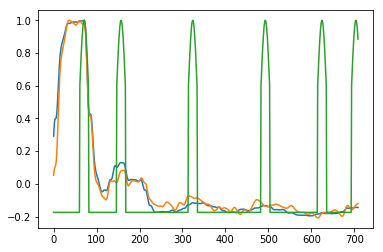

[2,  7921] loss: 0.679


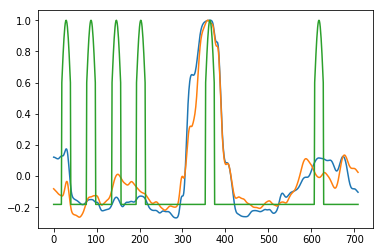

[2,  7951] loss: 0.680


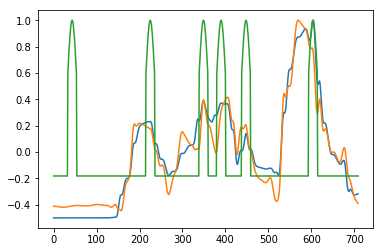

[2,  7981] loss: 0.681


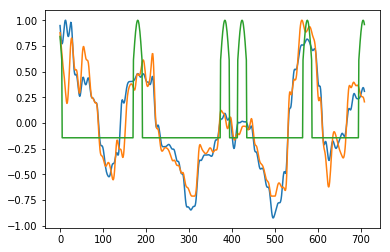

[2,  8011] loss: 0.682


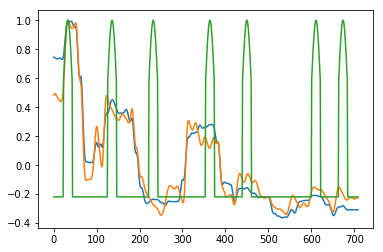

[2,  8041] loss: 0.683


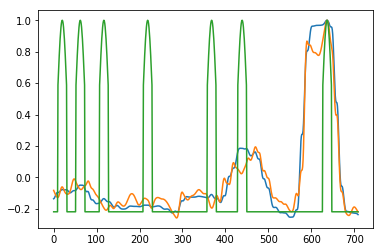

[2,  8071] loss: 0.684


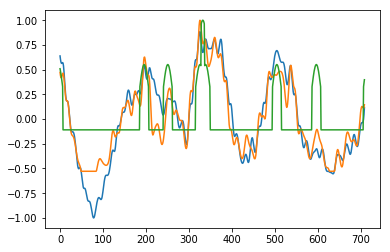

[2,  8101] loss: 0.684


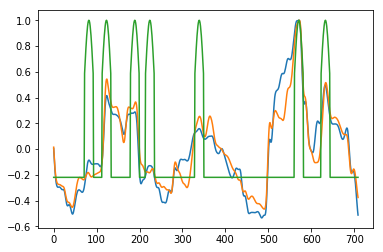

[2,  8131] loss: 0.685


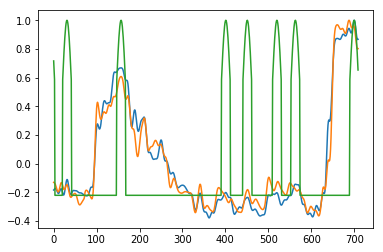

[2,  8161] loss: 0.686


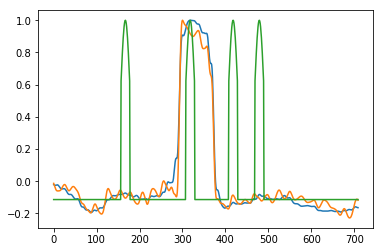

[2,  8191] loss: 0.687


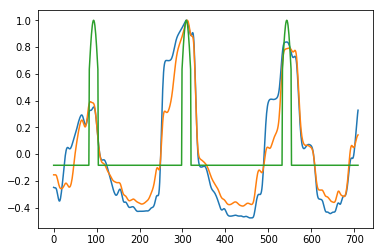

[2,  8221] loss: 0.688


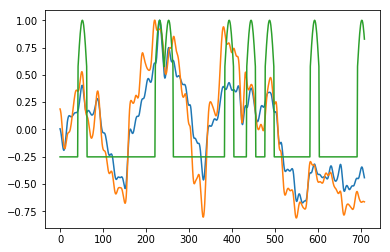

[2,  8251] loss: 0.689


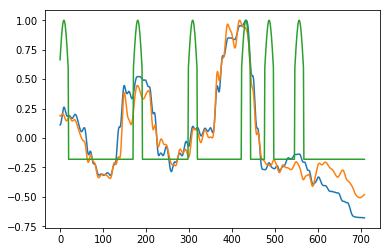

[2,  8281] loss: 0.690


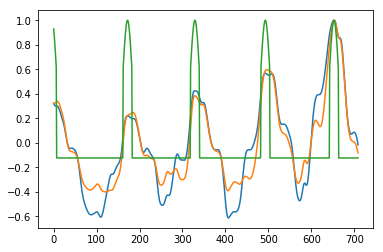

[2,  8311] loss: 0.691


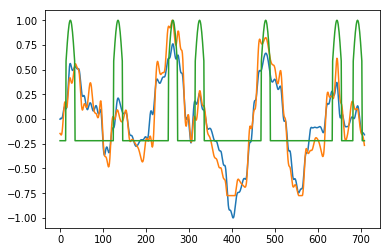

[2,  8341] loss: 0.692


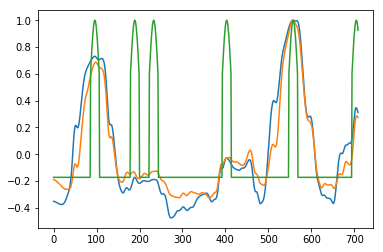

[2,  8371] loss: 0.693


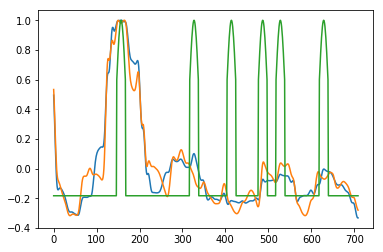

[2,  8401] loss: 0.694


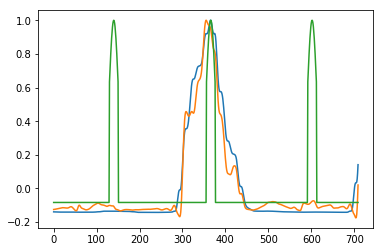

[2,  8431] loss: 0.694


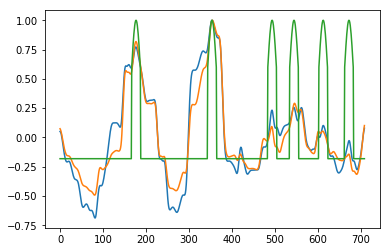

[2,  8461] loss: 0.695


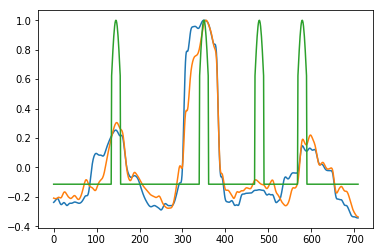

[2,  8491] loss: 0.696


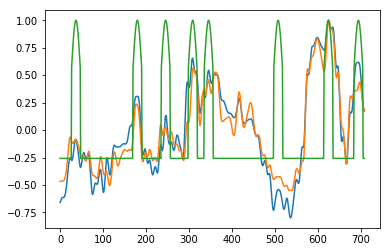

[2,  8521] loss: 0.697


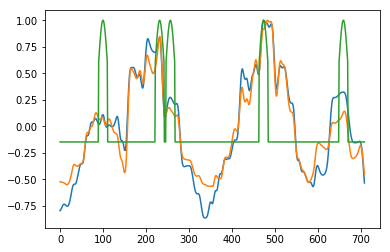

[2,  8551] loss: 0.699


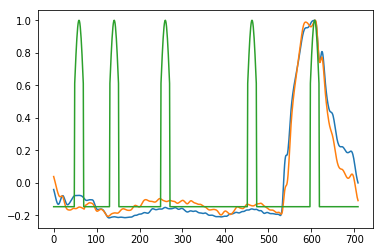

[2,  8581] loss: 0.700


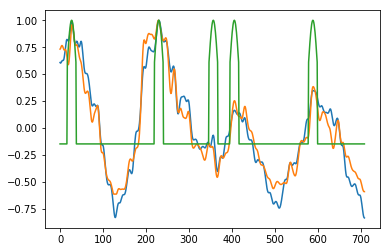

[2,  8611] loss: 0.700


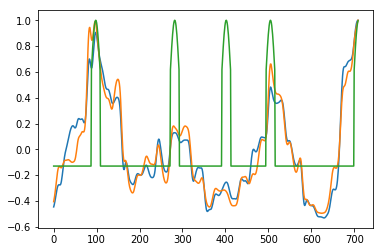

[2,  8641] loss: 0.701


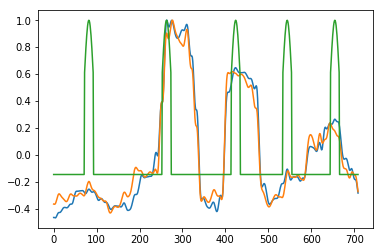

[2,  8671] loss: 0.702


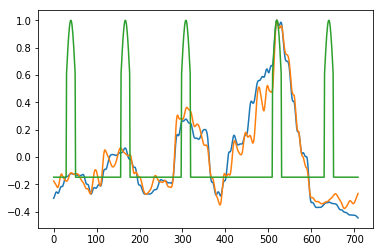

[2,  8701] loss: 0.703


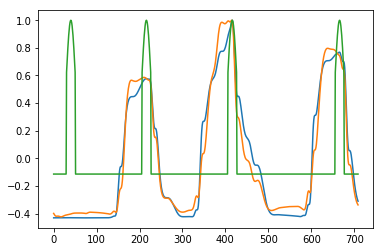

[2,  8731] loss: 0.704


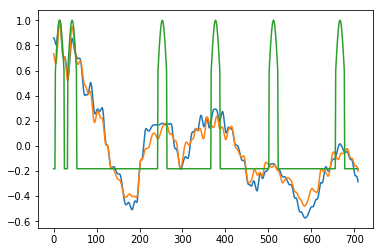

[2,  8761] loss: 0.705


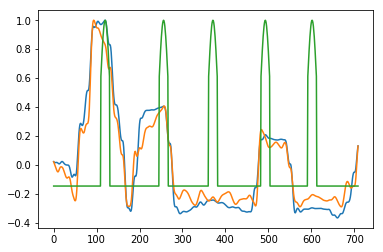

[2,  8791] loss: 0.706


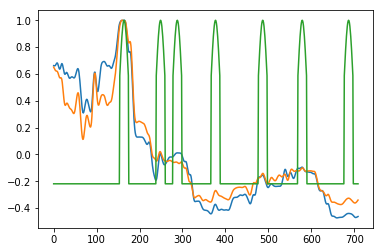

[2,  8821] loss: 0.707


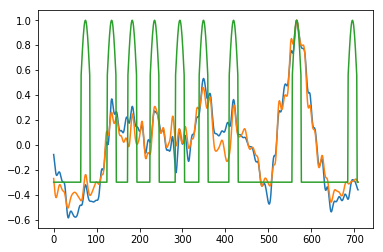

[2,  8851] loss: 0.708


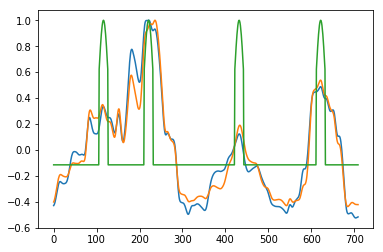

[2,  8881] loss: 0.709


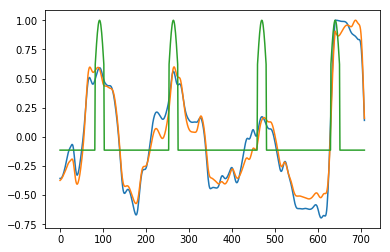

[2,  8911] loss: 0.710


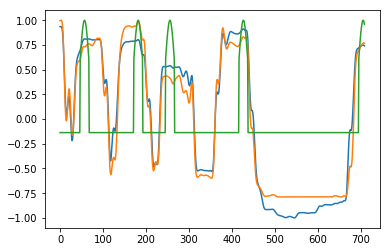

[2,  8941] loss: 0.711


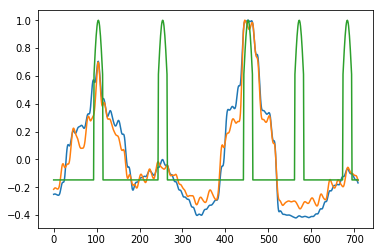

[2,  8971] loss: 0.712


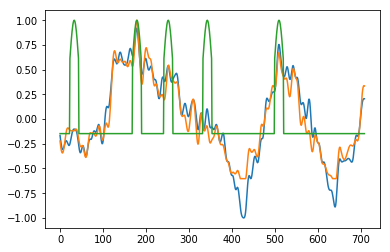

[2,  9001] loss: 0.713


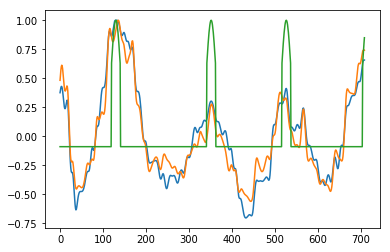

[2,  9031] loss: 0.713


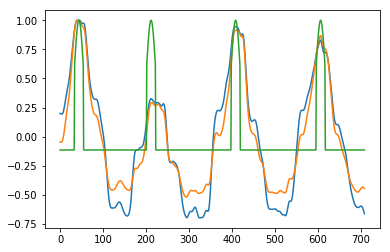

[2,  9061] loss: 0.714


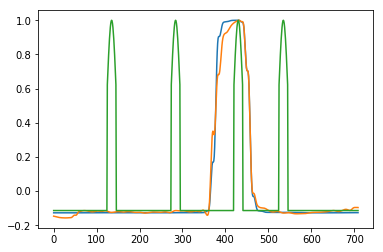

[2,  9091] loss: 0.715


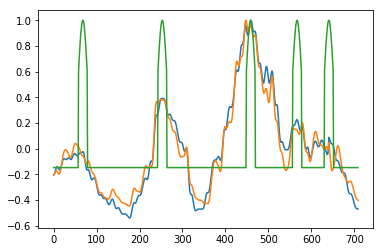

[2,  9121] loss: 0.716


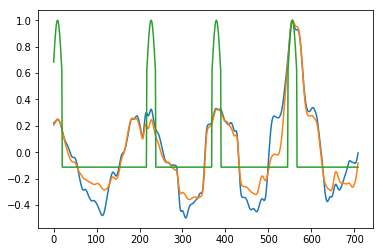

[2,  9151] loss: 0.717


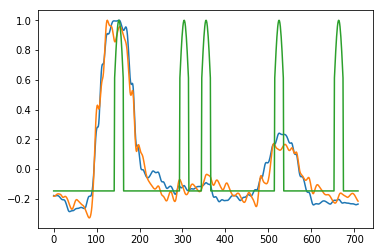

[2,  9181] loss: 0.718


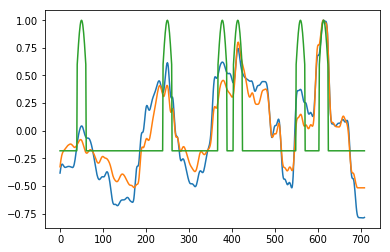

[2,  9211] loss: 0.719


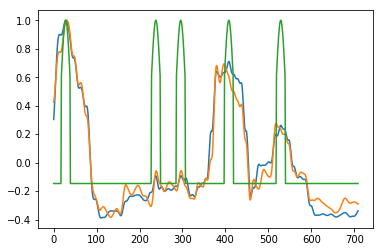

[2,  9241] loss: 0.720


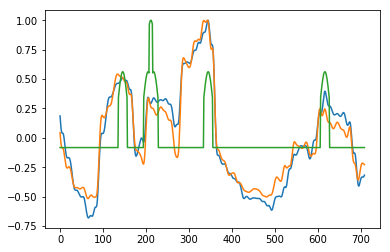

[2,  9271] loss: 0.721


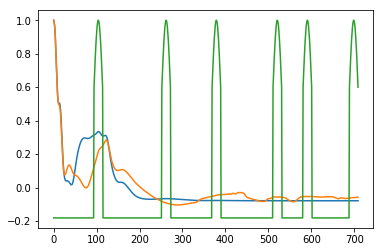

[2,  9301] loss: 0.722


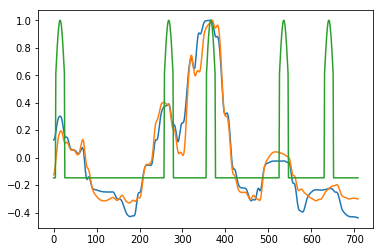

[2,  9331] loss: 0.723


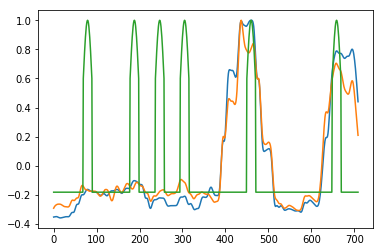

[2,  9361] loss: 0.723


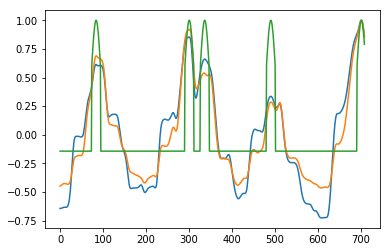

[2,  9391] loss: 0.724


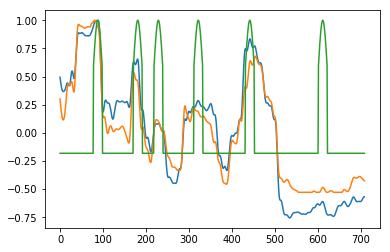

[2,  9421] loss: 0.725


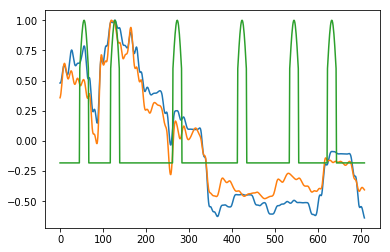

[2,  9451] loss: 0.726


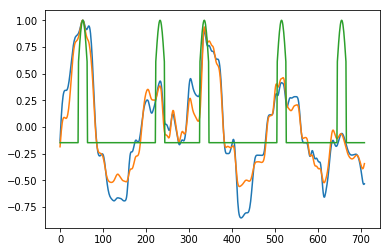

[2,  9481] loss: 0.727


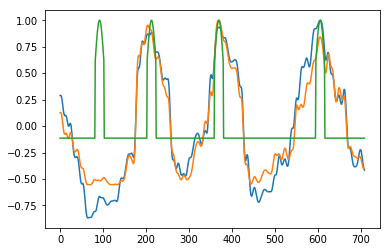

[2,  9511] loss: 0.728


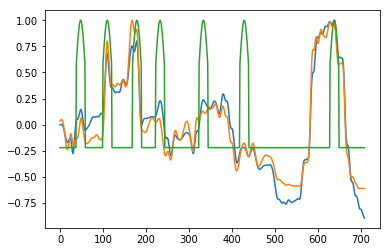

[2,  9541] loss: 0.729


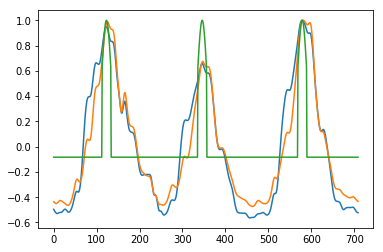

[2,  9571] loss: 0.730


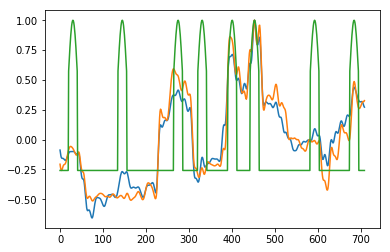

[2,  9601] loss: 0.731


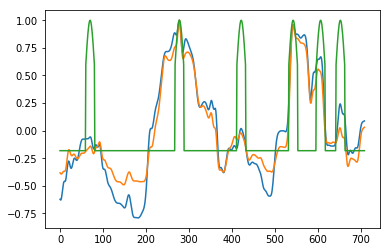

[2,  9631] loss: 0.732


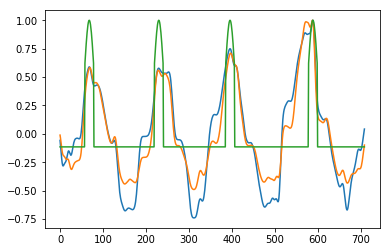

[2,  9661] loss: 0.733


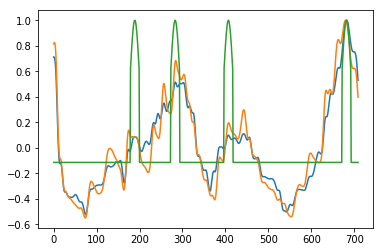

[2,  9691] loss: 0.734


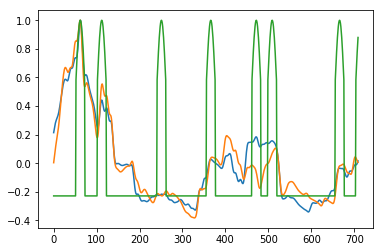

[2,  9721] loss: 0.735


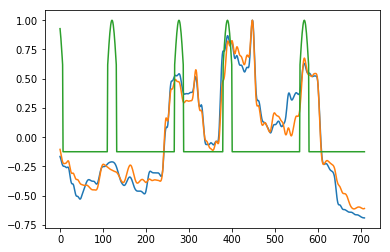

[2,  9751] loss: 0.736


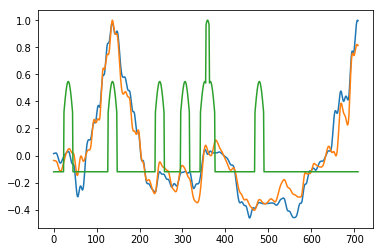

[2,  9781] loss: 0.737


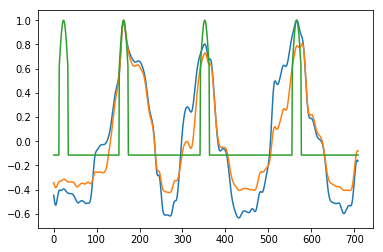

[2,  9811] loss: 0.738


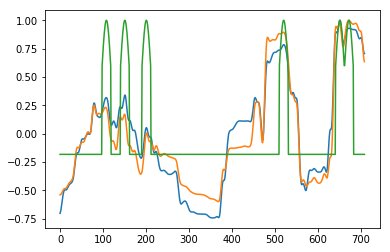

[2,  9841] loss: 0.739


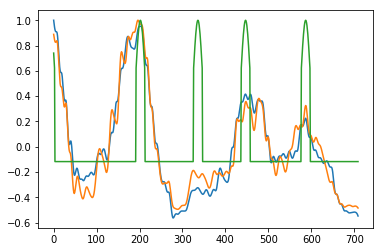

[2,  9871] loss: 0.740


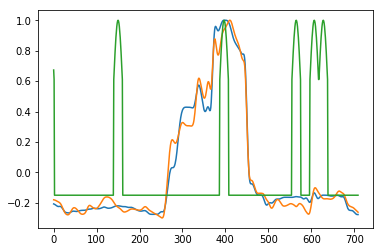

[2,  9901] loss: 0.741


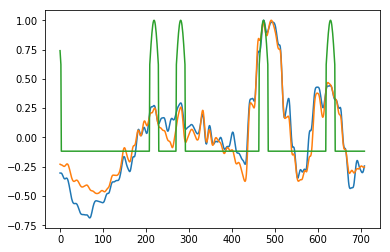

[2,  9931] loss: 0.742


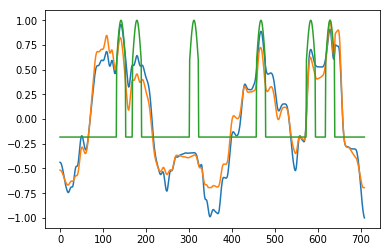

[2,  9961] loss: 0.743


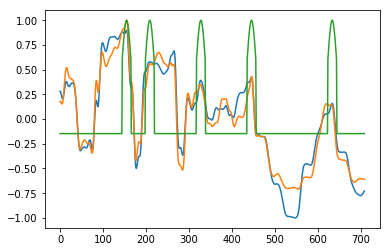

[2,  9991] loss: 0.744


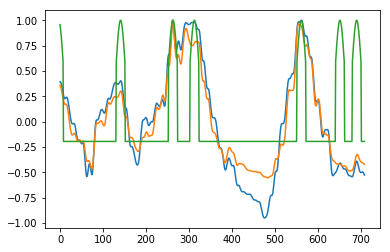

[2, 10021] loss: 0.745


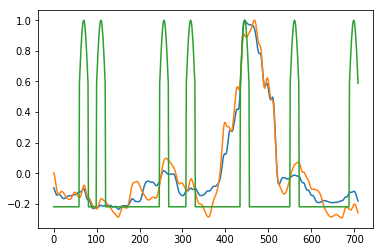

[2, 10051] loss: 0.746


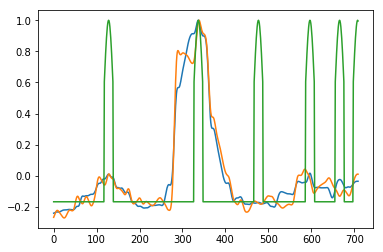

[2, 10081] loss: 0.747


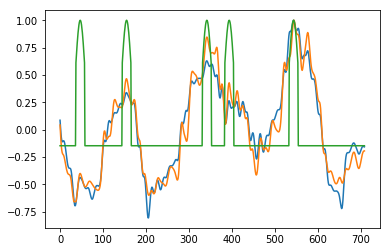

[2, 10111] loss: 0.748


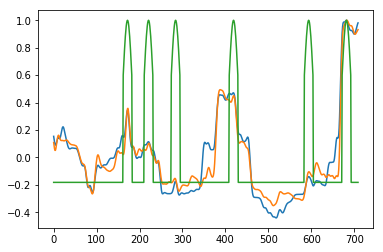

[2, 10141] loss: 0.749


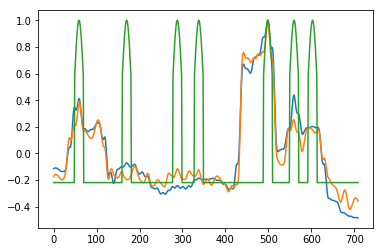

[2, 10171] loss: 0.750


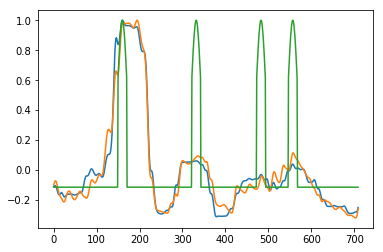

[2, 10201] loss: 0.751


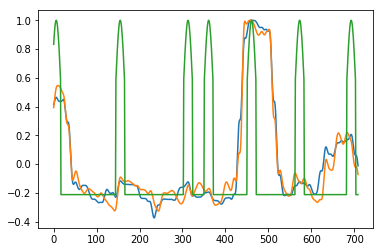

[2, 10231] loss: 0.752


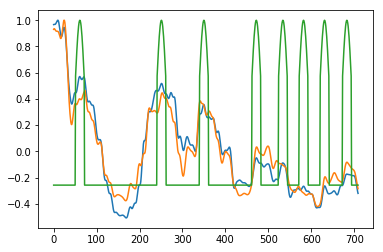

[2, 10261] loss: 0.753


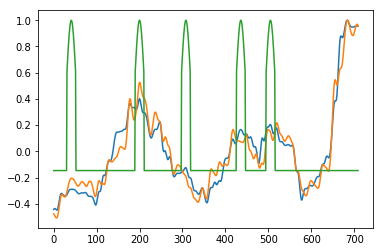

[2, 10291] loss: 0.754


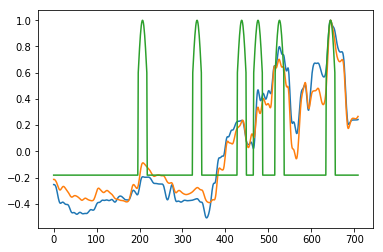

[2, 10321] loss: 0.755


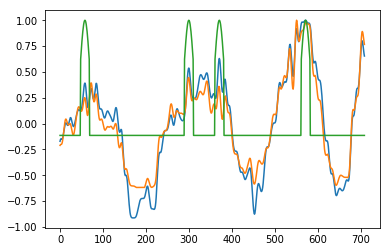

[2, 10351] loss: 0.756


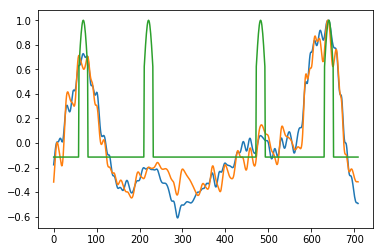

[2, 10381] loss: 0.757


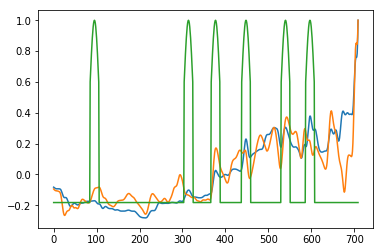

[2, 10411] loss: 0.758


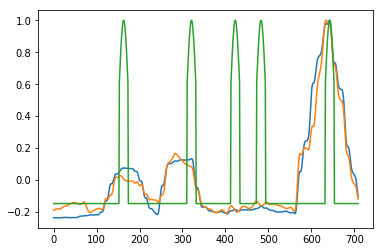

[2, 10441] loss: 0.759


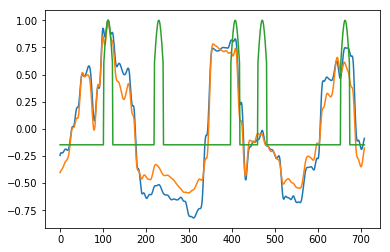

[2, 10471] loss: 0.760


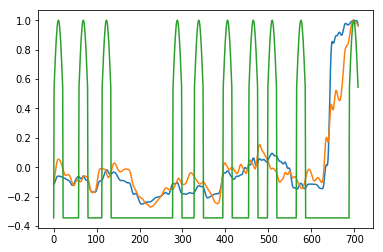

[2, 10501] loss: 0.761


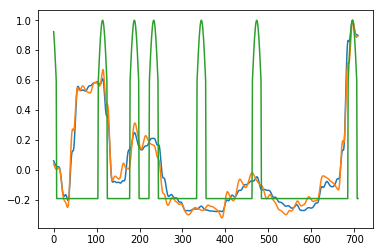

[2, 10531] loss: 0.762


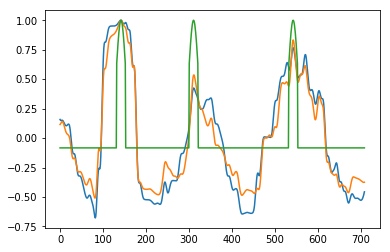

[2, 10561] loss: 0.763


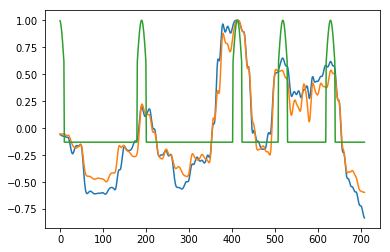

[2, 10591] loss: 0.764


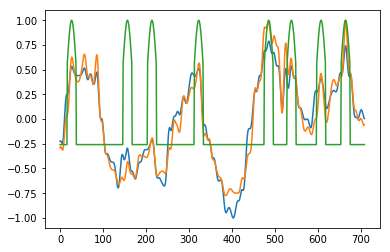

[2, 10621] loss: 0.765


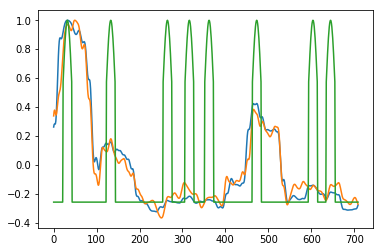

[2, 10651] loss: 0.766


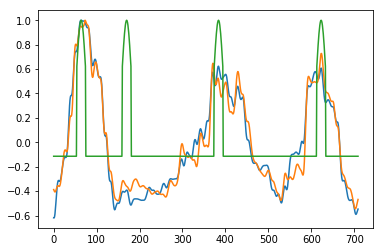

[2, 10681] loss: 0.767


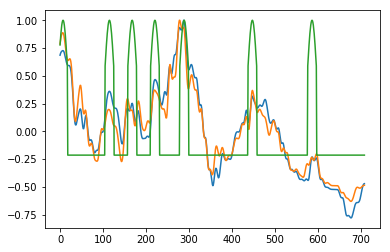

[2, 10711] loss: 0.768


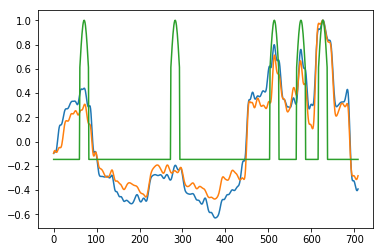

[2, 10741] loss: 0.769


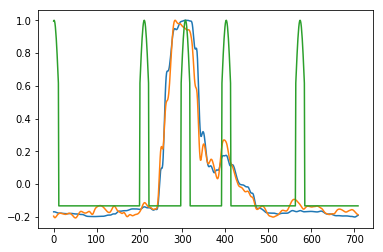

[2, 10771] loss: 0.770


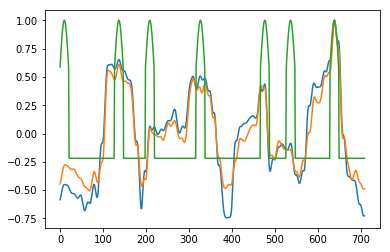

[2, 10801] loss: 0.771


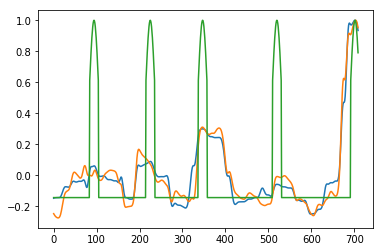

[2, 10831] loss: 0.772


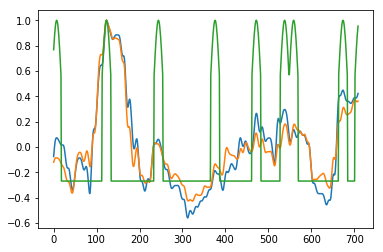

[2, 10861] loss: 0.773


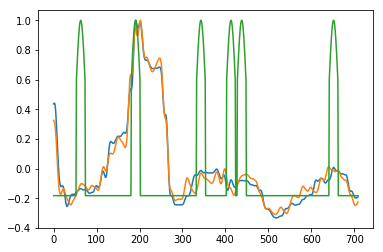

[2, 10891] loss: 0.774


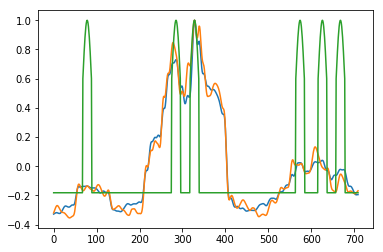

[2, 10921] loss: 0.775


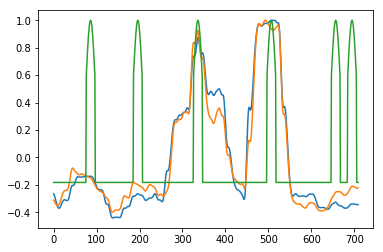

[2, 10951] loss: 0.776


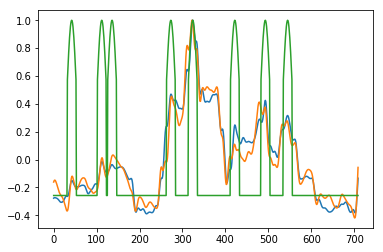

[2, 10981] loss: 0.777


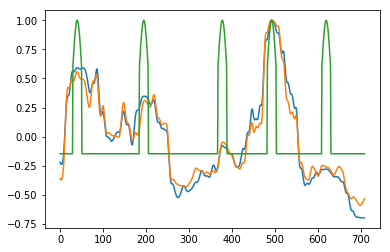

[2, 11011] loss: 0.778


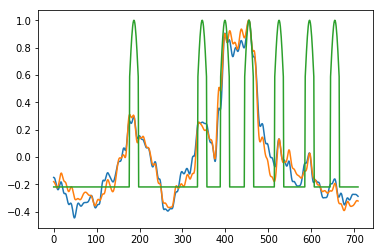

[2, 11041] loss: 0.779


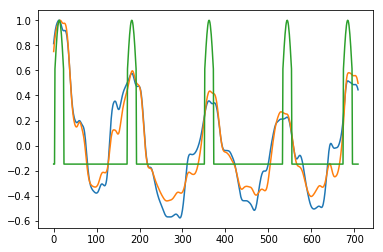

[2, 11071] loss: 0.780


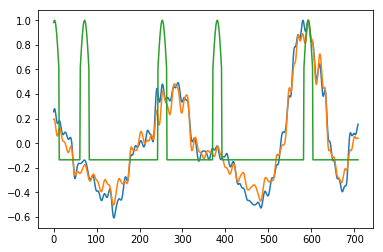

[2, 11101] loss: 0.781


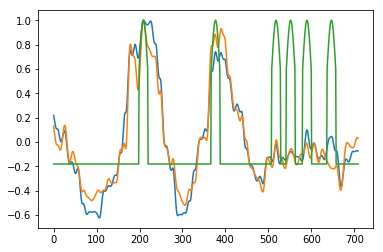

[2, 11131] loss: 0.782


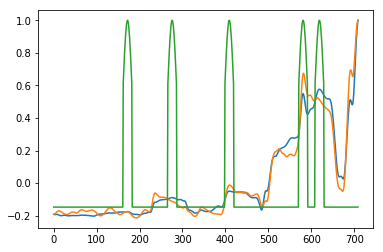

[2, 11161] loss: 0.783


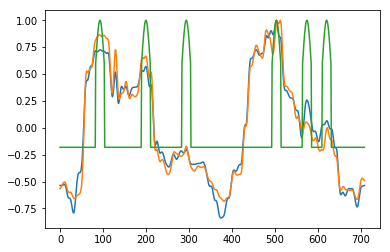

[2, 11191] loss: 0.784


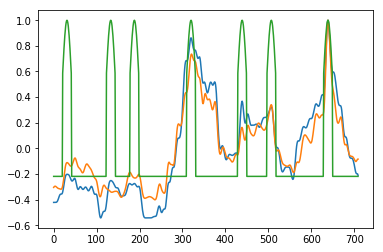

[2, 11221] loss: 0.785


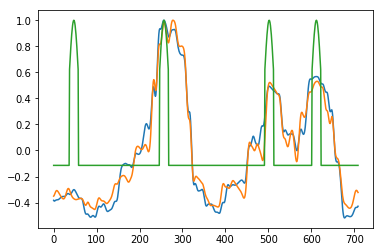

[2, 11251] loss: 0.786


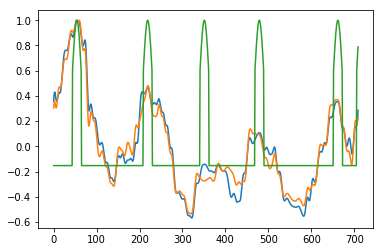

[2, 11281] loss: 0.787


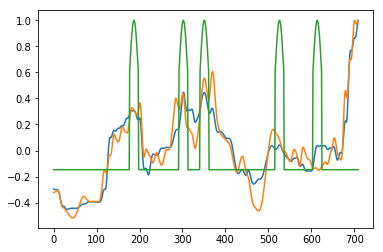

[2, 11311] loss: 0.788


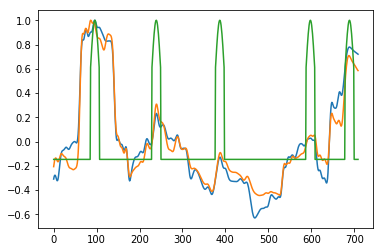

[2, 11341] loss: 0.789


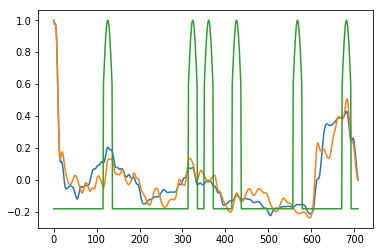

[2, 11371] loss: 0.790


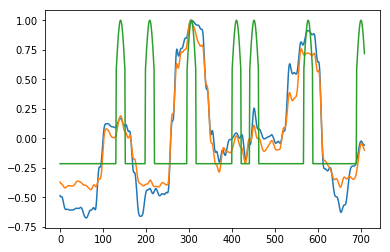

[2, 11401] loss: 0.791


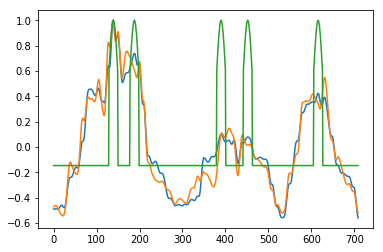

[2, 11431] loss: 0.792


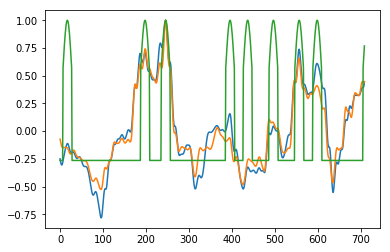

[2, 11461] loss: 0.793


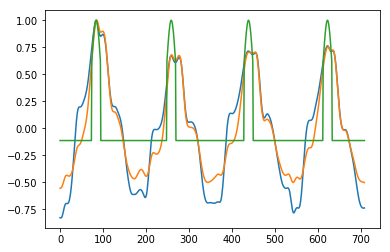

[2, 11491] loss: 0.794


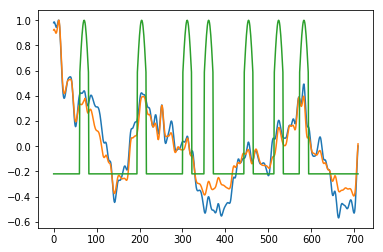

[2, 11521] loss: 0.795


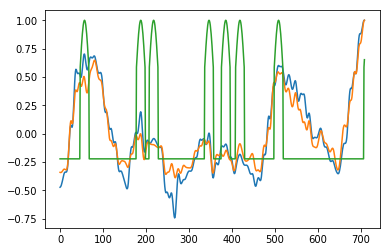

[2, 11551] loss: 0.795


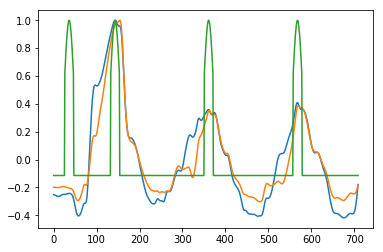

[2, 11581] loss: 0.796


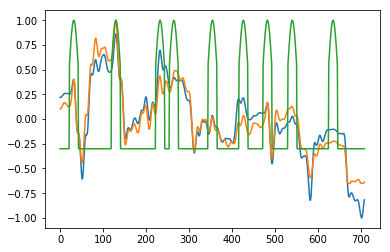

[2, 11611] loss: 0.797


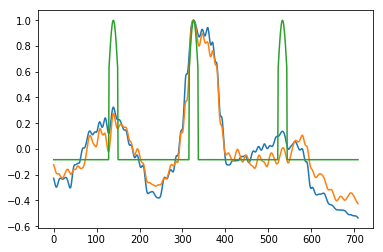

[2, 11641] loss: 0.798


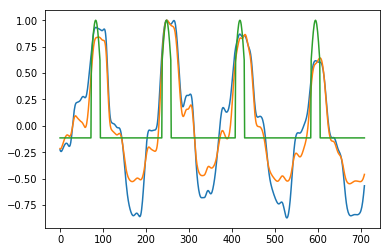

[2, 11671] loss: 0.799


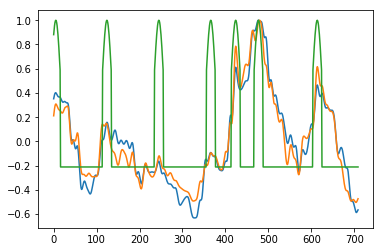

[2, 11701] loss: 0.800


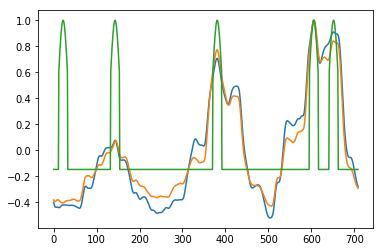

[2, 11731] loss: 0.800


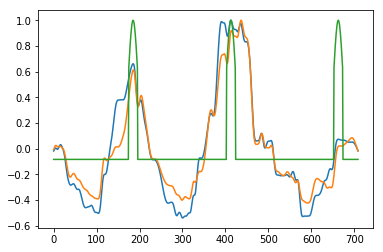

[2, 11761] loss: 0.801


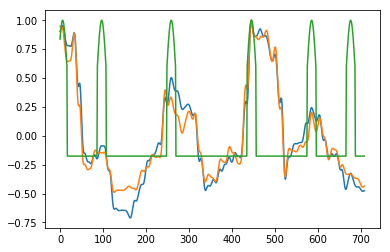

[2, 11791] loss: 0.803


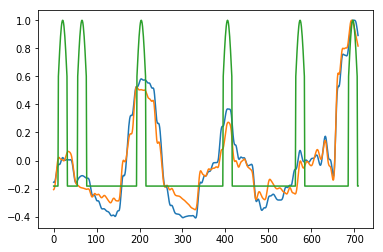

[2, 11821] loss: 0.804


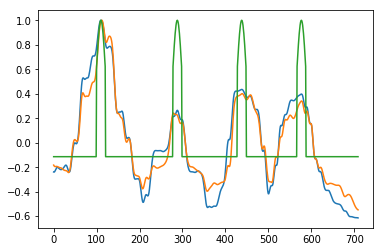

[2, 11851] loss: 0.805


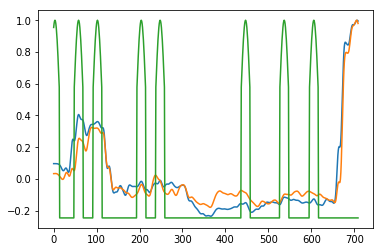

[2, 11881] loss: 0.806


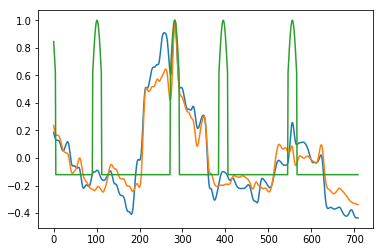

[2, 11911] loss: 0.807


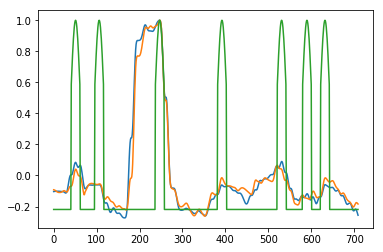

[2, 11941] loss: 0.808


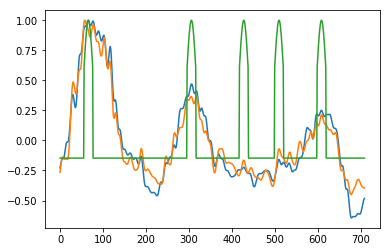

[2, 11971] loss: 0.808


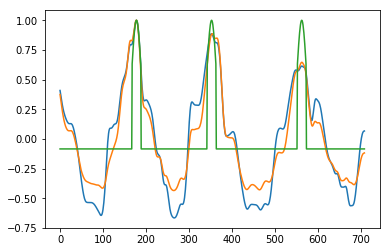

[2, 12001] loss: 0.809


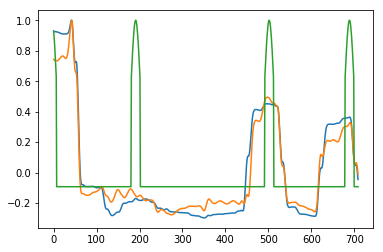

[2, 12031] loss: 0.810


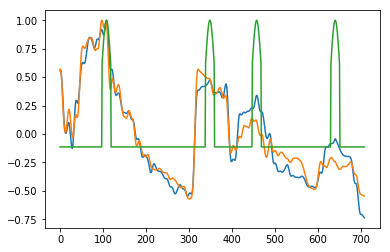

[2, 12061] loss: 0.811


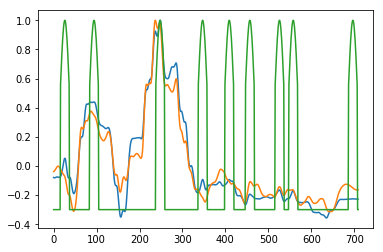

[2, 12091] loss: 0.812


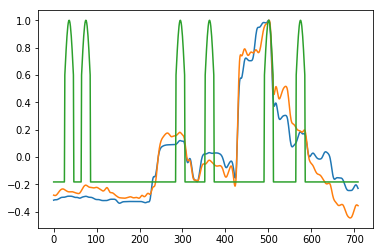

[2, 12121] loss: 0.813


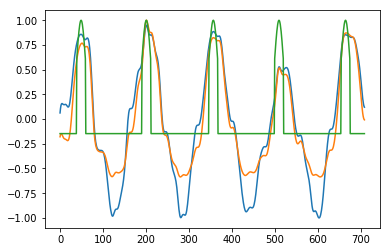

[2, 12151] loss: 0.814


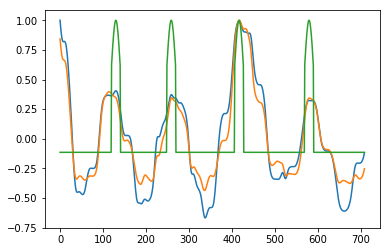

[2, 12181] loss: 0.815


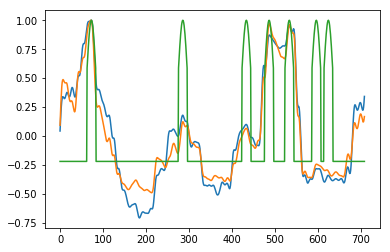

[2, 12211] loss: 0.817


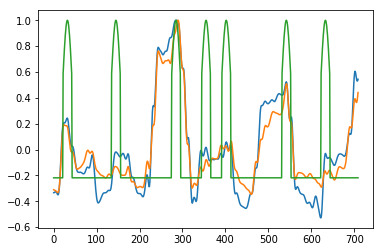

[2, 12241] loss: 0.818


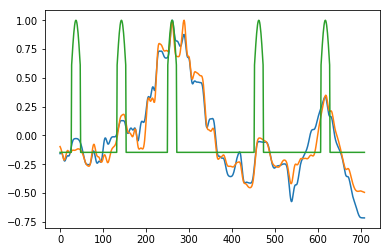

[2, 12271] loss: 0.819


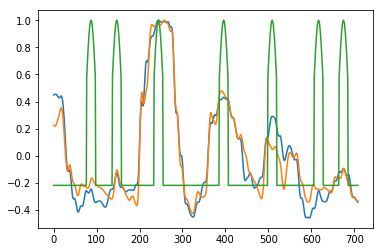

[2, 12301] loss: 0.820


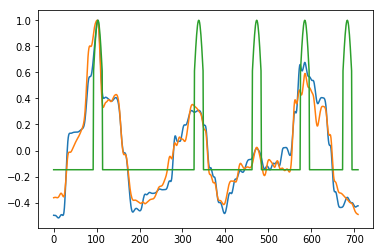

[2, 12331] loss: 0.821


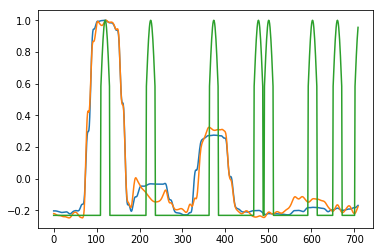

[2, 12361] loss: 0.822


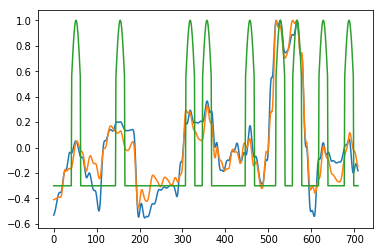

[2, 12391] loss: 0.822


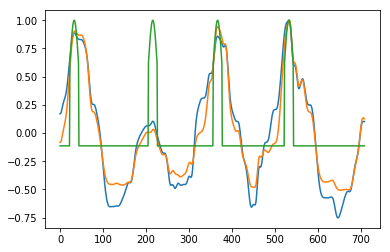

[2, 12421] loss: 0.823


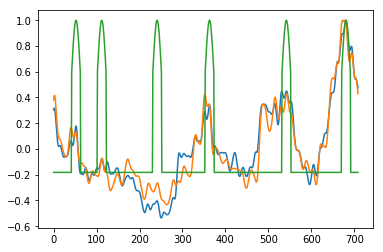

[2, 12451] loss: 0.824


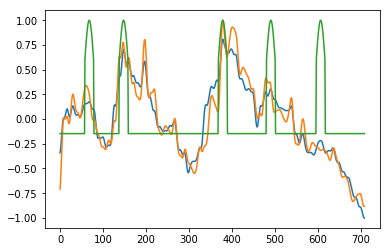

[2, 12481] loss: 0.825


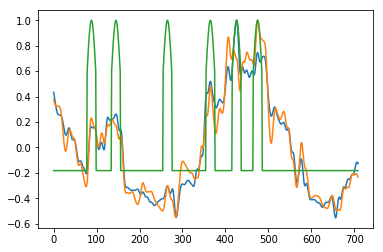

[2, 12511] loss: 0.826


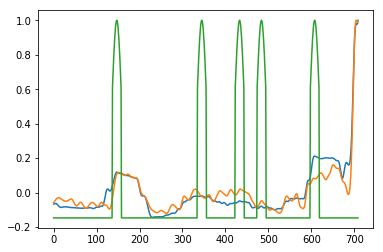

[2, 12541] loss: 0.827


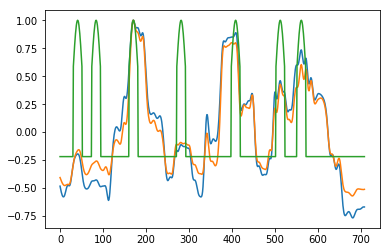

[2, 12571] loss: 0.828


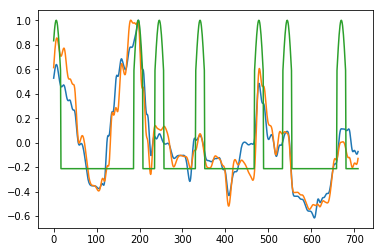

[2, 12601] loss: 0.829


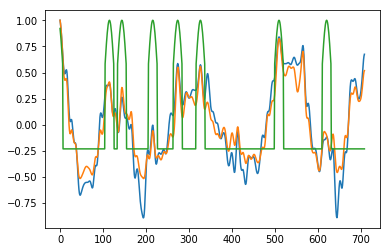

[2, 12631] loss: 0.830


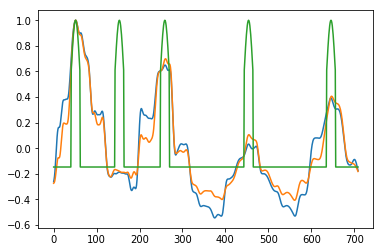

[2, 12661] loss: 0.831


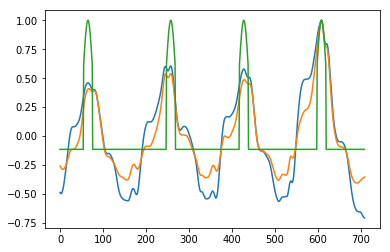

[2, 12691] loss: 0.832


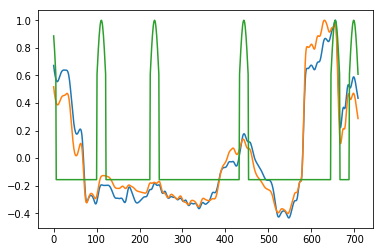

[2, 12721] loss: 0.833


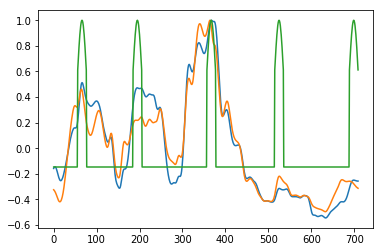

[2, 12751] loss: 0.834


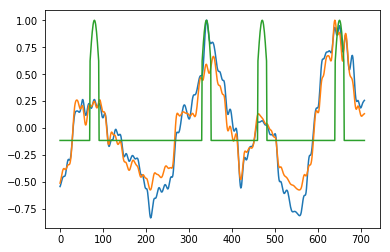

[2, 12781] loss: 0.835


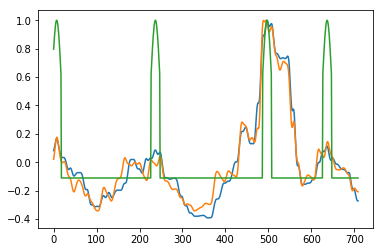

[2, 12811] loss: 0.836


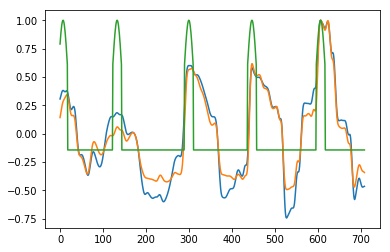

[2, 12841] loss: 0.837


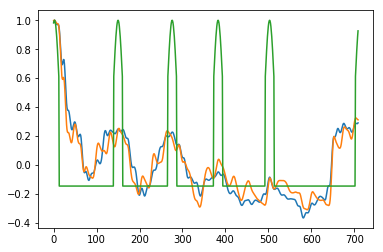

[2, 12871] loss: 0.838


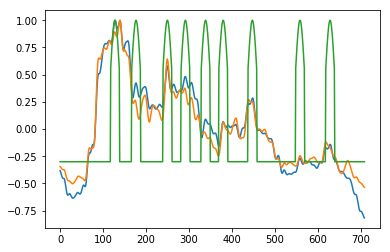

[2, 12901] loss: 0.839


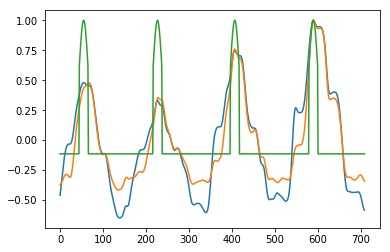

[2, 12931] loss: 0.840


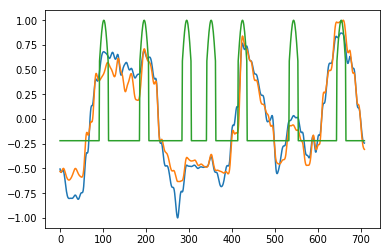

[2, 12961] loss: 0.840


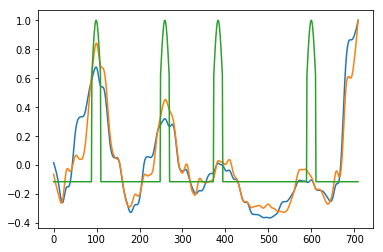

[2, 12991] loss: 0.841


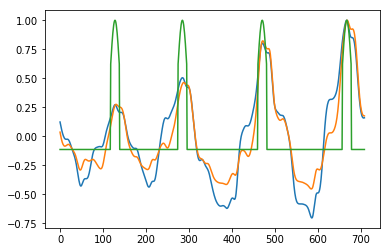

[2, 13021] loss: 0.842


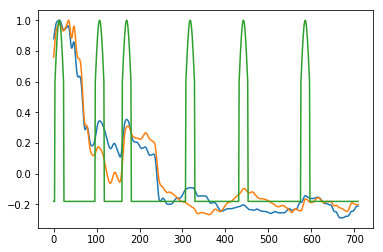

[2, 13051] loss: 0.843


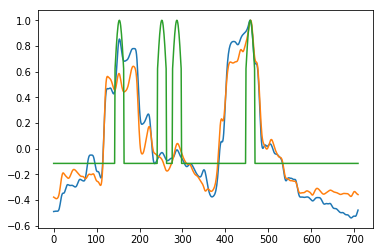

[2, 13081] loss: 0.844


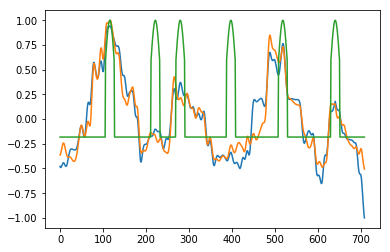

[2, 13111] loss: 0.845


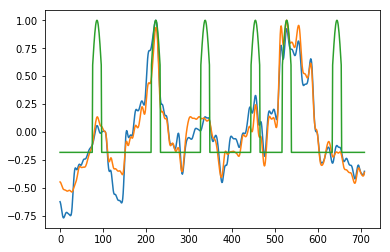

[2, 13141] loss: 0.846


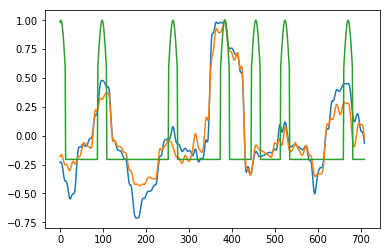

[2, 13171] loss: 0.847


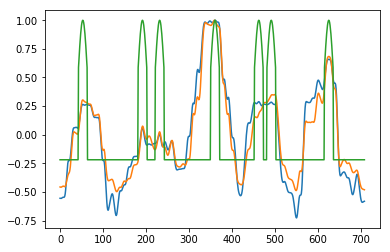

[2, 13201] loss: 0.848


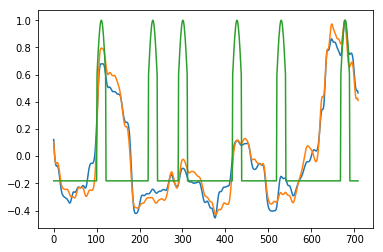

[2, 13231] loss: 0.849


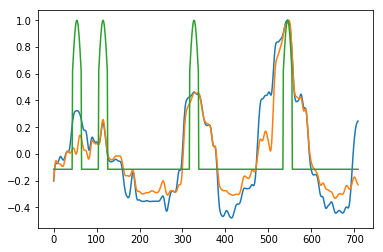

[2, 13261] loss: 0.850


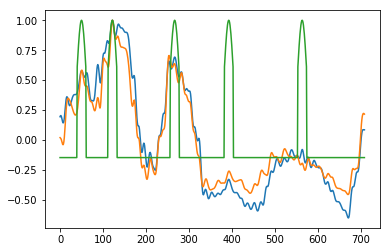

[2, 13291] loss: 0.851


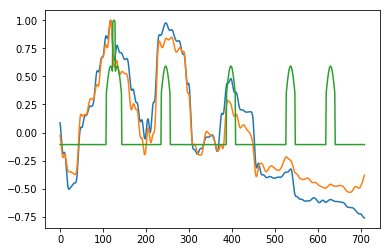

[2, 13321] loss: 0.852


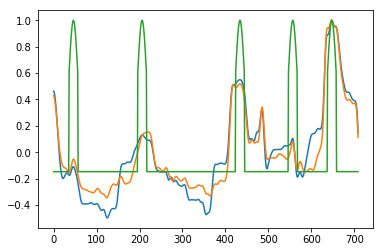

[2, 13351] loss: 0.853


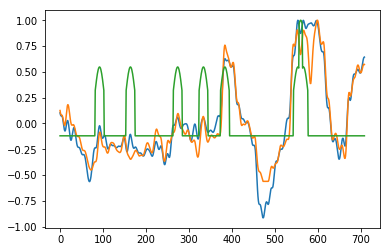

[2, 13381] loss: 0.854


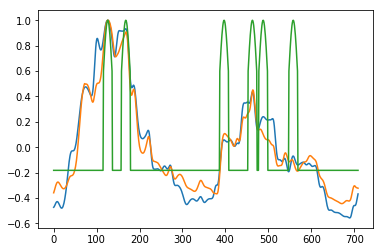

[2, 13411] loss: 0.855


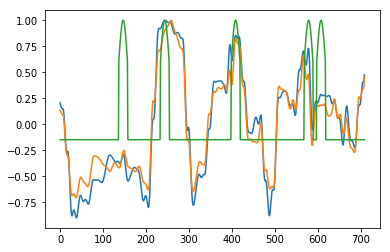

(447,)


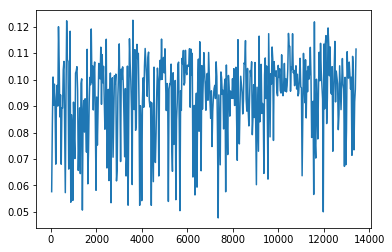

In [3]:
dataset = read_dataset("dataset_contact.csv")
print("DATASET LOADED")
data = np.asarray([])
labels = np.asarray([])


epoch = 1
running_loss = 0.0
# hidden = None
i = 0

for epoch in range(2):
    i = 0
    losses = []
    steps = []
    while i < dataset.shape[0]-batch_size*3:

        input_batch = []
        output_batch = []
        for j in range(batch_size):
            input1 = dataset.iloc[i]
            input2 = dataset.iloc[i+1]
            labels = dataset.iloc[i+2]
            labels1, input1, input2 = build_labels(input1, input2, labels)

            input_batch.append([input1, input2])
            output_batch.append(labels1)
            i += 3
        
        
        inputs = torch.from_numpy(np.asarray(input_batch)).float()
        labels = torch.from_numpy(np.asarray(output_batch)).float()

        res1, hidden1, hidden2, hidden3 = rnn.forward(inputs, hidden1, hidden2, hidden3)
        to_plot = normalize_signal(res1.detach().numpy()[0][0])
        to_plot2 = normalize_signal(input1)
        # print(to_plot)
        # plt.plot(range(len(to_plot2)), to_plot2)
        # plt.plot(range(len(to_plot)), to_plot)
        # plt.plot(range(len(labels1)), labels1)
        # plt.legend()
        # plt.show()

        res = res1.squeeze()
        optimizer.zero_grad()

        # labels1 = 8*labels
        loss = criterion(res, labels)
        loss.backward(retain_graph=True)
        optimizer.step()

        running_loss += loss.item()
        losses.append(loss.item())
        steps.append(i)
        if i % 1 == 0:    # print every 2000 mini-batches
            print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss / 100))
                # running_loss = 0.0
            # plt.plot(range(len(to_plot2)), to_plot2)
            # plt.plot(range(len(to_plot)), to_plot)
            # plt.plot(range(len(to_plot2)), to_plot2)
            # plt.plot(range(len(labels1)), labels1)
            # plt.legend()
            # plt.show()
            res = rnn(inputs, hidden1, hidden2, hidden3)
            inputs1 = normalize_signal(inputs[3][1].data.numpy())
            res1 = normalize_signal(res[0][3][0].data.numpy())
            lab1 = normalize_signal(labels[3].data.numpy())
            plt.plot(inputs1)
            plt.plot(res1)
            plt.plot(lab1)
            # plt.legend()
            plt.show()
        # i += 3
    plt.plot(steps, losses)
    print(np.shape(steps))
    plt.show()


No handles with labels found to put in legend.


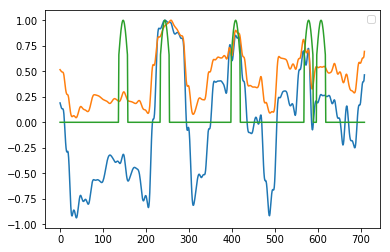

In [4]:
res = rnn(inputs, hidden1, hidden2, hidden3)
inputs1 = inputs[3][1].data.numpy() / np.max(inputs[3][1].data.numpy())
res1 = res[0][3][0].data.numpy() / np.max(res[0][3][0].data.numpy())
lab1 = labels[3].data.numpy() / np.max(labels[3].data.numpy())
plt.plot(inputs1)
plt.plot(res1)
plt.plot(lab1)
plt.legend()
plt.show()